# Familiarization Task

&emsp;Load and understand data<br/>
&emsp;&emsp;What kinds of signals are there?<br/>
&emsp;&emsp;Are the signals correlated? Do they show cyclic behavior<br/>
&emsp;&emsp;Is predicting the next value in a series easy or hard? Use any method from class<br/>
&emsp;&emsp;Visualize correlation and the performance of prediction<br/>

## 1.First step is to visualize data

### Meaning of columns in dataframe<br/>
&emsp;T: water tanks<br/>
&emsp;&emsp;L_T: water level in tanks<br/>
&emsp;PU: pumps<br/>
&emsp;&emsp;F_PU: amount of water flows through pipe<br/>
&emsp;&emsp;S_PU: whether the pipe is on(1) or off(0)<br/>
&emsp;V: valves<br/>
&emsp;&emsp;F_V: amount of water flows through valve<br/>
&emsp;&emsp;S_V: whether the valve is on(1) or off(0)<br/>
&emsp;J: junctions<br/>
&emsp;&emsp;P_J: pressure of junction<br/>
&emsp;ATT_FLAG: label indicating attacks<br/>

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

Perform convertions and inspect the shape of data

In [2]:
trainingData_1=pd.read_csv('BATADAL_dataset03.csv',skipinitialspace=True)
#convert date time to pandas can read
trainingData_1['DATETIME']=pd.to_datetime(trainingData_1['DATETIME'])
print(f'columns of data1: {trainingData_1.columns}')
#inspect the shape of Data
print(f'Data Frame 1 shape: {trainingData_1.shape}')
length_Data1=len(trainingData_1)
print(f"Data Frame 1 length: {((trainingData_1['DATETIME'][length_Data1-1]-trainingData_1['DATETIME'][0]).total_seconds()/(3600*24))} days")
trainingData_1.describe()

columns of data1: Index(['DATETIME', 'L_T1', 'L_T2', 'L_T3', 'L_T4', 'L_T5', 'L_T6', 'L_T7',
       'F_PU1', 'S_PU1', 'F_PU2', 'S_PU2', 'F_PU3', 'S_PU3', 'F_PU4', 'S_PU4',
       'F_PU5', 'S_PU5', 'F_PU6', 'S_PU6', 'F_PU7', 'S_PU7', 'F_PU8', 'S_PU8',
       'F_PU9', 'S_PU9', 'F_PU10', 'S_PU10', 'F_PU11', 'S_PU11', 'F_V2',
       'S_V2', 'P_J280', 'P_J269', 'P_J300', 'P_J256', 'P_J289', 'P_J415',
       'P_J302', 'P_J306', 'P_J307', 'P_J317', 'P_J14', 'P_J422', 'ATT_FLAG'],
      dtype='object')
Data Frame 1 shape: (8761, 45)
Data Frame 1 length: 365.0 days


,L_T1,L_T2,L_T3,L_T4,L_T5,L_T6,L_T7,F_PU1,S_PU1,F_PU2,...,P_J256,P_J289,P_J415,P_J302,P_J306,P_J307,P_J317,P_J14,P_J422,ATT_FLAG
count,8761.000000,8761.000000,8761.000000,8761.000000,8761.000000,8761.000000,8761.000000,8761.000000,8761.0,8761.000000,...,8761.000000,8761.000000,8761.000000,8761.000000,8761.000000,8761.000000,8761.000000,8761.000000,8761.000000,8761.0
mean,2.676905,3.285748,4.201820,3.568129,2.748205,5.370437,3.302672,100.926032,1.0,69.464357,...,79.411082,27.776600,82.737615,24.453808,74.459039,24.362250,67.921632,33.755911,29.453266,0.0
std,1.202940,1.468621,0.678465,0.539656,0.735162,0.177459,0.828849,10.048618,0.0,42.239742,...,8.461924,2.720291,7.502937,4.416089,9.974357,4.438203,5.321227,4.232716,2.658146,0.0
min,0.320112,0.293876,2.882847,2.002133,1.293241,4.824605,1.054194,85.495201,1.0,0.000000,...,65.059624,20.690191,54.757198,14.797167,58.325397,14.541955,51.697071,27.649677,22.370066,0.0
25%,1.650647,2.131776,3.623394,3.139640,2.123508,5.248147,2.631062,94.342598,1.0,0.000000,...,71.978676,26.674088,83.912292,20.516289,62.949253,20.409576,66.718307,30.668709,28.432796,0.0
50%,2.798855,3.498371,4.240439,3.574840,2.758198,5.500000,3.252838,96.729073,1.0,94.075195,...,75.879807,28.110842,85.219460,22.969397,81.176102,22.856150,68.807007,32.222023,29.834288,0.0
75%,3.754744,4.570782,4.793697,4.009889,3.372392,5.500000,3.986883,112.294952,1.0,96.614708,...,88.221329,29.553995,86.416519,28.457081,82.673698,28.382421,71.218712,38.134647,31.275637,0.0
max,4.871329,5.663802,5.433022,4.690665,4.162726,5.500000,4.999618,122.705627,1.0,100.140671,...,94.961258,33.763836,105.951820,36.325947,89.053986,36.325947,96.180450,45.388145,35.161724,0.0


In [3]:
#inspect dataset2
trainingData_2=pd.read_csv('BATADAL_dataset04.csv',skipinitialspace=True)
trainingData_2['DATETIME']=pd.to_datetime(trainingData_2['DATETIME'])
print(f'columns of data2: {trainingData_2.columns}')
print(f'Data Frame 2 shape: {trainingData_2.shape}')
length_Data2=len(trainingData_2)
print(f"Data Frame 2 length: {(trainingData_2['DATETIME'][length_Data2-1]-trainingData_2['DATETIME'][0]).total_seconds()/(3600*24)} days")
trainingData_2.describe()

columns of data2: Index(['DATETIME', 'L_T1', 'L_T2', 'L_T3', 'L_T4', 'L_T5', 'L_T6', 'L_T7',
       'F_PU1', 'S_PU1', 'F_PU2', 'S_PU2', 'F_PU3', 'S_PU3', 'F_PU4', 'S_PU4',
       'F_PU5', 'S_PU5', 'F_PU6', 'S_PU6', 'F_PU7', 'S_PU7', 'F_PU8', 'S_PU8',
       'F_PU9', 'S_PU9', 'F_PU10', 'S_PU10', 'F_PU11', 'S_PU11', 'F_V2',
       'S_V2', 'P_J280', 'P_J269', 'P_J300', 'P_J256', 'P_J289', 'P_J415',
       'P_J302', 'P_J306', 'P_J307', 'P_J317', 'P_J14', 'P_J422', 'ATT_FLAG'],
      dtype='object')
Data Frame 2 shape: (4177, 45)
Data Frame 2 length: 262.0 days


,L_T1,L_T2,L_T3,L_T4,L_T5,L_T6,L_T7,F_PU1,S_PU1,F_PU2,...,P_J256,P_J289,P_J415,P_J302,P_J306,P_J307,P_J317,P_J14,P_J422,ATT_FLAG
count,4177.000000,4177.000000,4177.000000,4177.000000,4177.000000,4177.000000,4177.000000,4177.000000,4177.0,4177.000000,...,4177.000000,4177.000000,4177.000000,4177.000000,4177.000000,4177.000000,4177.000000,4177.000000,4177.000000,4177.000000
mean,2.707446,3.287965,4.204496,3.556232,2.748377,5.368429,3.323352,100.839069,1.0,69.385904,...,79.404214,27.772894,82.665293,24.574898,74.463383,24.482049,68.024829,33.906174,29.447544,-946.570026
std,1.209627,1.470462,0.681352,0.544905,0.735800,0.177560,0.838134,10.217831,0.0,42.180931,...,8.475271,2.740362,7.577549,4.712136,10.020099,4.734871,5.631171,4.599987,2.679226,222.919197
min,0.320000,0.310000,2.880000,1.920000,1.280000,4.770000,0.430000,38.920000,1.0,0.000000,...,66.060000,19.460000,53.940000,13.910000,58.070000,13.640000,51.410000,27.820000,21.320000,-999.000000
25%,1.650000,2.150000,3.620000,3.130000,2.130000,5.240000,2.660000,94.170000,1.0,0.000000,...,71.960000,26.670000,83.860000,20.510000,62.930000,20.400000,66.680000,30.690000,28.430000,-999.000000
50%,2.820000,3.490000,4.230000,3.550000,2.750000,5.500000,3.280000,96.650000,1.0,93.860000,...,75.810000,28.140000,85.190000,23.160000,81.170000,23.050000,68.890000,32.250000,29.830000,-999.000000
75%,3.780000,4.580000,4.800000,4.000000,3.370000,5.500000,4.040000,112.140000,1.0,96.510000,...,88.170000,29.570000,86.380000,28.580000,82.650000,28.490000,71.360000,38.230000,31.290000,-999.000000
max,5.730000,5.670000,5.430000,4.700000,4.160000,5.500000,5.000000,122.570000,1.0,99.920000,...,94.870000,34.260000,107.950000,71.110000,95.270000,71.110000,93.730000,77.410000,35.680000,1.000000


In [4]:
#inspect test data
testData=pd.read_csv('BATADAL_test_dataset.csv',skipinitialspace=True)
testData['DATETIME']=pd.to_datetime(testData['DATETIME'])
print(f'columns of data2: {testData.columns}')
print(f'Data Frame test shape: {testData.shape}')
length_Test=len(testData)
print(f"Data Frame test length: {(testData['DATETIME'][length_Test-1]-testData['DATETIME'][0]).total_seconds()/(3600*24)} days")
testData.describe()

columns of data2: Index(['DATETIME', 'L_T1', 'L_T2', 'L_T3', 'L_T4', 'L_T5', 'L_T6', 'L_T7',
       'F_PU1', 'S_PU1', 'F_PU2', 'S_PU2', 'F_PU3', 'S_PU3', 'F_PU4', 'S_PU4',
       'F_PU5', 'S_PU5', 'F_PU6', 'S_PU6', 'F_PU7', 'S_PU7', 'F_PU8', 'S_PU8',
       'F_PU9', 'S_PU9', 'F_PU10', 'S_PU10', 'F_PU11', 'S_PU11', 'F_V2',
       'S_V2', 'P_J280', 'P_J269', 'P_J300', 'P_J256', 'P_J289', 'P_J415',
       'P_J302', 'P_J306', 'P_J307', 'P_J317', 'P_J14', 'P_J422'],
      dtype='object')
Data Frame test shape: (2089, 44)
Data Frame test length: -87.0 days


,L_T1,L_T2,L_T3,L_T4,L_T5,L_T6,L_T7,F_PU1,S_PU1,F_PU2,...,P_J300,P_J256,P_J289,P_J415,P_J302,P_J306,P_J307,P_J317,P_J14,P_J422
count,2089.000000,2089.000000,2089.000000,2089.000000,2089.000000,2089.000000,2089.000000,2089.000000,2089.000000,2089.000000,...,2089.000000,2089.000000,2089.000000,2089.000000,2089.000000,2089.000000,2089.000000,2089.000000,2089.000000,2089.000000
mean,2.779449,3.353676,4.198928,3.570369,2.753021,5.374840,3.294955,100.263605,0.995213,67.099746,...,27.982824,79.414744,27.993375,82.866194,24.545041,74.377578,24.465232,67.866089,33.712207,29.640838
std,1.211617,1.441290,0.677163,0.543436,0.736856,0.172273,0.818310,12.207435,0.069039,43.313361,...,2.898099,8.685565,2.878047,7.679057,4.477267,9.993108,4.464687,5.342564,4.126415,2.685110
min,0.520000,0.310000,2.880000,2.020000,1.330000,4.820000,1.240000,0.000000,0.000000,0.000000,...,19.020000,65.350000,19.040000,56.200000,13.380000,58.700000,16.770000,50.970000,27.840000,20.900000
25%,1.770000,2.250000,3.610000,3.140000,2.130000,5.260000,2.610000,94.090000,1.000000,0.000000,...,26.830000,71.870000,26.850000,84.020000,20.720000,62.940000,20.630000,66.630000,30.790000,28.630000
50%,2.940000,3.590000,4.230000,3.580000,2.760000,5.500000,3.200000,96.520000,1.000000,93.720000,...,28.270000,75.790000,28.270000,85.220000,23.110000,81.140000,22.910000,68.780000,32.210000,30.010000
75%,3.830000,4.570000,4.800000,4.010000,3.390000,5.500000,3.990000,111.990000,1.000000,96.370000,...,29.710000,88.310000,29.720000,86.480000,28.470000,82.650000,28.380000,71.290000,37.610000,31.360000
max,6.340000,5.710000,5.430000,4.660000,4.150000,5.500000,4.980000,122.440000,1.000000,99.970000,...,43.130000,106.220000,43.130000,122.930000,37.030000,88.270000,37.030000,81.370000,46.320000,41.420000


## 2.show time series plot and correlation matrix
&emsp;Before doing that, all columns of data need to be preprocessed.<br/>
&emsp;&emsp;Normalization is used so as to compare different signals.<br/>
&emsp;&emsp;Non-attack in column 'ATT_FLAG' of trainingData_2 is mapped to 0

In [5]:
#normalize dataset 1
location=[]
normalized_1=trainingData_1.copy()
col=normalized_1.loc[:,~normalized_1.columns.isin(['ATT_FLAG','DATETIME'])].columns
for i in col:
    if normalized_1[i].std()==0:
        location.append(i)
normalized_1.loc[:,~normalized_1.columns.isin(['ATT_FLAG','DATETIME']+location)]=(normalized_1.loc[:,~normalized_1.columns.isin(['ATT_FLAG','DATETIME']+location)]-normalized_1.loc[:,~normalized_1.columns.isin(['ATT_FLAG','DATETIME']+location)].mean())/normalized_1.loc[:,~normalized_1.columns.isin(['ATT_FLAG','DATETIME']+location)].std()
normalized_1.loc[:,location]=(normalized_1.loc[:,location]-normalized_1.loc[:,location].mean())
normalized_1.describe()

,L_T1,L_T2,L_T3,L_T4,L_T5,L_T6,L_T7,F_PU1,S_PU1,F_PU2,...,P_J256,P_J289,P_J415,P_J302,P_J306,P_J307,P_J317,P_J14,P_J422,ATT_FLAG
count,8.761000e+03,8.761000e+03,8.761000e+03,8.761000e+03,8.761000e+03,8.761000e+03,8.761000e+03,8.761000e+03,8761.0,8.761000e+03,...,8.761000e+03,8.761000e+03,8.761000e+03,8.761000e+03,8.761000e+03,8.761000e+03,8.761000e+03,8.761000e+03,8.761000e+03,8761.0
mean,-6.052306e-16,3.531627e-15,7.648158e-15,1.956081e-14,5.909463e-15,-2.687690e-14,-2.170720e-15,3.775341e-16,0.0,4.765000e-15,...,9.893087e-15,4.203565e-15,9.196970e-15,8.175175e-15,1.717740e-14,-1.136049e-14,5.024124e-15,2.781516e-14,-1.639415e-14,0.0
std,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,0.0,1.000000e+00,...,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,0.0
min,-1.959194e+00,-2.037198e+00,-1.944056e+00,-2.901843e+00,-1.979107e+00,-3.075809e+00,-2.712771e+00,-1.535617e+00,0.0,-1.644526e+00,...,-1.696004e+00,-2.605019e+00,-3.729262e+00,-2.186696e+00,-1.617512e+00,-2.212674e+00,-3.049026e+00,-1.442628e+00,-2.664714e+00,0.0
25%,-8.531247e-01,-7.857521e-01,-8.525522e-01,-7.940046e-01,-8.497416e-01,-6.891137e-01,-8.102924e-01,-6.551581e-01,0.0,-1.644526e+00,...,-8.783353e-01,-4.052922e-01,1.565623e-01,-8.916305e-01,-1.153938e+00,-8.906023e-01,-2.261366e-01,-7.293667e-01,-3.839027e-01,0.0
50%,1.013768e-01,1.447776e-01,5.692115e-02,1.243645e-02,1.359168e-02,7.301011e-01,-6.012408e-02,-4.176653e-01,0.0,5.826465e-01,...,-4.173136e-01,1.228698e-01,3.307830e-01,-3.361372e-01,6.734332e-01,-3.393492e-01,1.663855e-01,-3.623886e-01,1.433412e-01,0.0
75%,8.960039e-01,8.749939e-01,8.723757e-01,8.185957e-01,8.490459e-01,7.301011e-01,8.254961e-01,1.131391e+00,0.0,6.427679e-01,...,1.041164e+00,6.533842e-01,4.903285e-01,9.065199e-01,8.235779e-01,9.058107e-01,6.196090e-01,1.034498e+00,6.855797e-01,0.0
max,1.824217e+00,1.619243e+00,1.814686e+00,2.080098e+00,1.924094e+00,7.301011e-01,2.047353e+00,2.167422e+00,0.0,7.262429e-01,...,1.837664e+00,2.200954e+00,3.094016e+00,2.688383e+00,1.463247e+00,2.695618e+00,5.310583e+00,2.748173e+00,2.147534e+00,0.0


In [6]:
#normalize dataset 2
location=[]
normalized_2=trainingData_2.copy()
#map Non-attack in column 'ATT_FLAG' to 0
normalized_2.loc[normalized_2['ATT_FLAG']==-999,'ATT_FLAG']=0
col=normalized_2.loc[:,~normalized_2.columns.isin(['ATT_FLAG','DATETIME'])].columns
for i in col:
    if normalized_2[i].std()==0:
        location.append(i)
normalized_2.loc[:,~normalized_2.columns.isin(['ATT_FLAG','DATETIME']+location)]=(normalized_2.loc[:,~normalized_2.columns.isin(['ATT_FLAG','DATETIME']+location)]-normalized_2.loc[:,~normalized_2.columns.isin(['ATT_FLAG','DATETIME']+location)].mean())/normalized_2.loc[:,~normalized_2.columns.isin(['ATT_FLAG','DATETIME']+location)].std()
normalized_2.loc[:,location]=(normalized_2.loc[:,location]-normalized_2.loc[:,location].mean())
normalized_2.describe()

,L_T1,L_T2,L_T3,L_T4,L_T5,L_T6,L_T7,F_PU1,S_PU1,F_PU2,...,P_J256,P_J289,P_J415,P_J302,P_J306,P_J307,P_J317,P_J14,P_J422,ATT_FLAG
count,4.177000e+03,4.177000e+03,4.177000e+03,4.177000e+03,4.177000e+03,4.177000e+03,4.177000e+03,4.177000e+03,4177.0,4.177000e+03,...,4.177000e+03,4.177000e+03,4.177000e+03,4.177000e+03,4.177000e+03,4.177000e+03,4.177000e+03,4.177000e+03,4.177000e+03,4177.000000
mean,-7.498378e-15,-1.995371e-15,-2.332824e-15,6.678455e-15,-8.410159e-15,1.485471e-15,4.094509e-15,-1.596467e-14,0.0,2.283705e-16,...,-1.929880e-14,-1.498230e-14,-1.262885e-14,1.125097e-14,-1.283808e-14,8.321702e-15,3.478717e-15,-3.330722e-15,-9.429108e-15,0.052430
std,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,0.0,1.000000e+00,...,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,0.222919
min,-1.973703e+00,-2.025190e+00,-1.943924e+00,-3.002784e+00,-1.995620e+00,-3.370297e+00,-3.452133e+00,-6.059903e+00,0.0,-1.644959e+00,...,-1.574488e+00,-3.033502e+00,-3.790842e+00,-2.263283e+00,-1.636050e+00,-2.289830e+00,-2.950511e+00,-1.323085e+00,-3.033542e+00,0.000000
25%,-8.741911e-01,-7.738827e-01,-8.578477e-01,-7.822130e-01,-8.404143e-01,-7.233024e-01,-7.914622e-01,-6.526893e-01,0.0,-1.644959e+00,...,-8.783452e-01,-4.024630e-01,1.576640e-01,-8.626446e-01,-1.151025e+00,-8.621246e-01,-2.388187e-01,-6.991702e-01,-3.797902e-01,0.000000
50%,9.304887e-02,1.373956e-01,3.743140e-02,-1.143639e-02,2.206000e-03,7.409923e-01,-5.172403e-02,-4.099763e-01,0.0,5.802171e-01,...,-4.240824e-01,1.339624e-01,3.331825e-01,-3.002669e-01,6.693164e-01,-3.024474e-01,1.536397e-01,-3.600389e-01,1.427488e-01,0.000000
75%,8.866817e-01,8.786592e-01,8.740037e-01,8.143957e-01,8.448263e-01,7.409923e-01,8.550518e-01,1.106001e+00,0.0,6.430417e-01,...,1.034278e+00,6.557912e-01,4.902254e-01,8.499547e-01,8.170196e-01,8.464751e-01,5.922696e-01,9.399647e-01,6.876824e-01,0.000000
max,2.498748e+00,1.619923e+00,1.798636e+00,2.099024e+00,1.918488e+00,7.409923e-01,2.000453e+00,2.126766e+00,0.0,7.238839e-01,...,1.824813e+00,2.367244e+00,3.336792e+00,9.875586e+00,2.076488e+00,9.847775e+00,4.564800e+00,9.457379e+00,2.326215e+00,1.000000


In [7]:
#normalize testset
location=[]
normalized_t=testData.copy()
col=normalized_t.loc[:,~normalized_t.columns.isin(['DATETIME'])].columns
for i in col:
    if normalized_t[i].std()==0:
        location.append(i)
normalized_t.loc[:,~normalized_t.columns.isin(['DATETIME']+location)]=(normalized_t.loc[:,~normalized_t.columns.isin(['DATETIME']+location)]-normalized_t.loc[:,~normalized_t.columns.isin(['DATETIME']+location)].mean())/normalized_t.loc[:,~normalized_t.columns.isin(['DATETIME']+location)].std()
normalized_t.loc[:,location]=(normalized_t.loc[:,location]-normalized_t.loc[:,location].mean())
normalized_t.describe()

,L_T1,L_T2,L_T3,L_T4,L_T5,L_T6,L_T7,F_PU1,S_PU1,F_PU2,...,P_J300,P_J256,P_J289,P_J415,P_J302,P_J306,P_J307,P_J317,P_J14,P_J422
count,2.089000e+03,2.089000e+03,2.089000e+03,2.089000e+03,2.089000e+03,2.089000e+03,2.089000e+03,2.089000e+03,2.089000e+03,2.089000e+03,...,2.089000e+03,2.089000e+03,2.089000e+03,2.089000e+03,2.089000e+03,2.089000e+03,2.089000e+03,2.089000e+03,2.089000e+03,2.089000e+03
mean,7.482978e-16,-3.993189e-15,8.568009e-15,5.129241e-15,-2.125846e-19,2.382818e-14,1.319045e-14,-2.404757e-15,-2.993191e-16,1.085032e-15,...,-1.540813e-14,9.017413e-15,-1.952377e-15,3.008922e-14,-6.047606e-15,3.056541e-15,8.571411e-16,-1.248212e-14,-1.799656e-14,1.726867e-14
std,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,...,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00
min,-1.864821e+00,-2.111772e+00,-1.947724e+00,-2.852901e+00,-1.931206e+00,-3.220702e+00,-2.511217e+00,-8.213323e+00,-1.441529e+01,-1.549170e+00,...,-3.092657e+00,-1.619324e+00,-3.110921e+00,-3.472587e+00,-2.493718e+00,-1.568839e+00,-1.723577e+00,-3.162543e+00,-1.423077e+00,-3.255300e+00
25%,-8.331424e-01,-7.657557e-01,-8.696980e-01,-7.919402e-01,-8.455122e-01,-6.666146e-01,-8.370353e-01,-5.057250e-01,6.933760e-02,-1.549170e+00,...,-3.977864e-01,-8.686532e-01,-3.972746e-01,1.502536e-01,-8.543248e-01,-1.144547e+00,-8.590147e-01,-2.313663e-01,-7.081709e-01,-3.764604e-01
50%,1.325093e-01,1.639667e-01,4.588594e-02,1.772317e-02,9.471889e-03,7.265238e-01,-1.160373e-01,-3.066660e-01,6.933760e-02,6.145968e-01,...,9.909106e-02,-4.173297e-01,9.611560e-02,3.065227e-01,-3.205171e-01,6.767086e-01,-3.483407e-01,1.710623e-01,-3.640465e-01,1.374850e-01
75%,8.670648e-01,8.439129e-01,8.876325e-01,8.089850e-01,8.644560e-01,7.265238e-01,8.493667e-01,9.605946e-01,6.933760e-02,6.757789e-01,...,5.959685e-01,1.024143e+00,5.999296e-01,4.706054e-01,8.766417e-01,8.278128e-01,8.768291e-01,6.408742e-01,9.445956e-01,6.402577e-01
max,2.938676e+00,1.634871e+00,1.817984e+00,2.005079e+00,1.895865e+00,7.265238e-01,2.059177e+00,1.816630e+00,6.933760e-02,7.588941e-01,...,5.226590e+00,3.086185e+00,5.259340e+00,5.217282e+00,2.788522e+00,1.390200e+00,2.814255e+00,2.527609e+00,3.055387e+00,4.386845e+00


Images for trainingData 1


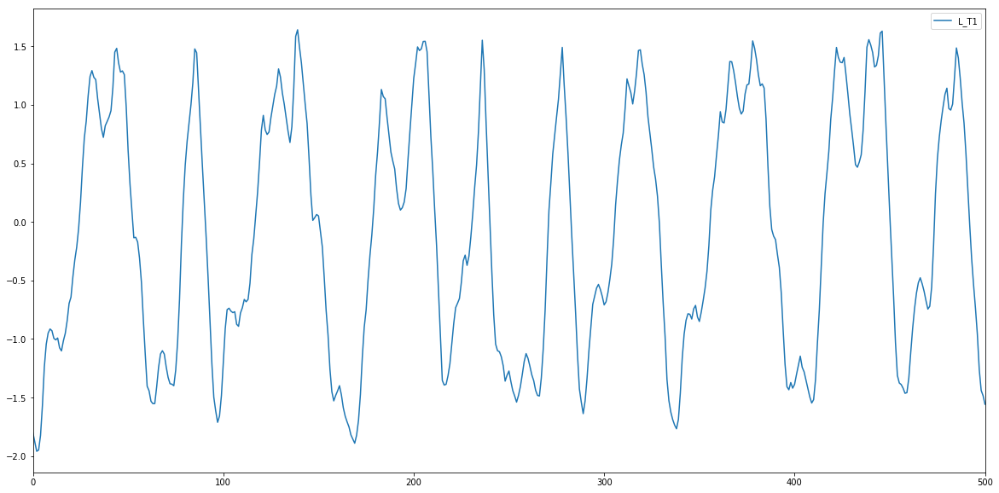

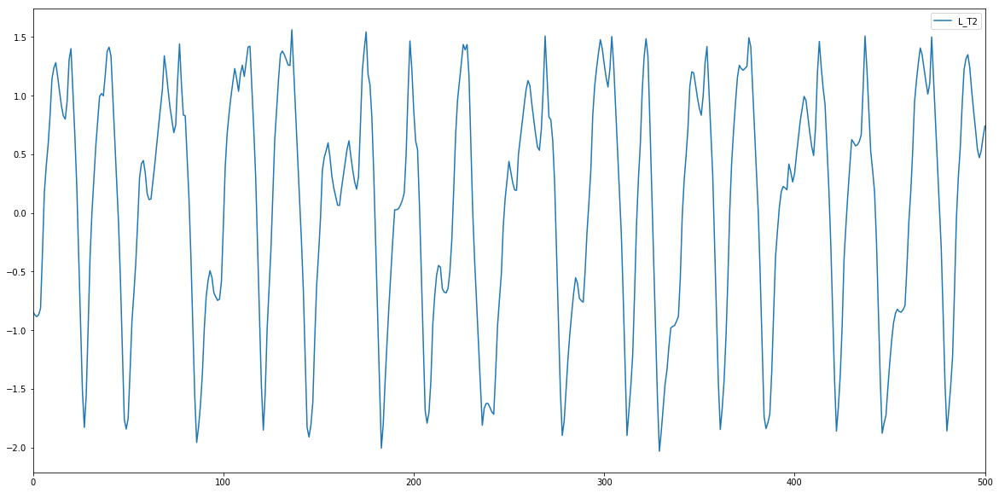

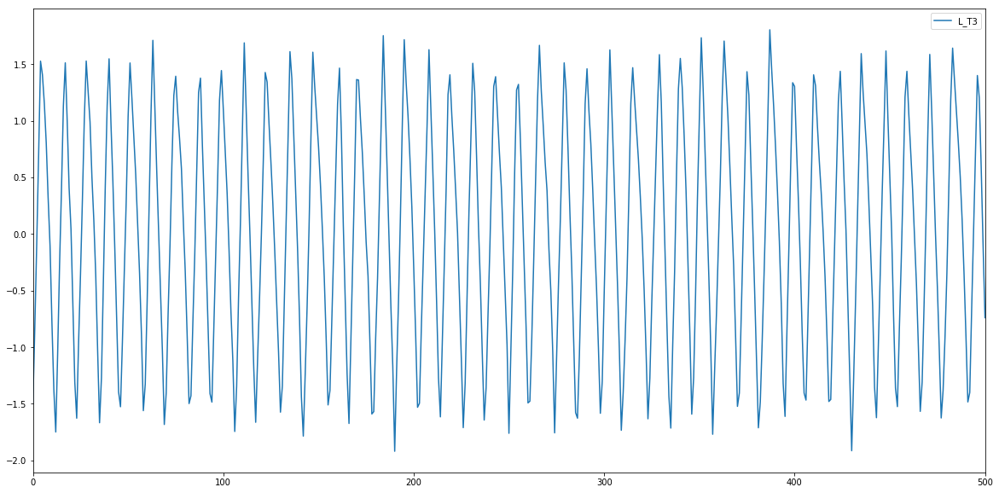

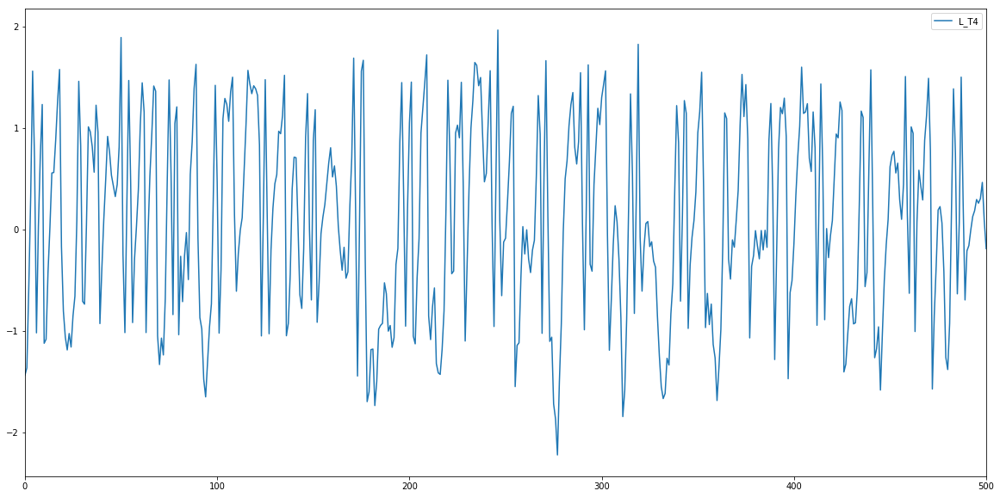

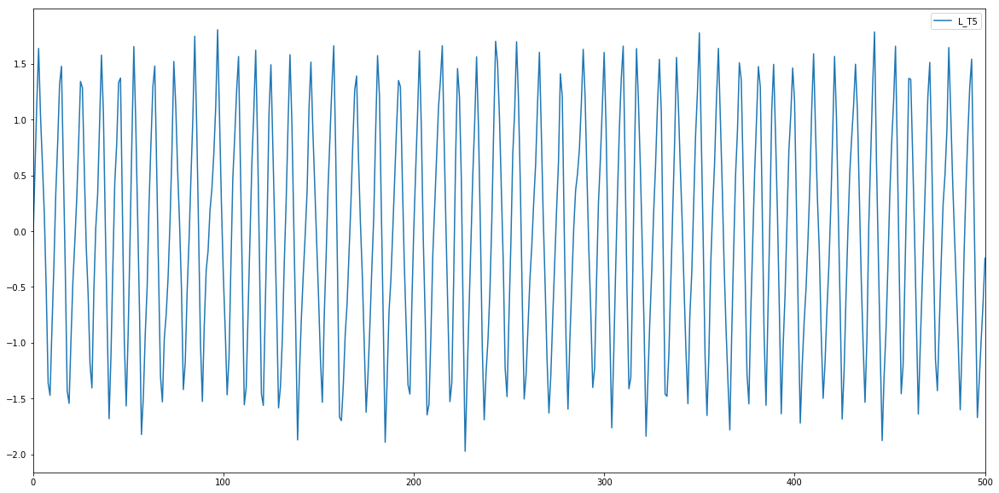

...

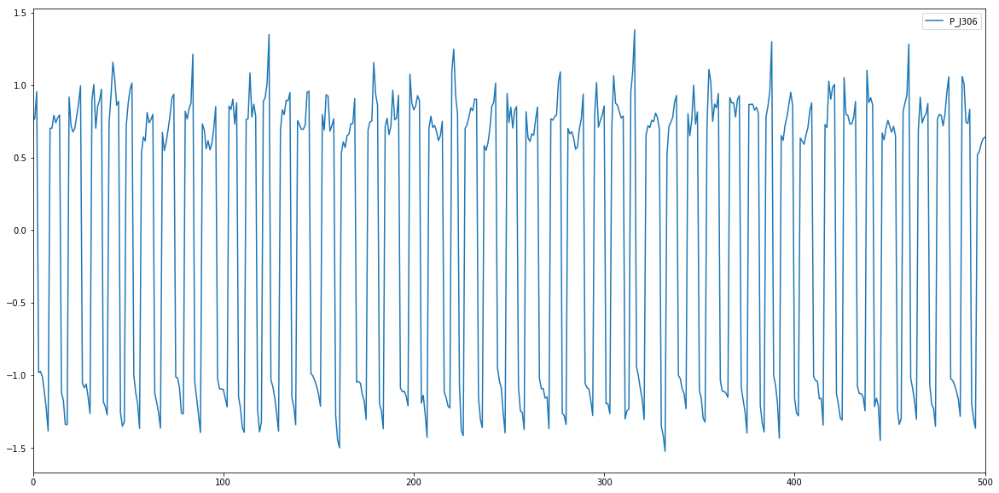

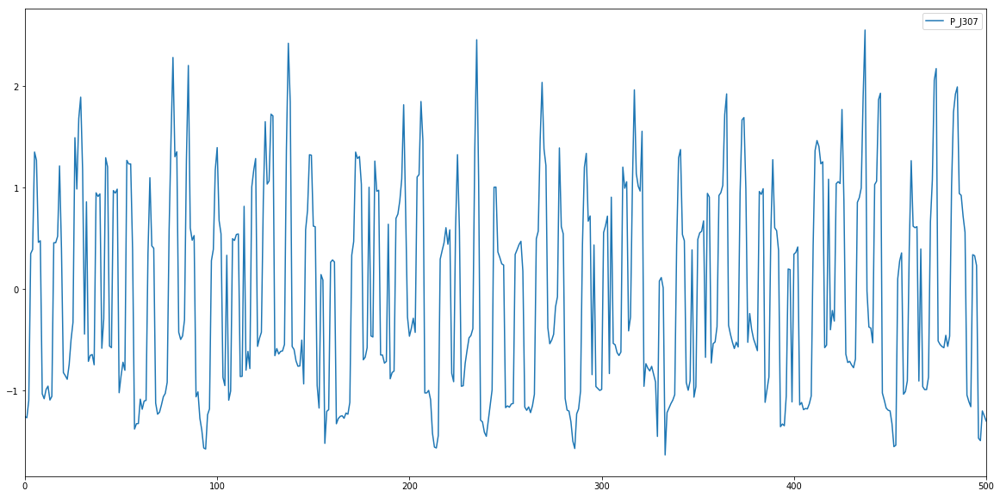

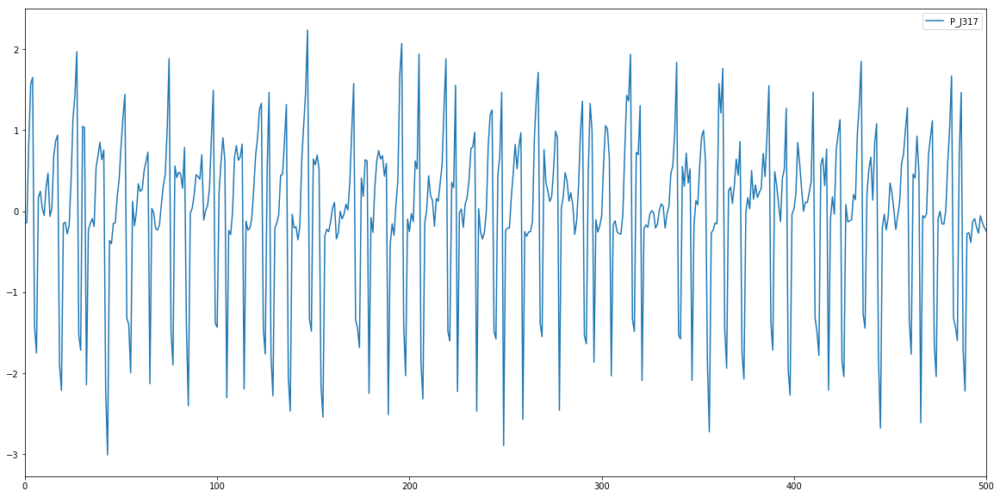

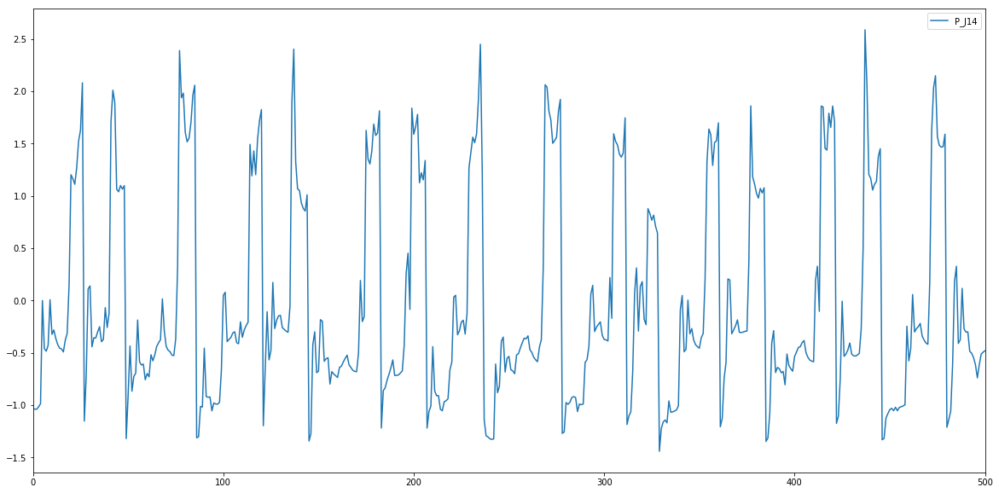

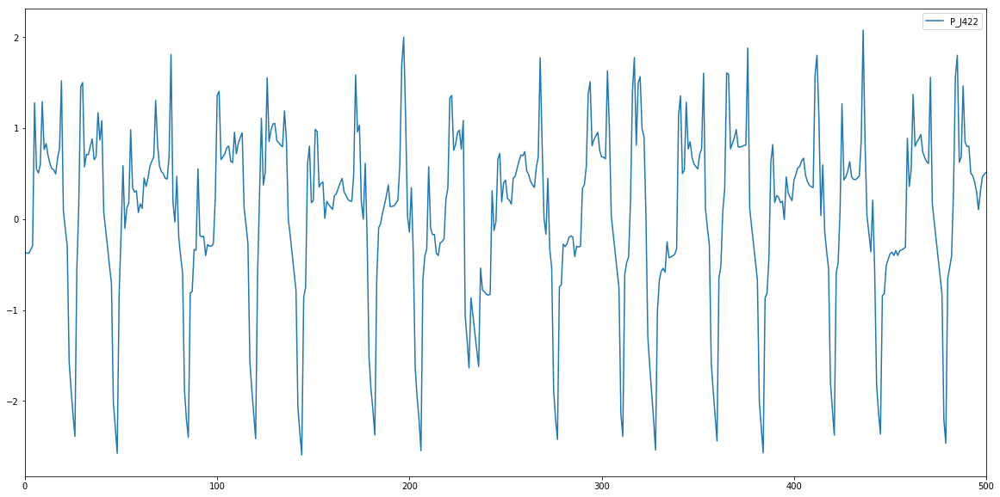

In [8]:
# time series plot, we only plot  in the 0-500 contiunous time slice
print('Images for trainingData 1')
col=normalized_1.columns.tolist()
col.remove('DATETIME')
col.remove('ATT_FLAG')
for i in col:
    normalized_1.loc[0:500,i].plot(figsize=(20,10))
    plt.legend()
    plt.show()

Images for trainingData_2


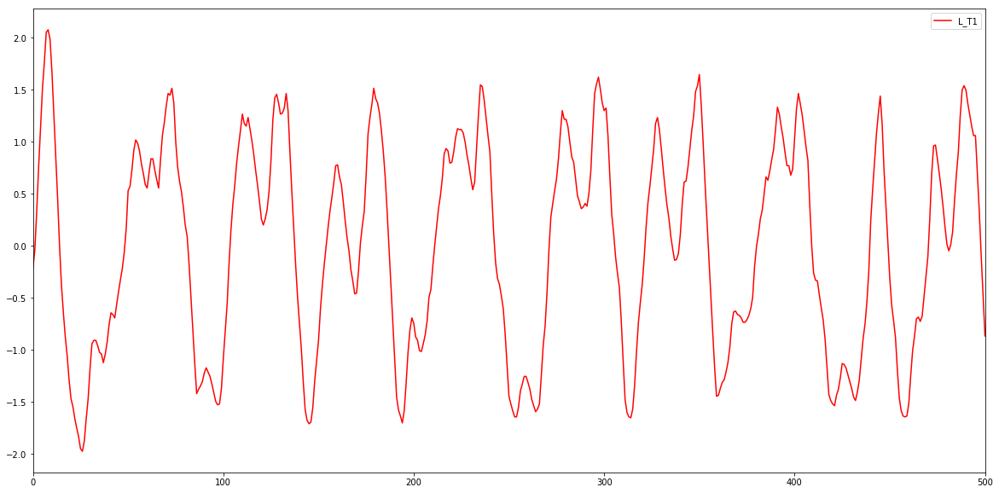

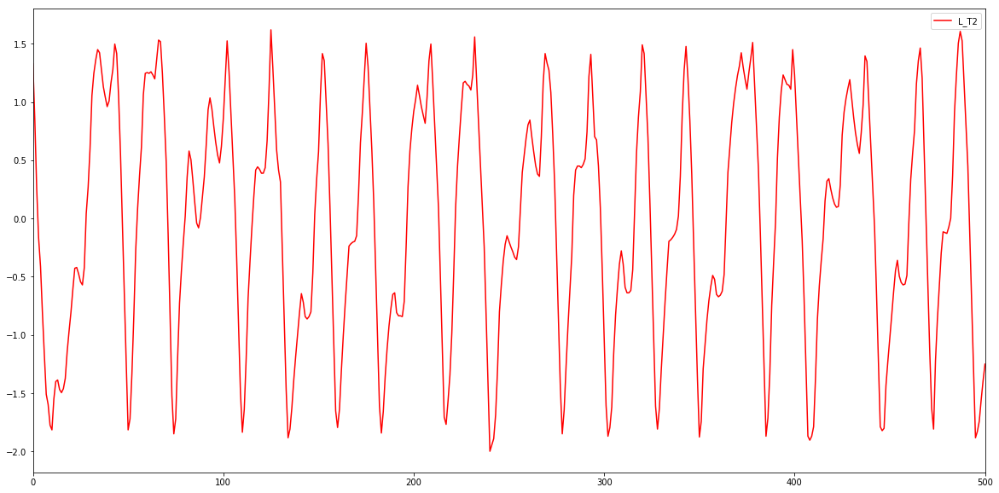

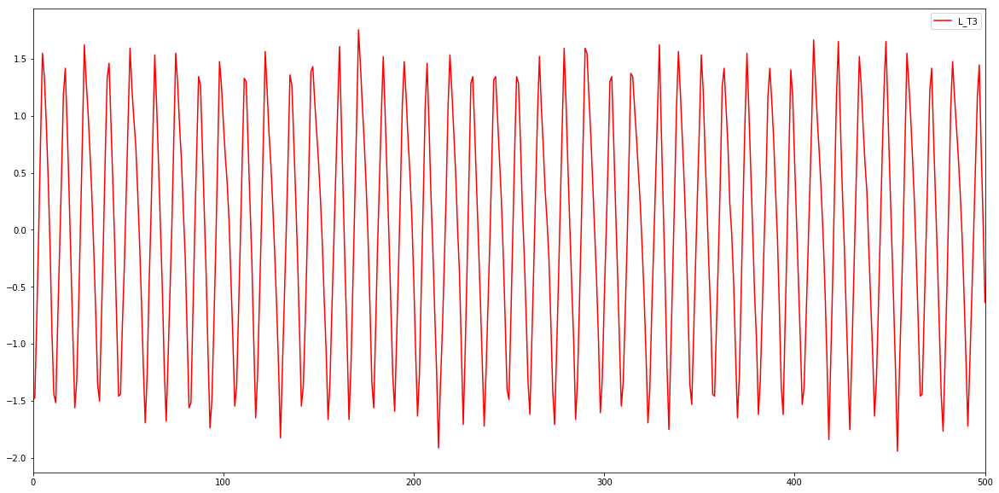

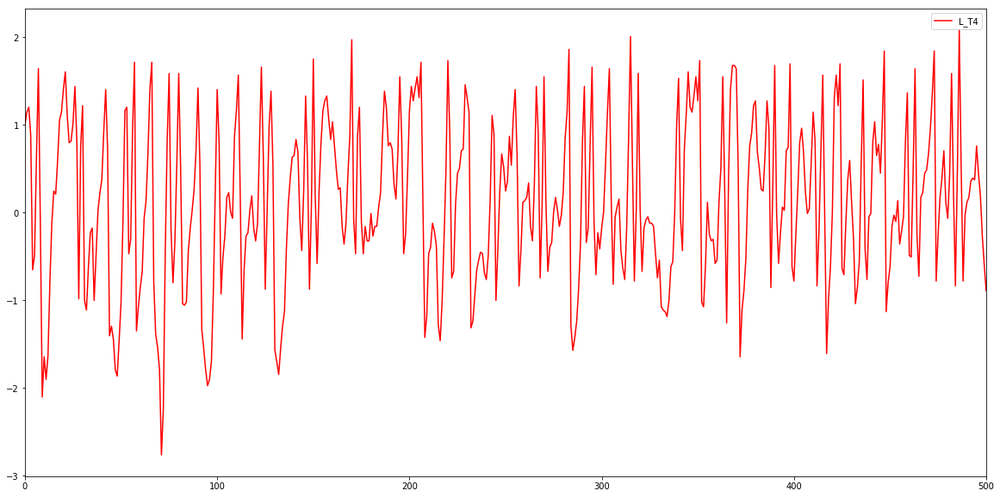

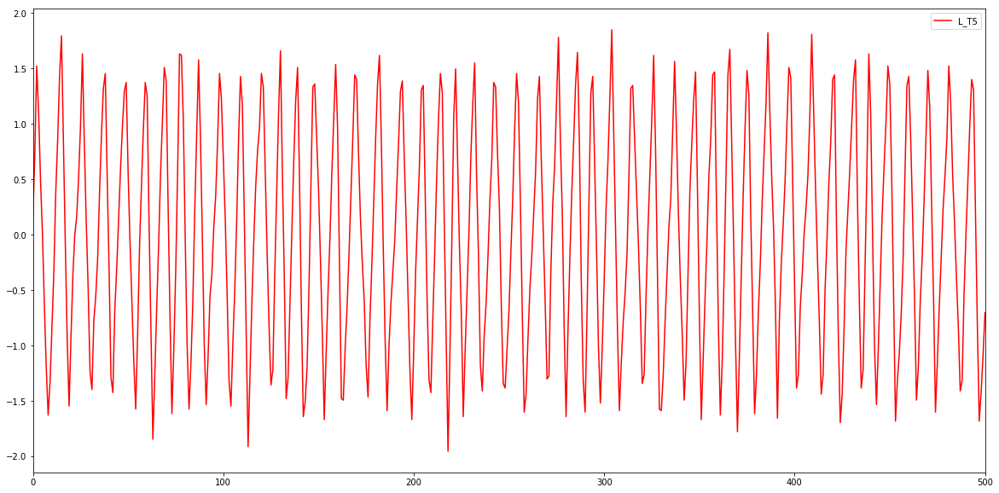

...

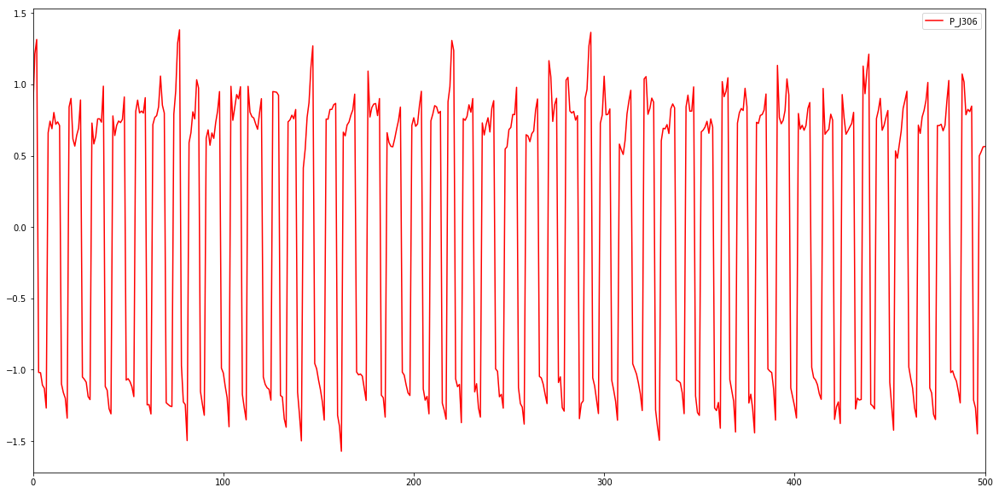

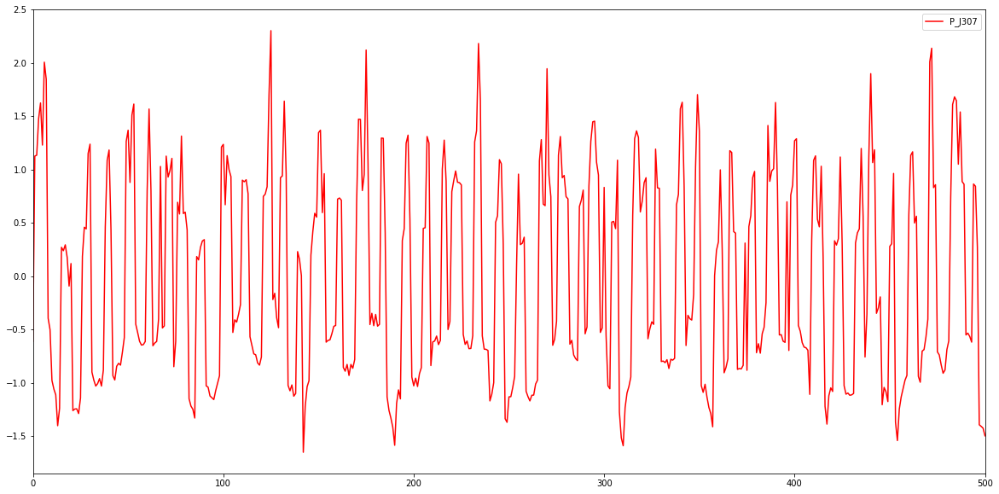

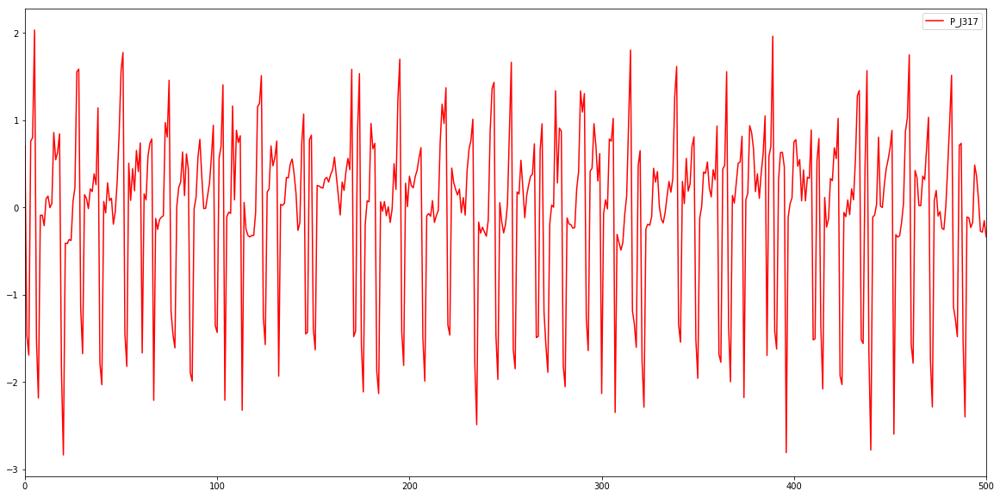

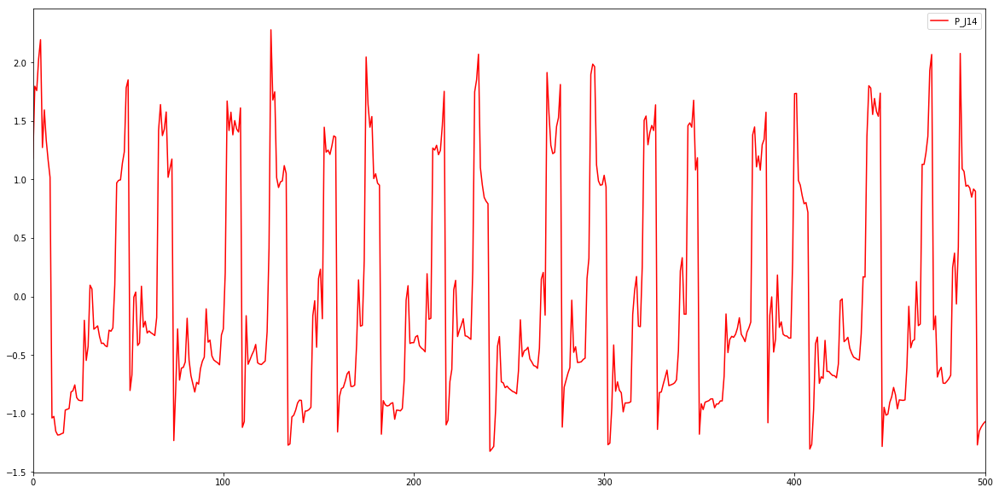

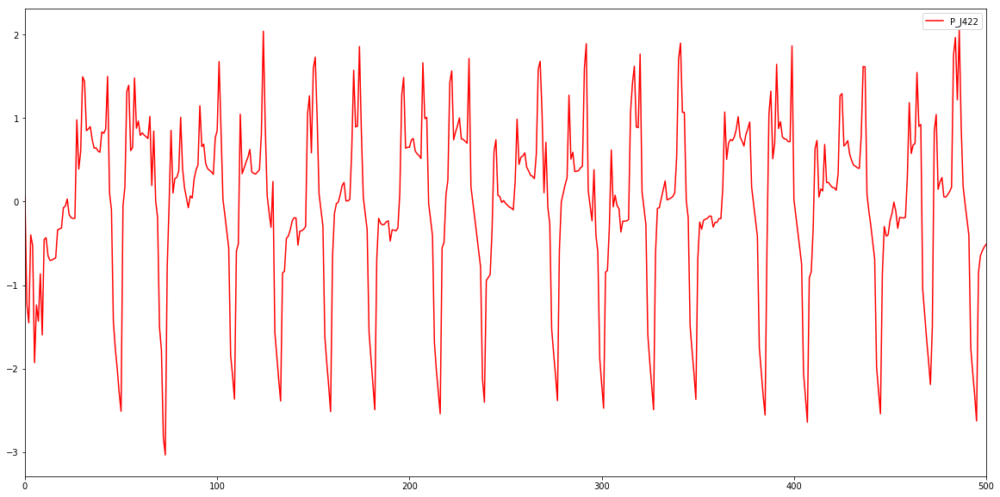

In [9]:
print('Images for trainingData_2')
col=normalized_2.columns.tolist()
col.remove('DATETIME')
col.remove('ATT_FLAG')
for i in col:
    normalized_2.loc[0:500,i].plot(figsize=(20,10),color='red')
    plt.legend()
    plt.show()

Images for testData


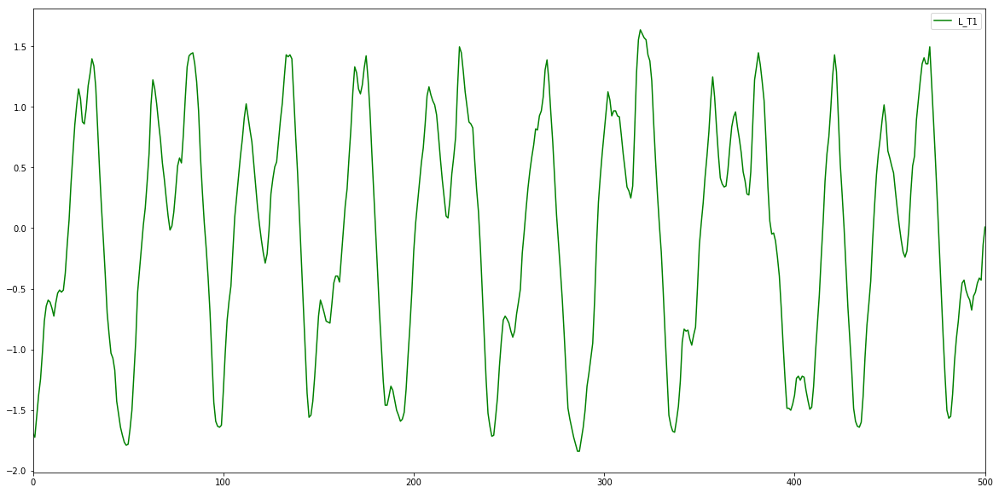

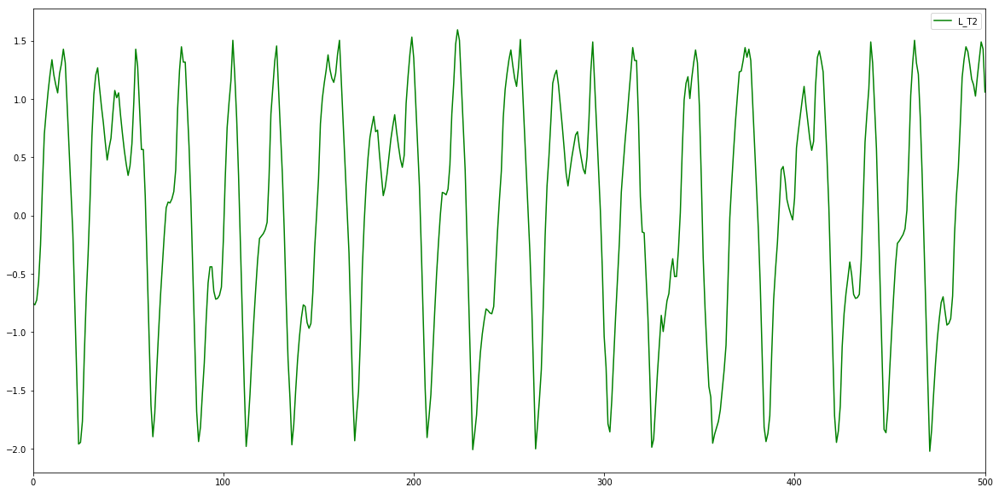

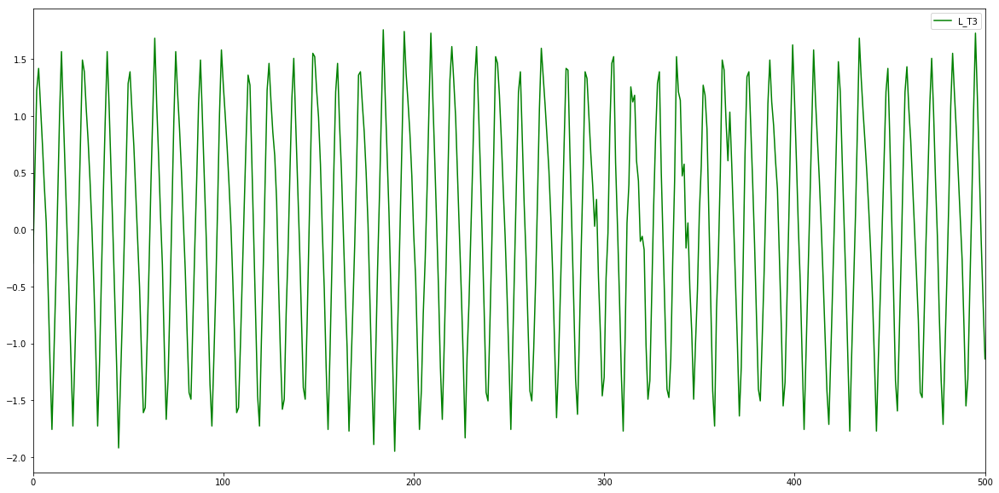

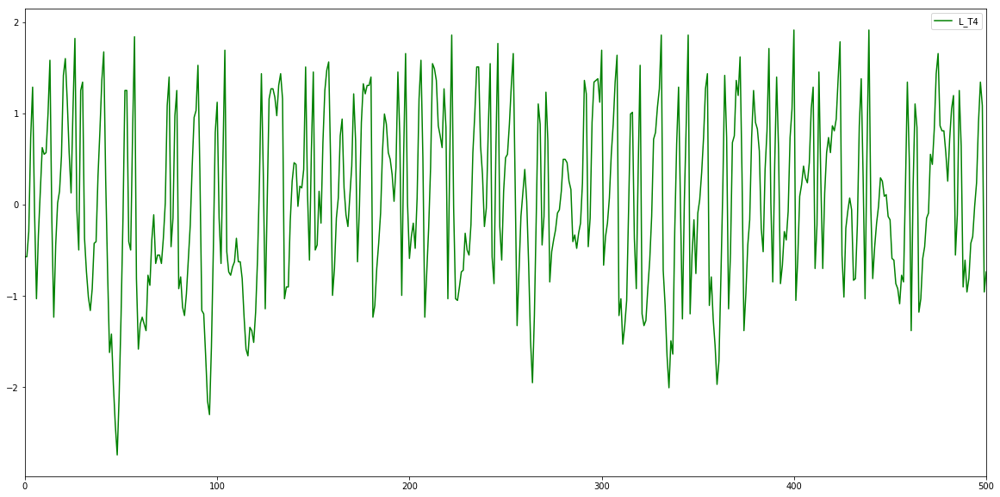

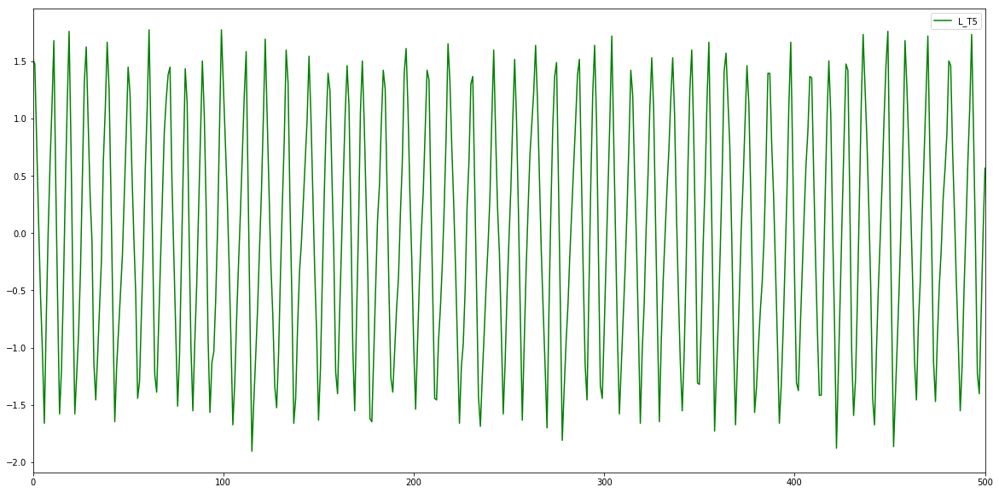

...

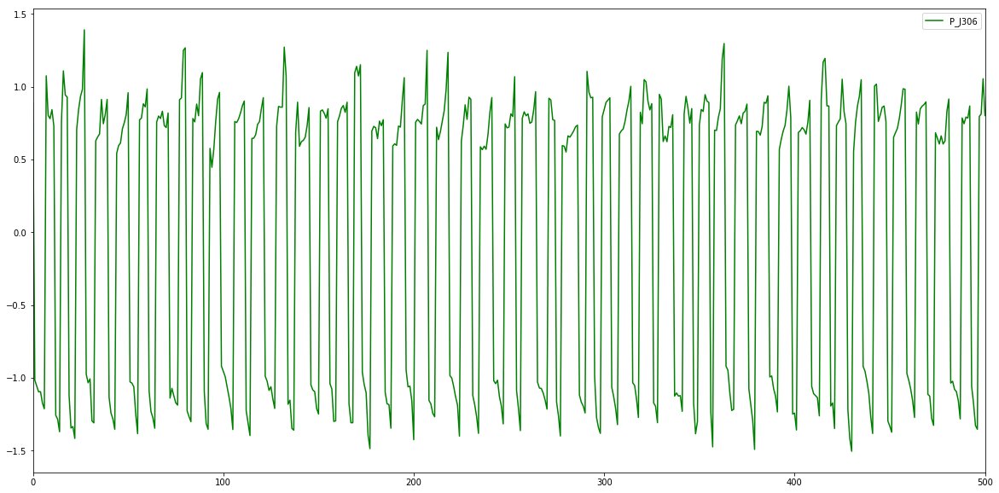

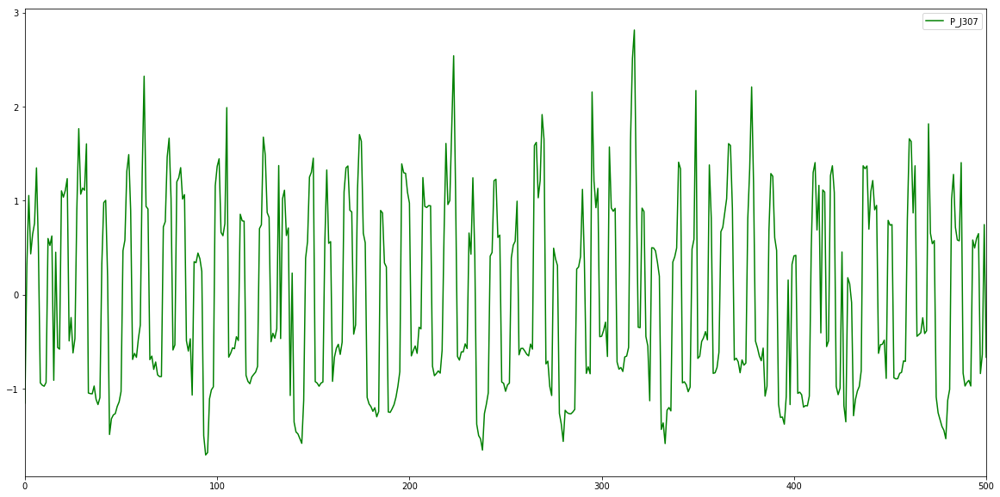

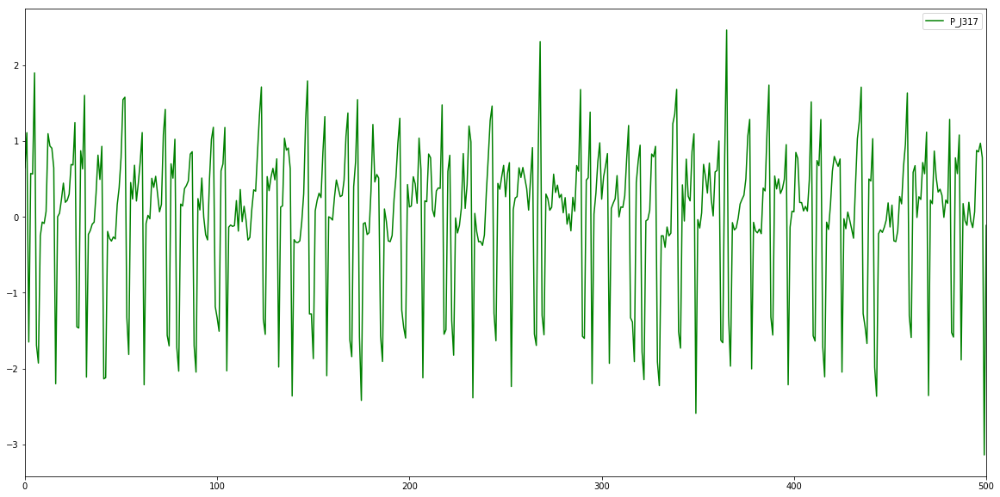

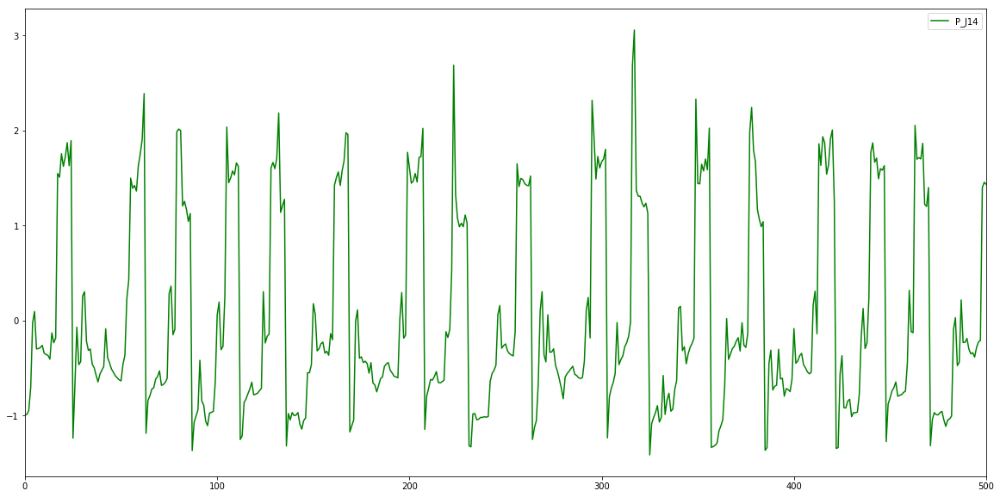

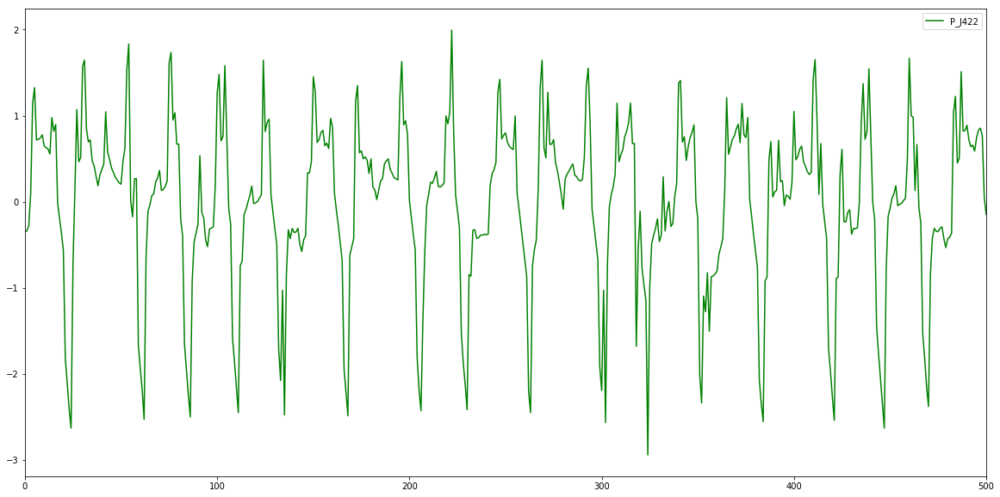

In [10]:
print('Images for testData')
col=normalized_t.columns.tolist()
col.remove('DATETIME')
for i in col:
    normalized_t.loc[0:500,i].plot(figsize=(20,10),color='green')
    plt.legend()
    plt.show()

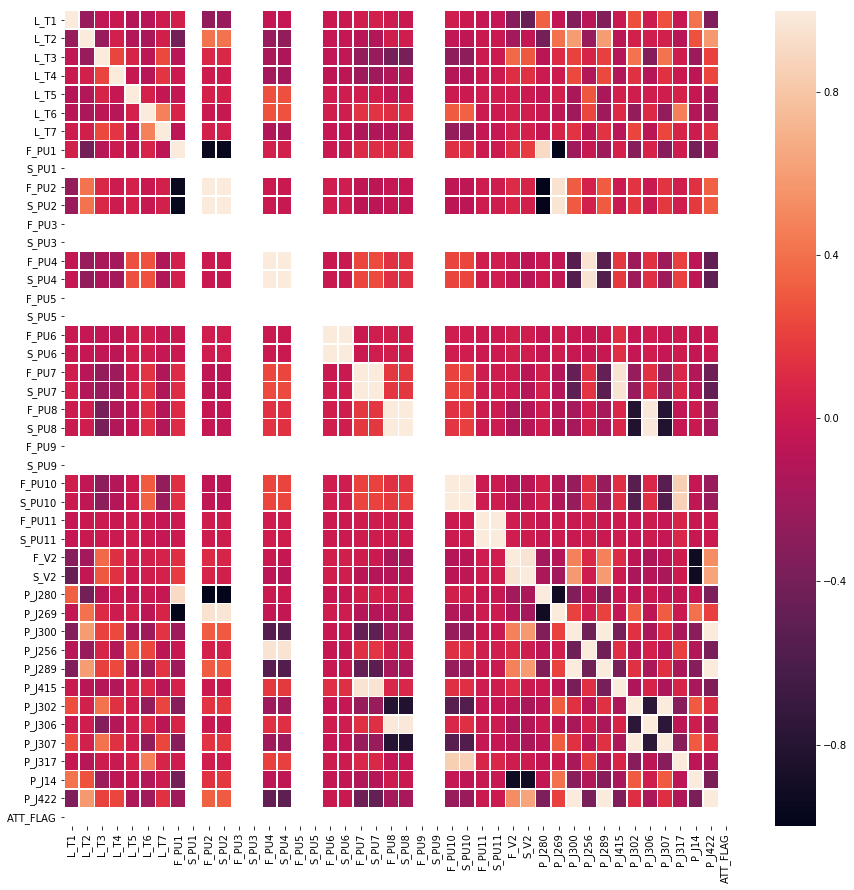

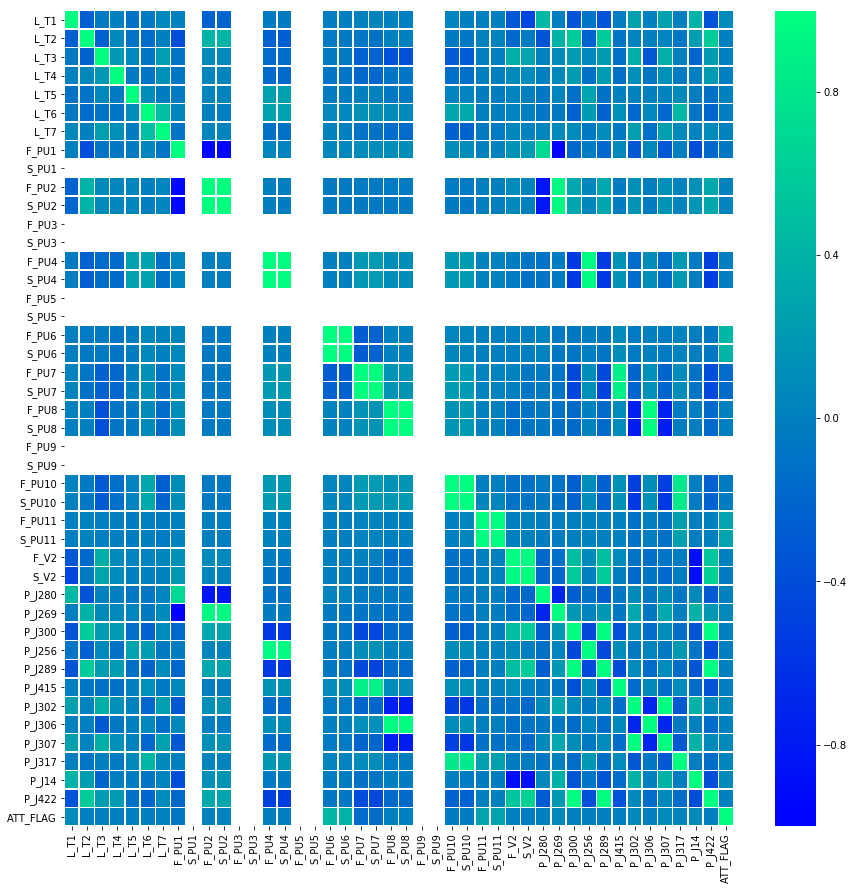

In [11]:
#show corrleation 
import seaborn as sns
plt.figure(figsize=(15, 15))
corr = normalized_1.corr()
sns.heatmap(corr, xticklabels=corr.columns.values,yticklabels=corr.columns.values,linewidth=0.5)
plt.figure(figsize=(15, 15))
corr = normalized_2.corr()
sns.heatmap(corr,cmap='winter', xticklabels=corr.columns.values,yticklabels=corr.columns.values,linewidth=0.5)

most correlated items of L_T1 are :
[['S_V2', -0.462736094993884]]


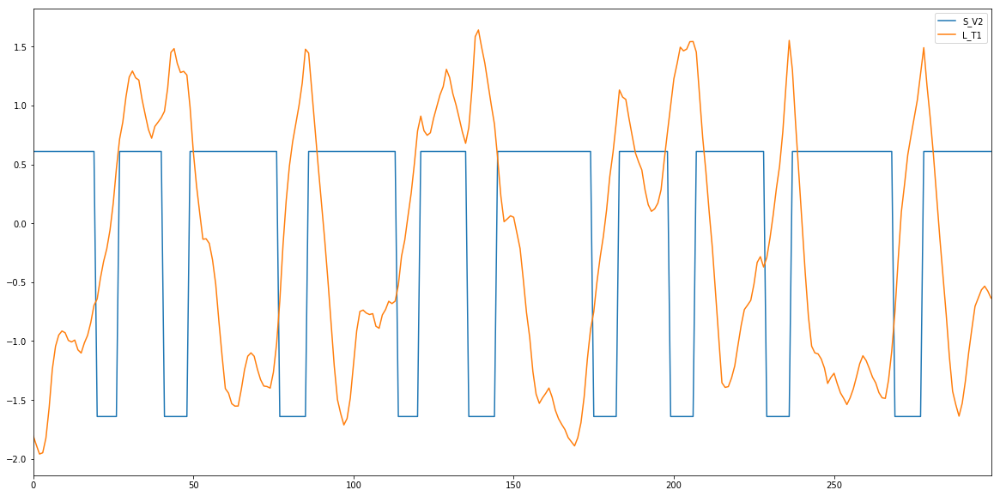

most correlated items of L_T2 are :
[['P_J289', 0.5947713172315878]]


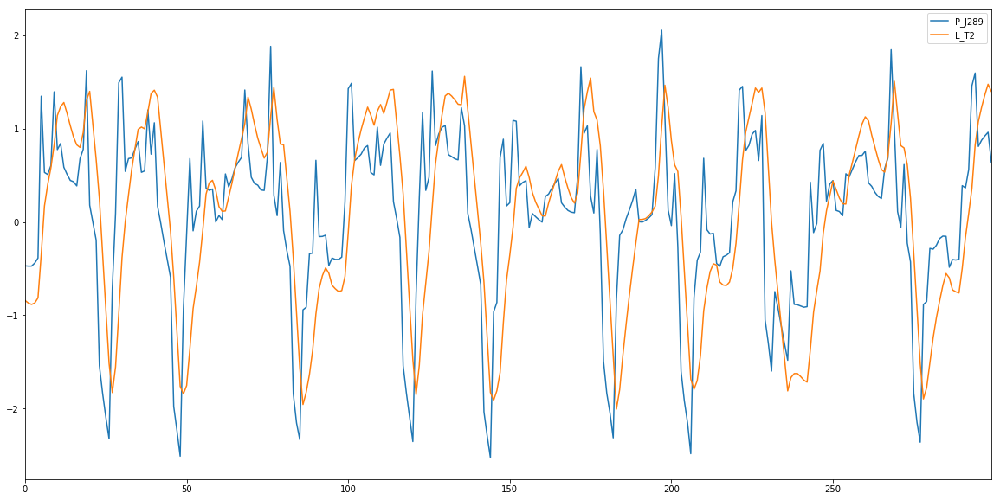

most correlated items of L_T3 are :
[['P_J307', 0.40915569640397853]]


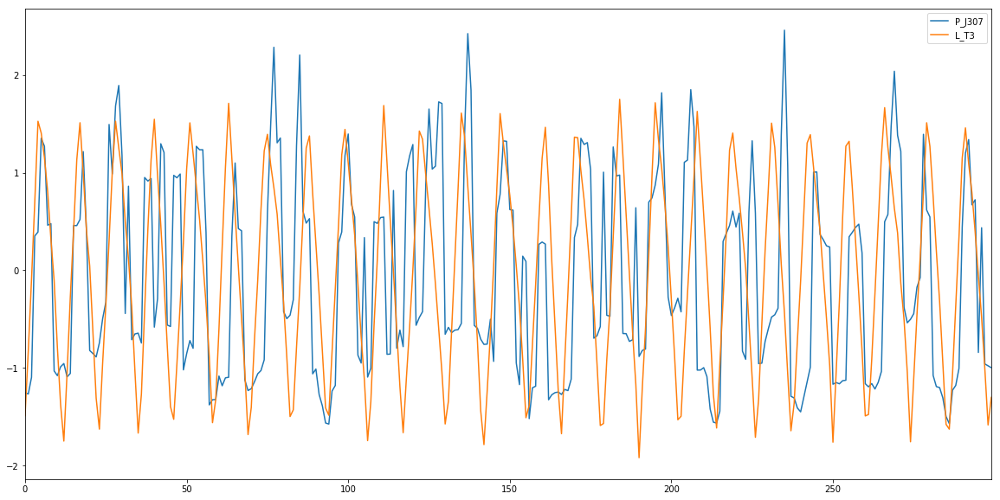

most correlated items of L_T4 are :
[['P_J300', 0.23708234030222733]]


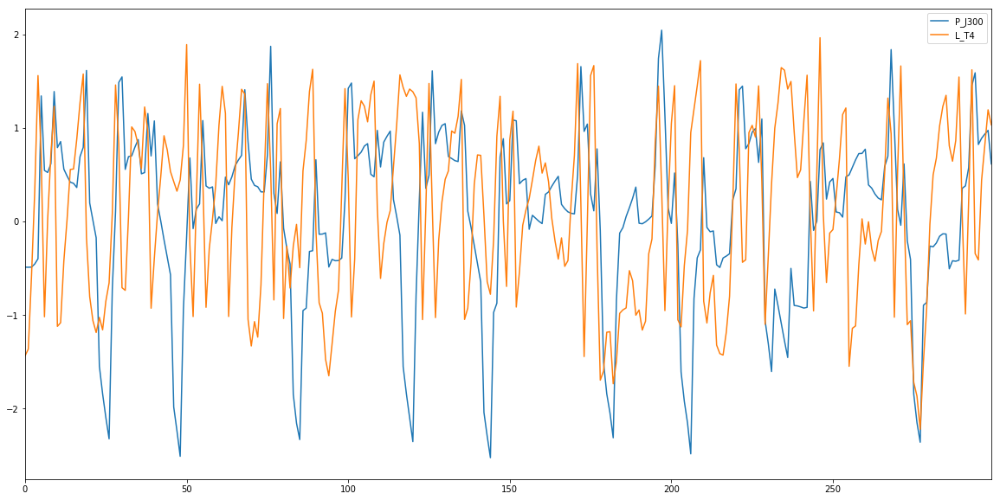

most correlated items of L_T5 are :
[['P_J256', 0.2960579537760998]]


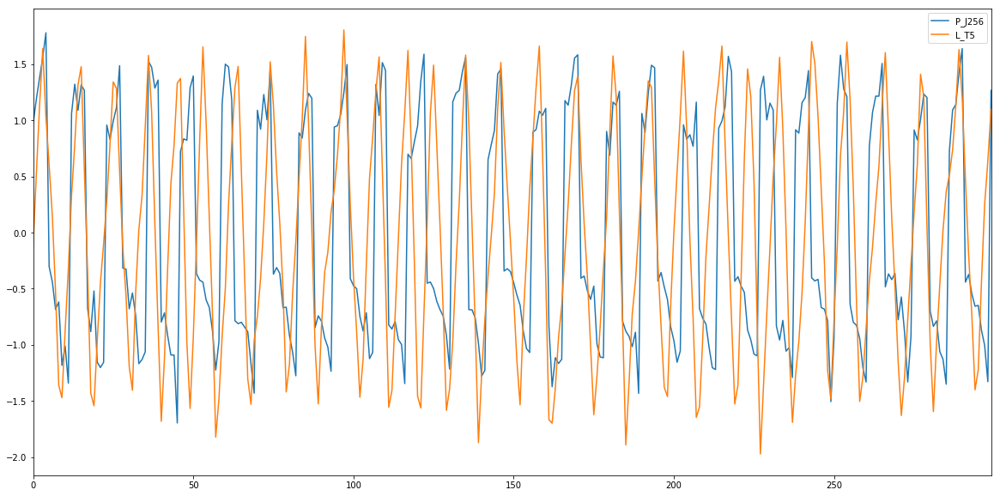

most correlated items of L_T6 are :
[['L_T7', 0.4720084946432058]]


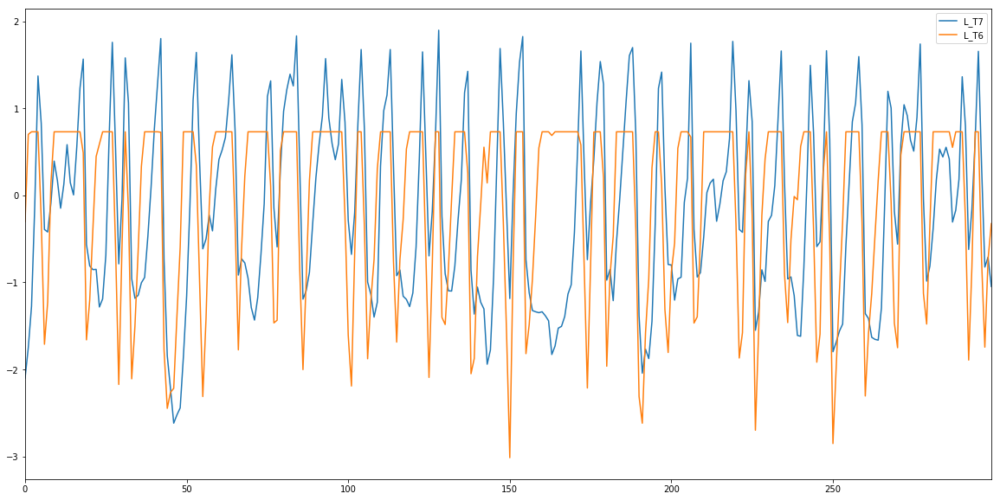

most correlated items of L_T7 are :
[['L_T6', 0.4720084946432058]]


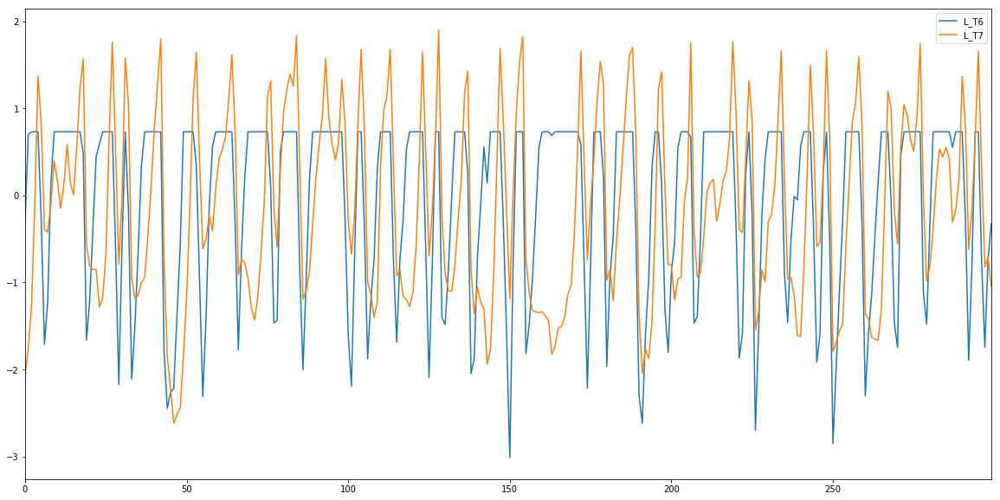

most correlated items of F_PU1 are :
[['F_PU2', -0.9490116662577553], ['S_PU2', -0.9619861213680209], ['P_J280', 0.9070518622330676], ['P_J269', -0.9999450056781389]]


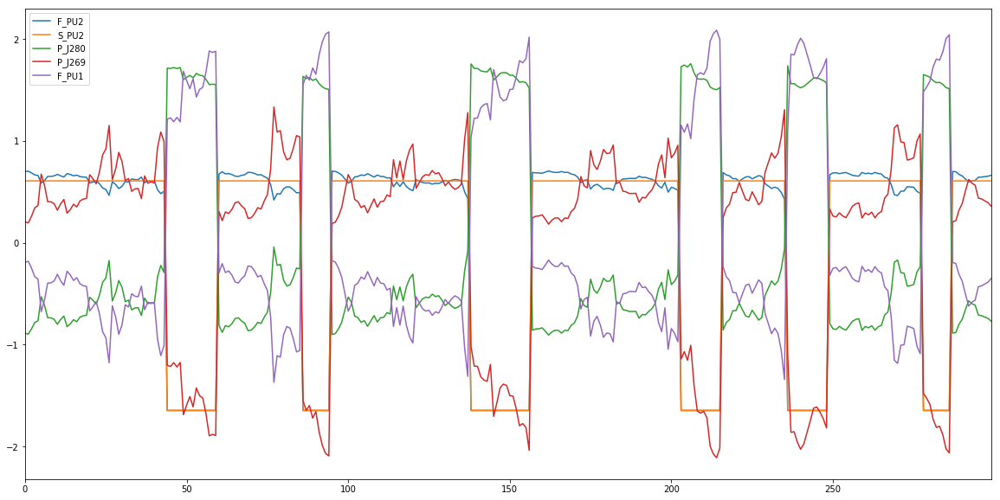

most correlated items of S_PU1 are :
[['L_T1', nan]]


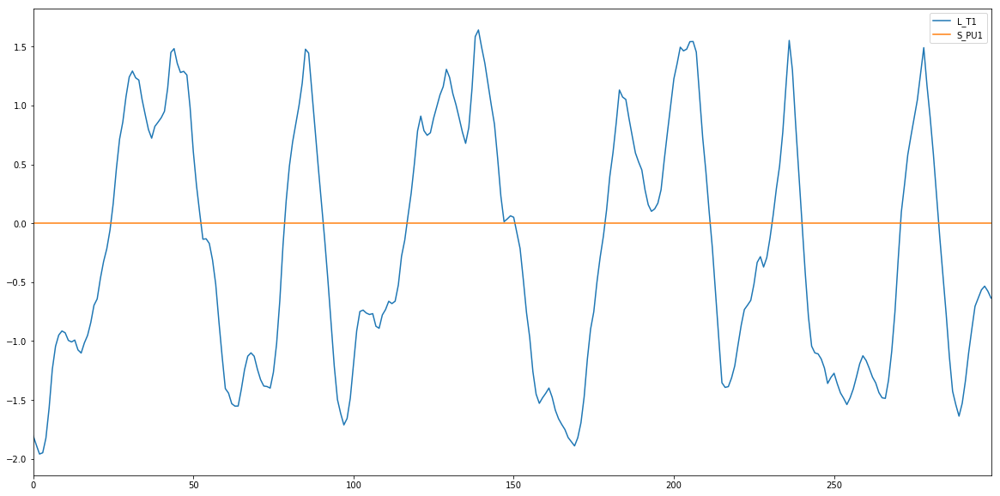

most correlated items of F_PU2 are :
[['F_PU1', -0.9490116662577553], ['S_PU2', 0.9986139581287113], ['P_J280', -0.9933443369056845], ['P_J269', 0.9503465995699732]]


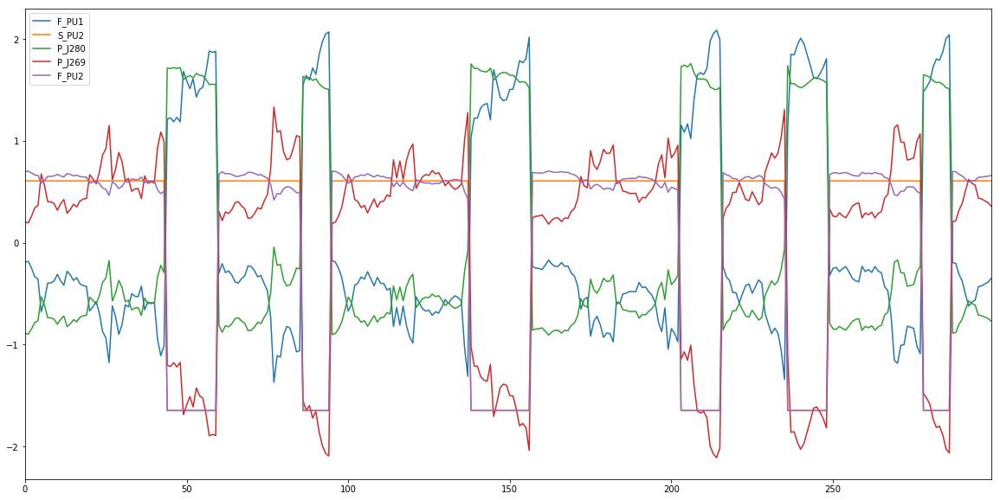

most correlated items of S_PU2 are :
[['F_PU1', -0.9619861213680209], ['F_PU2', 0.9986139581287113], ['P_J280', -0.986257740419537], ['P_J269', 0.9628774143822163]]


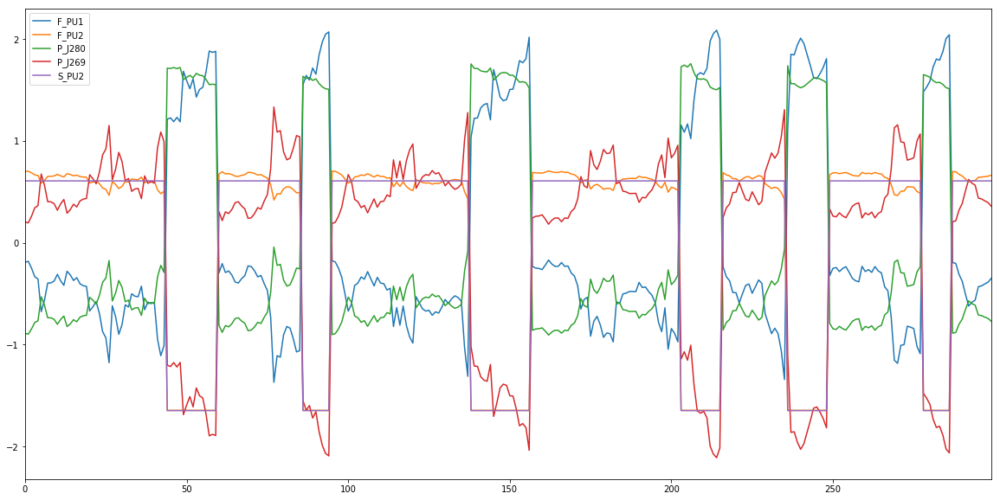

most correlated items of F_PU3 are :
[['L_T1', nan]]


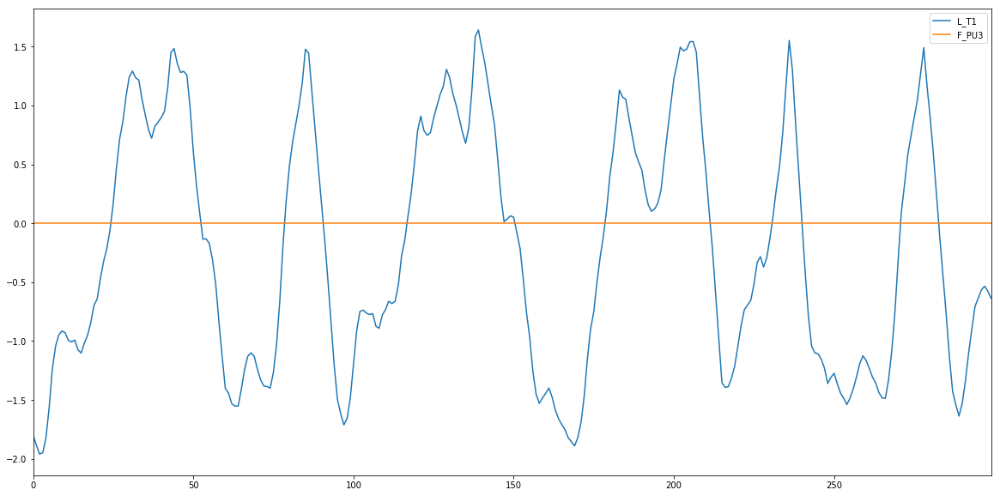

most correlated items of S_PU3 are :
[['L_T1', nan]]


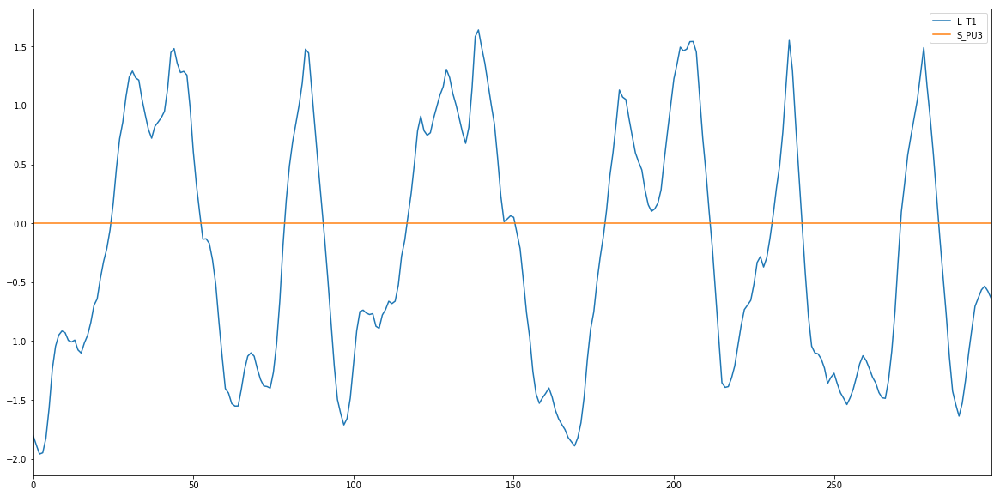

most correlated items of F_PU4 are :
[['S_PU4', 0.9986486512925968], ['P_J256', 0.9559029678342637]]


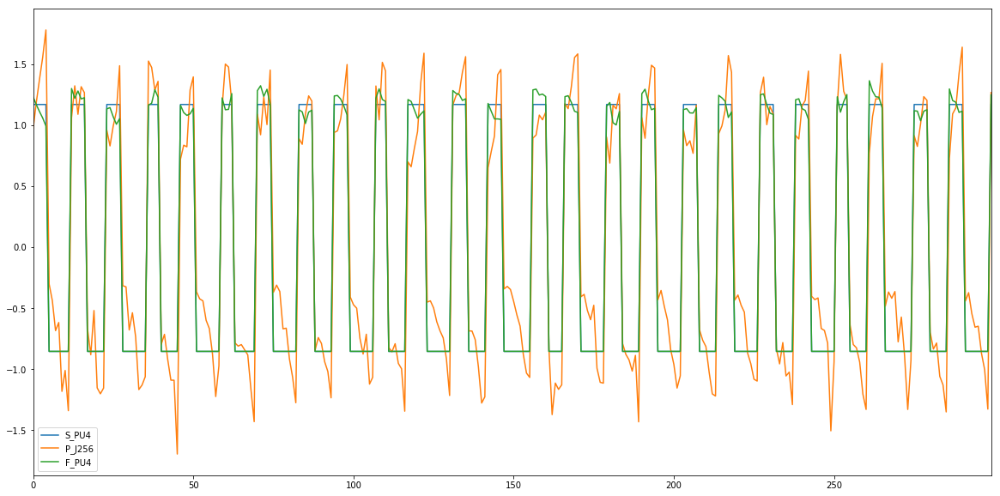

most correlated items of S_PU4 are :
[['F_PU4', 0.9986486512925968], ['P_J256', 0.9589243761429387]]


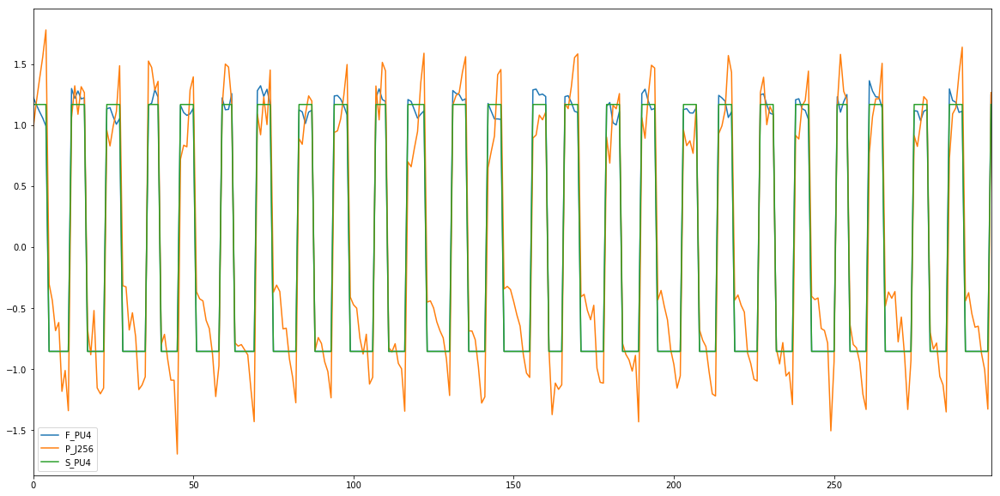

most correlated items of F_PU5 are :
[['L_T1', nan]]


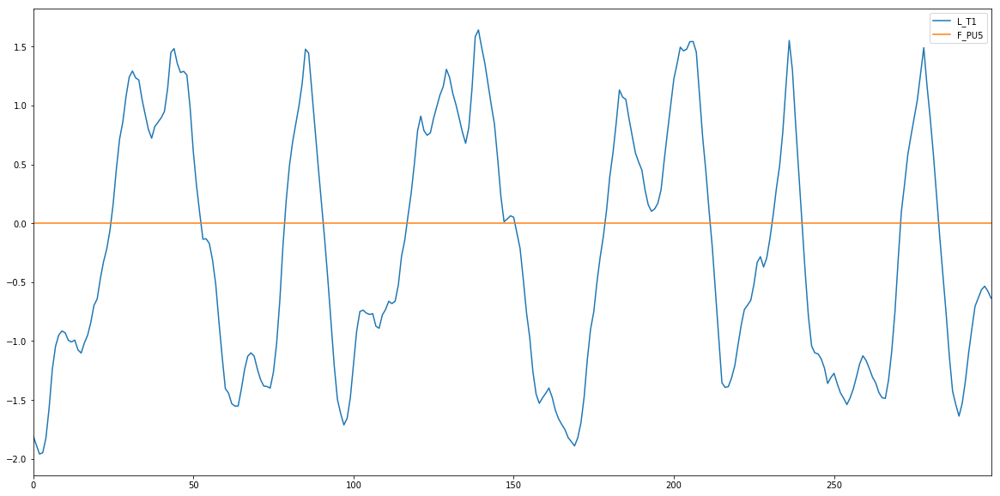

most correlated items of S_PU5 are :
[['L_T1', nan]]


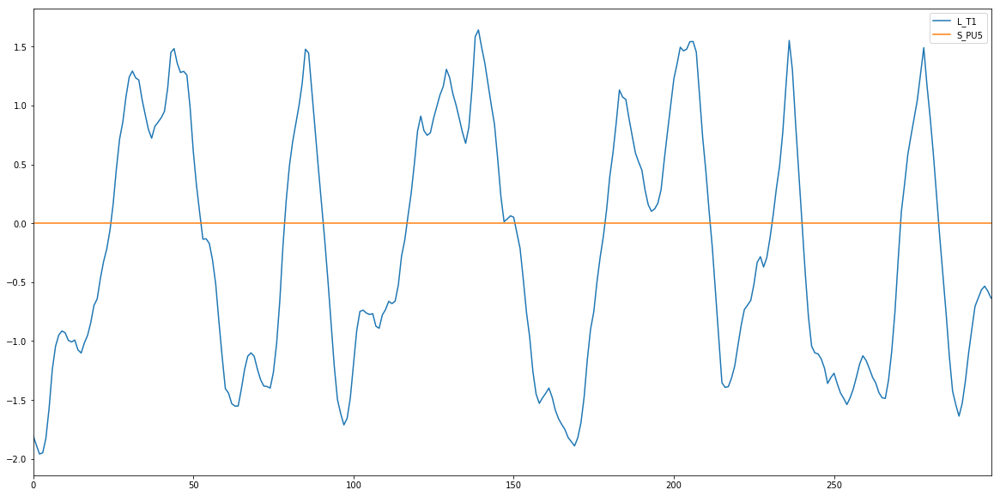

most correlated items of F_PU6 are :
[['S_PU6', 0.9998872057831225]]


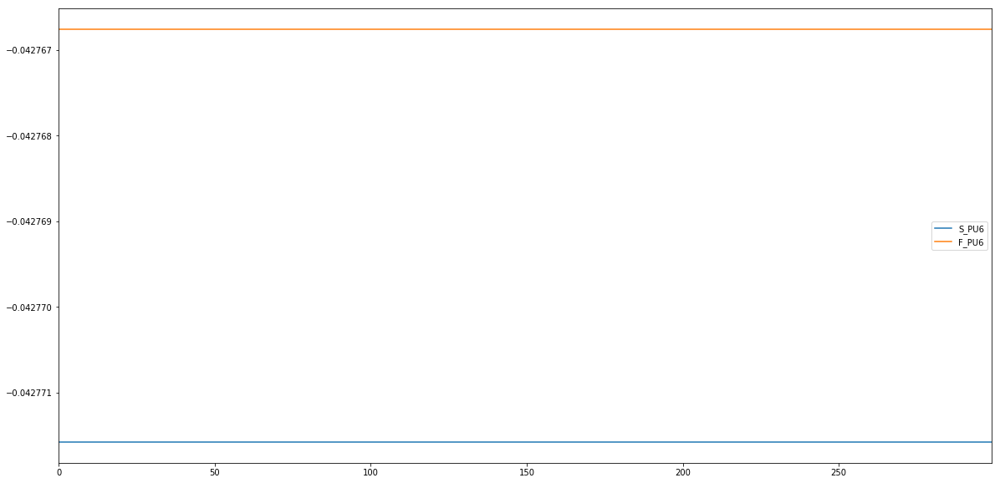

most correlated items of S_PU6 are :
[['F_PU6', 0.9998872057831225]]


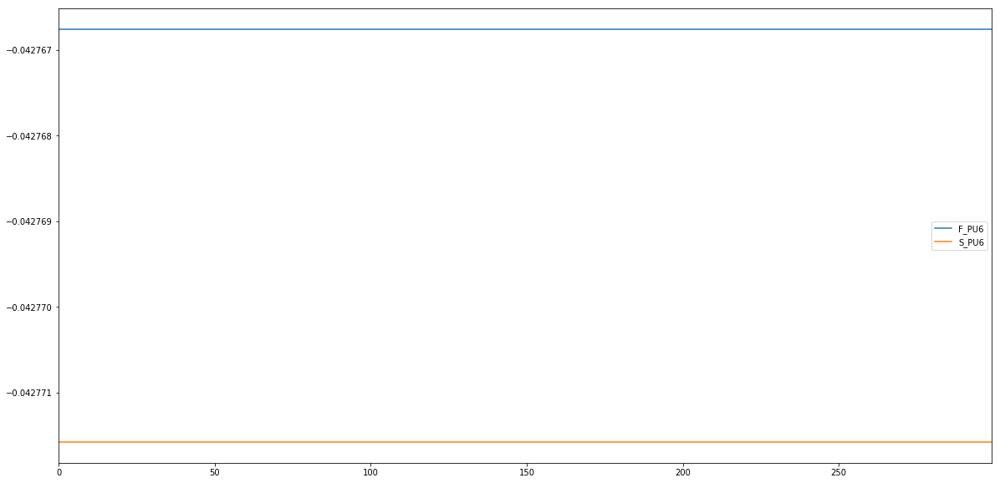

most correlated items of F_PU7 are :
[['S_PU7', 0.9979849078248688], ['P_J415', 0.9540431021378241]]


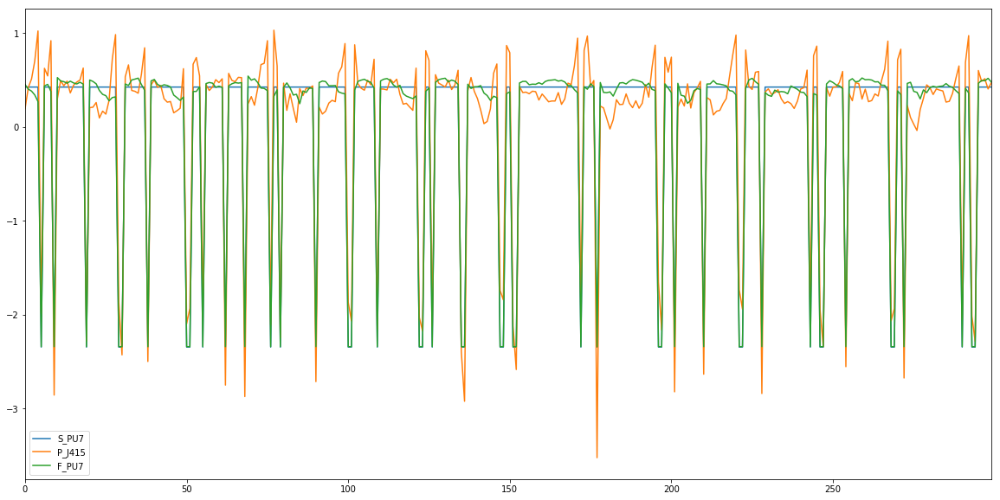

most correlated items of S_PU7 are :
[['F_PU7', 0.9979849078248688], ['P_J415', 0.9607072032273162]]


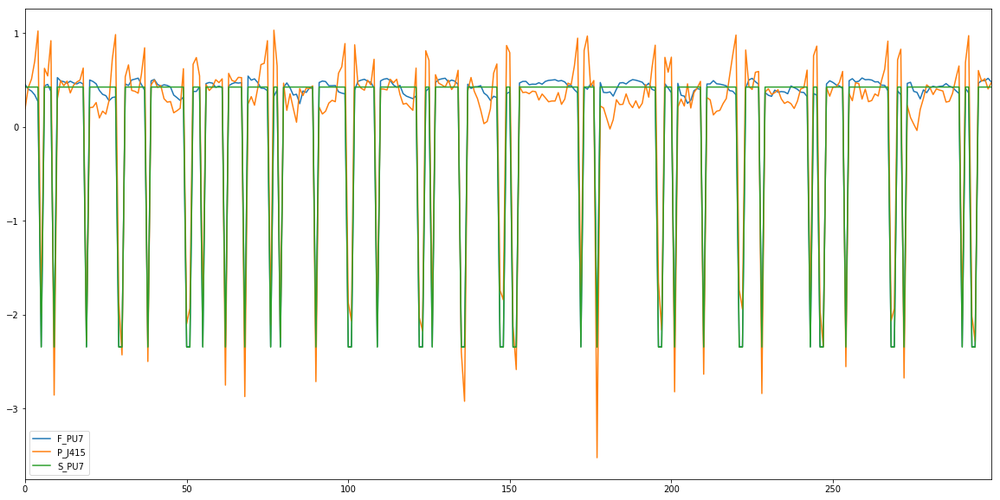

most correlated items of F_PU8 are :
[['S_PU8', 0.9991411523598039], ['P_J302', -0.8066423341688314], ['P_J306', 0.9904838309260136], ['P_J307', -0.8035963027831527]]


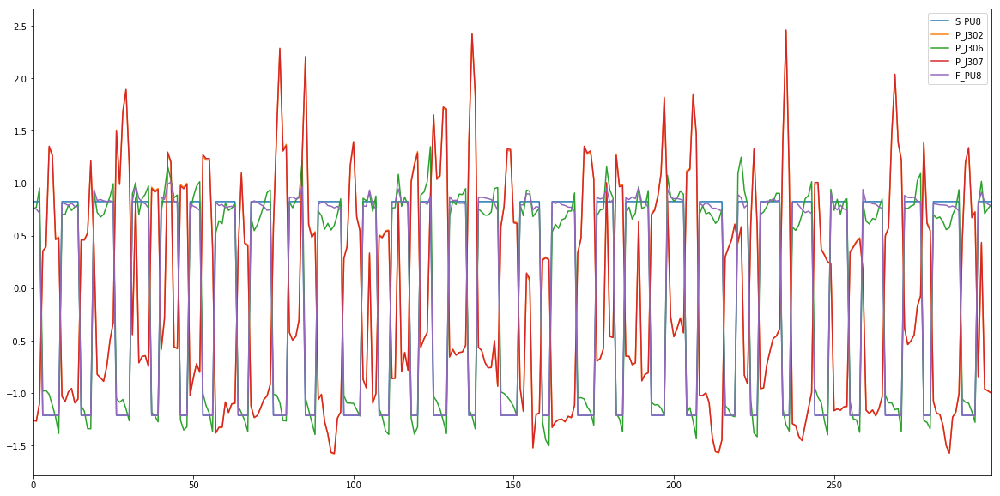

most correlated items of S_PU8 are :
[['F_PU8', 0.9991411523598039], ['P_J302', -0.8237641245152676], ['P_J306', 0.9894258484203827], ['P_J307', -0.8208046863264209]]


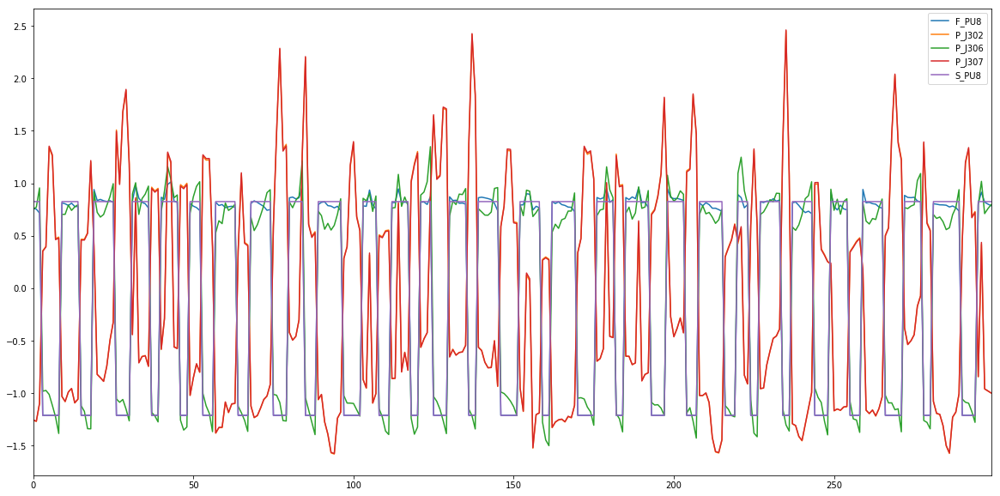

most correlated items of F_PU9 are :
[['L_T1', nan]]


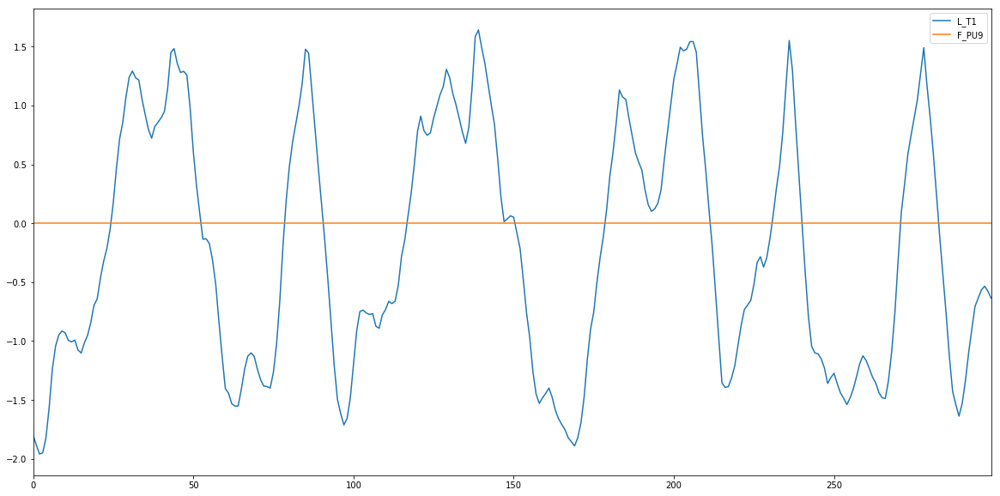

most correlated items of S_PU9 are :
[['L_T1', nan]]


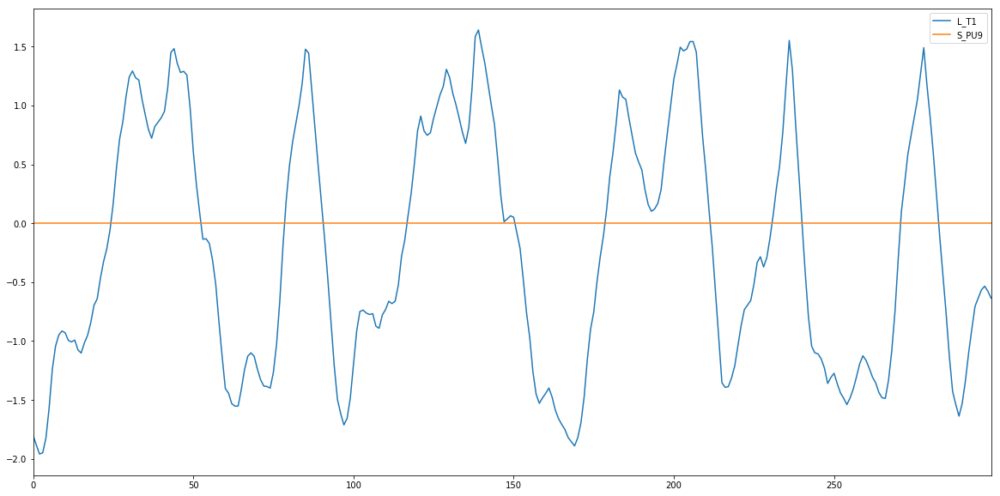

most correlated items of F_PU10 are :
[['S_PU10', 0.9969027215947379], ['P_J317', 0.8477355048749448]]


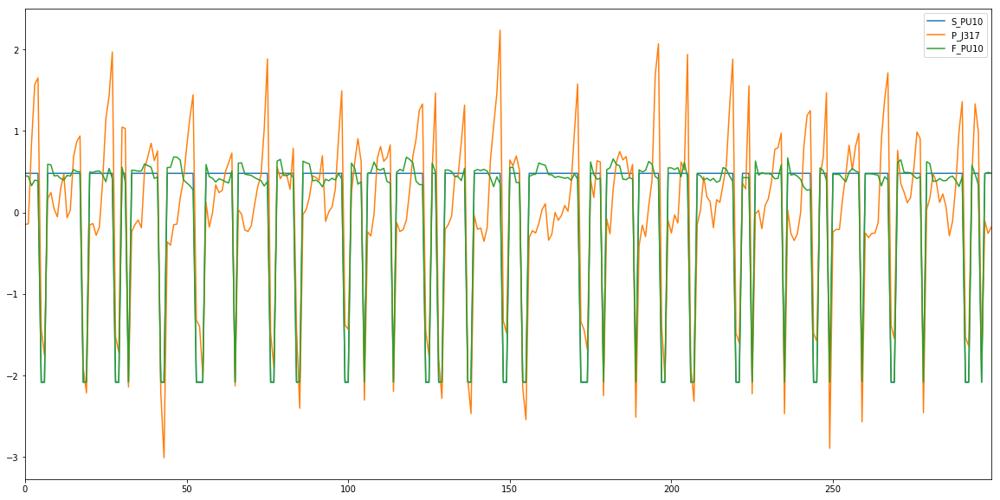

most correlated items of S_PU10 are :
[['F_PU10', 0.9969027215947379], ['P_J317', 0.8618425210153933]]


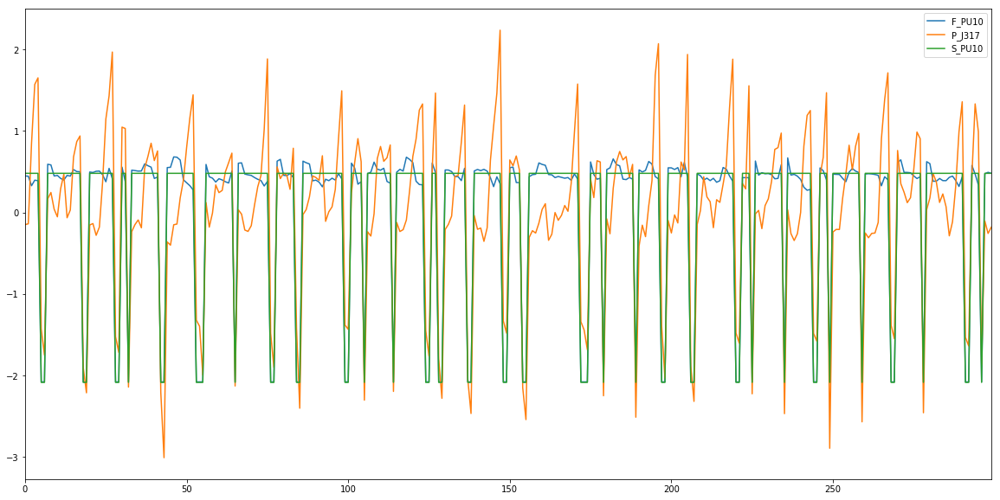

most correlated items of F_PU11 are :
[['S_PU11', 0.9975637653047018]]


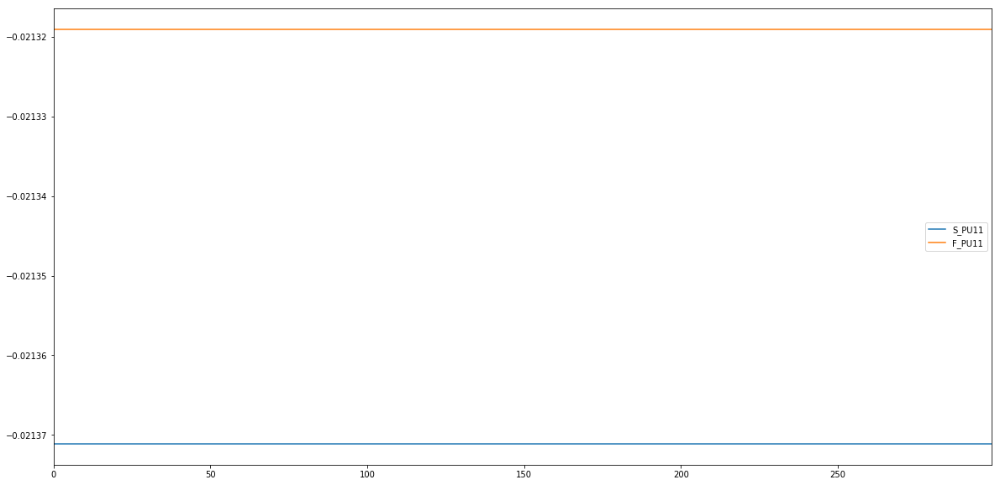

most correlated items of S_PU11 are :
[['F_PU11', 0.9975637653047018]]


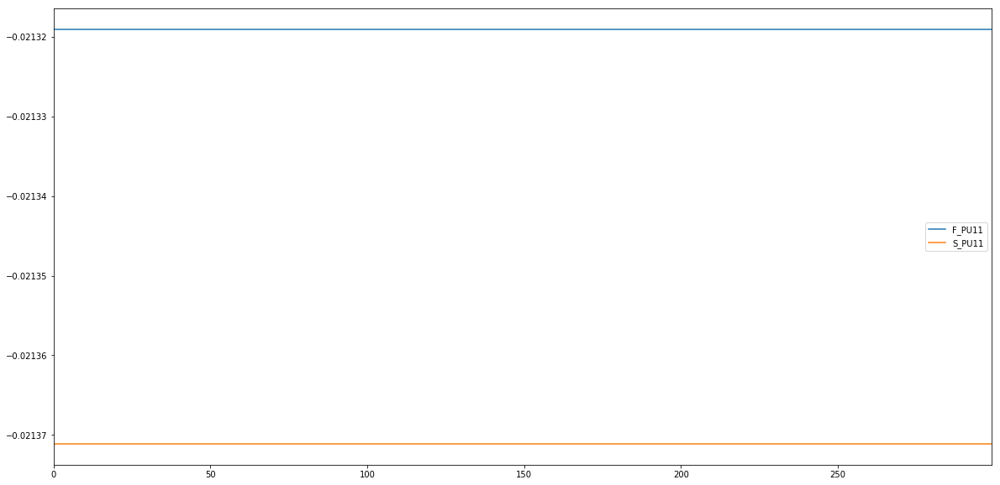

most correlated items of F_V2 are :
[['S_V2', 0.9555233552878185], ['P_J14', -0.9272660136287085]]


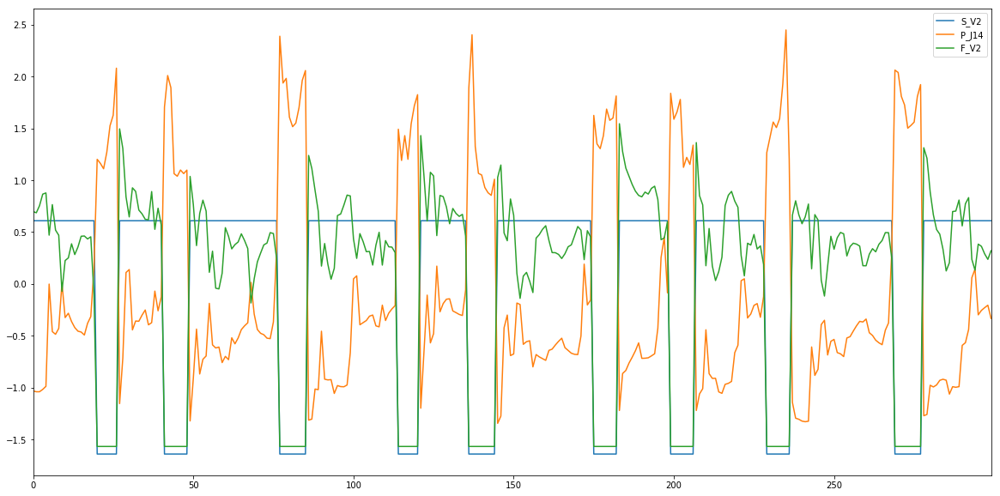

most correlated items of S_V2 are :
[['F_V2', 0.9555233552878185], ['P_J14', -0.9196422712371278]]


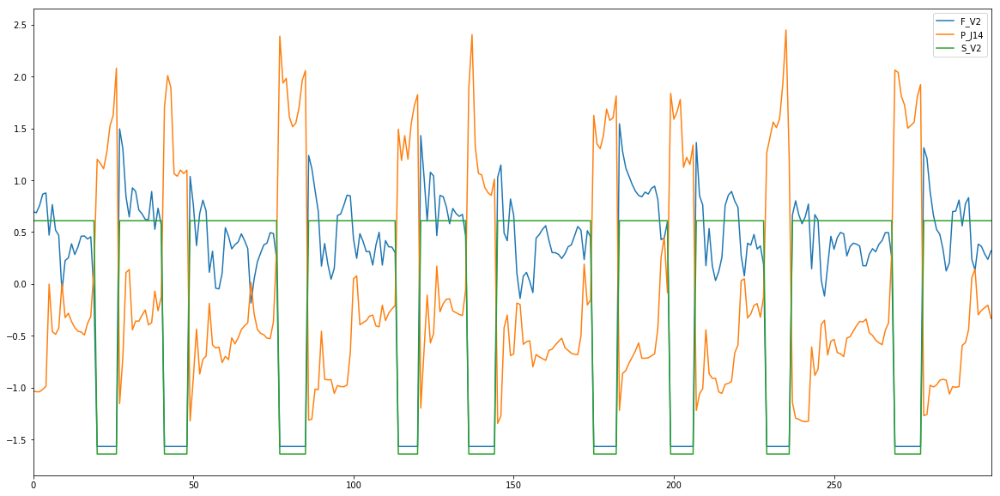

most correlated items of P_J280 are :
[['F_PU1', 0.9070518622330676], ['F_PU2', -0.9933443369056845], ['S_PU2', -0.986257740419537], ['P_J269', -0.9090545503316122]]


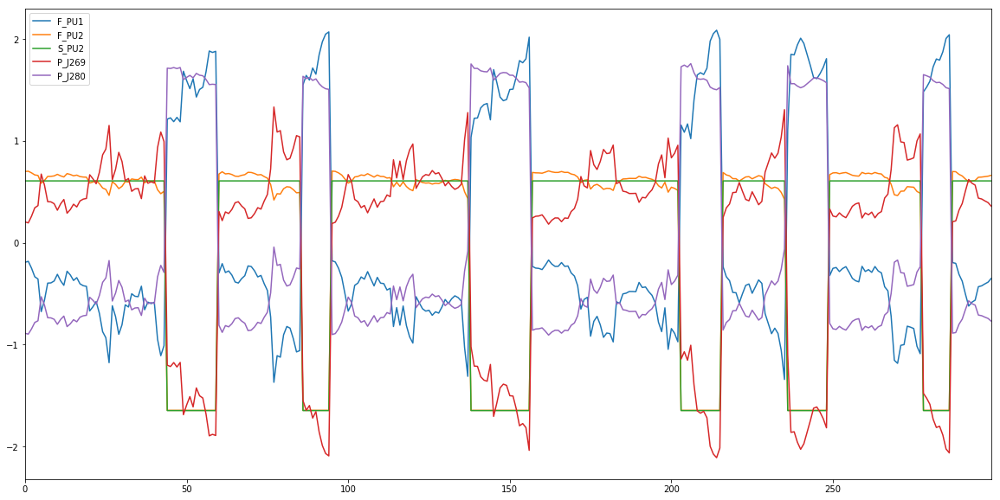

most correlated items of P_J269 are :
[['F_PU1', -0.9999450056781389], ['F_PU2', 0.9503465995699732], ['S_PU2', 0.9628774143822163], ['P_J280', -0.9090545503316122]]


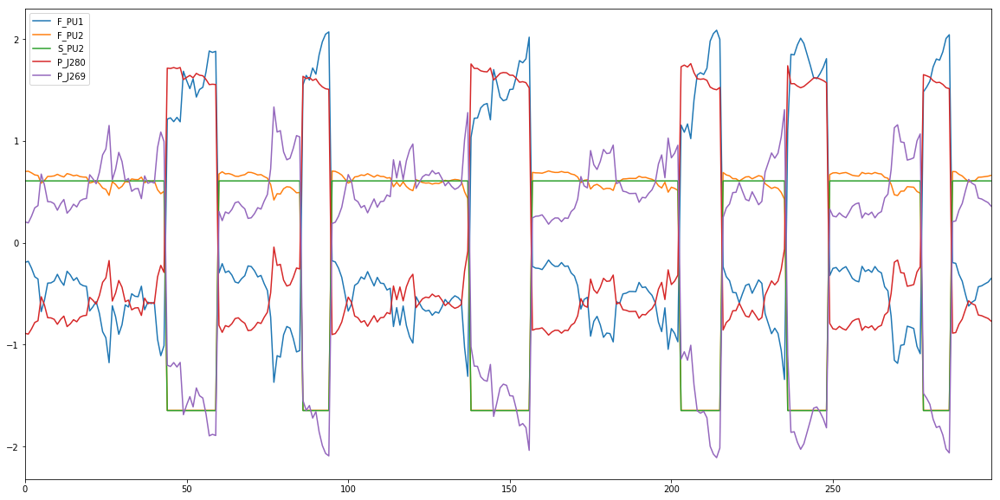

most correlated items of P_J300 are :
[['P_J289', 0.9998580006335386], ['P_J422', 0.9957163122710345]]


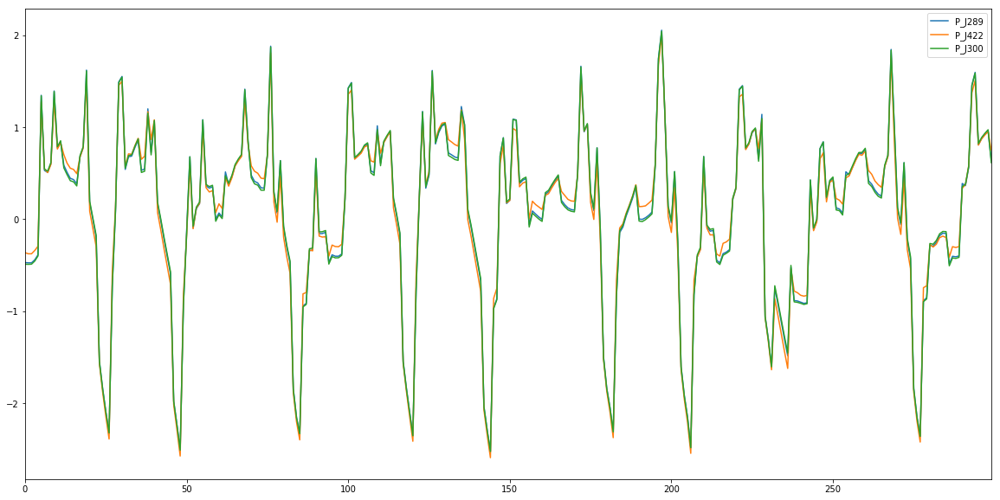

most correlated items of P_J256 are :
[['F_PU4', 0.9559029678342637], ['S_PU4', 0.9589243761429387]]


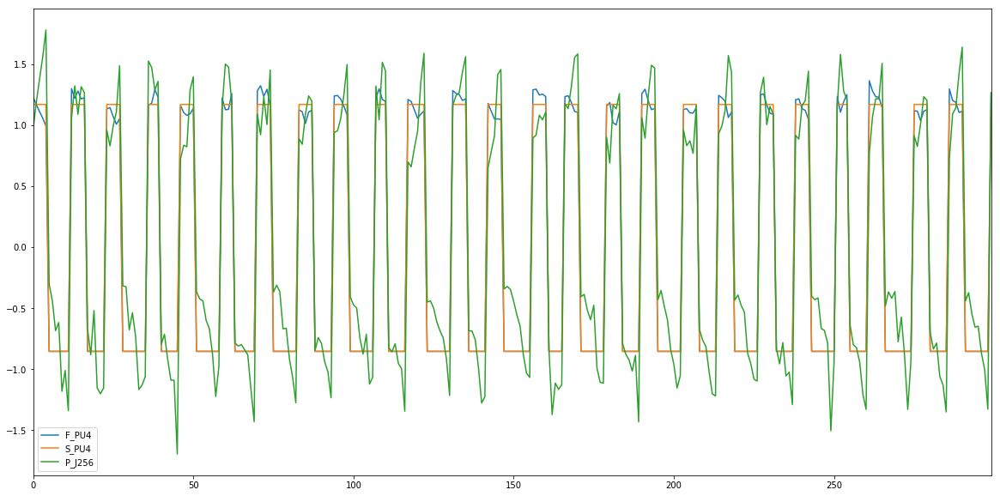

most correlated items of P_J289 are :
[['P_J300', 0.9998580006335386], ['P_J422', 0.9965599265013624]]


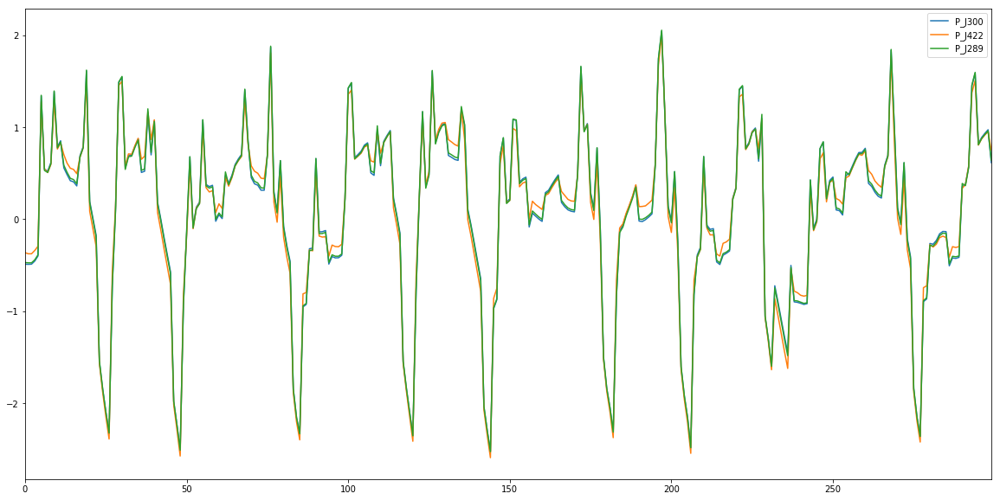

most correlated items of P_J415 are :
[['F_PU7', 0.9540431021378241], ['S_PU7', 0.9607072032273162]]


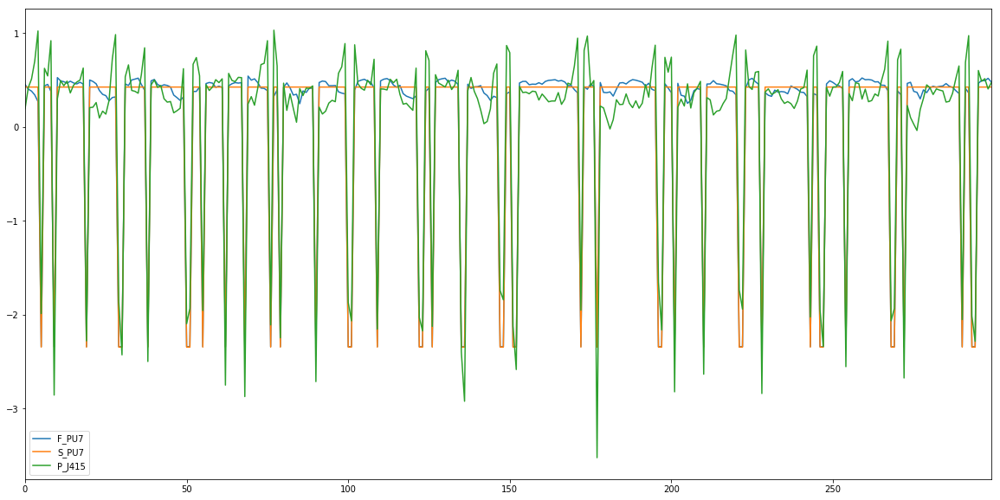

most correlated items of P_J302 are :
[['F_PU8', -0.8066423341688314], ['S_PU8', -0.8237641245152676], ['P_J306', -0.7634029635219715], ['P_J307', 0.9999621199875782]]


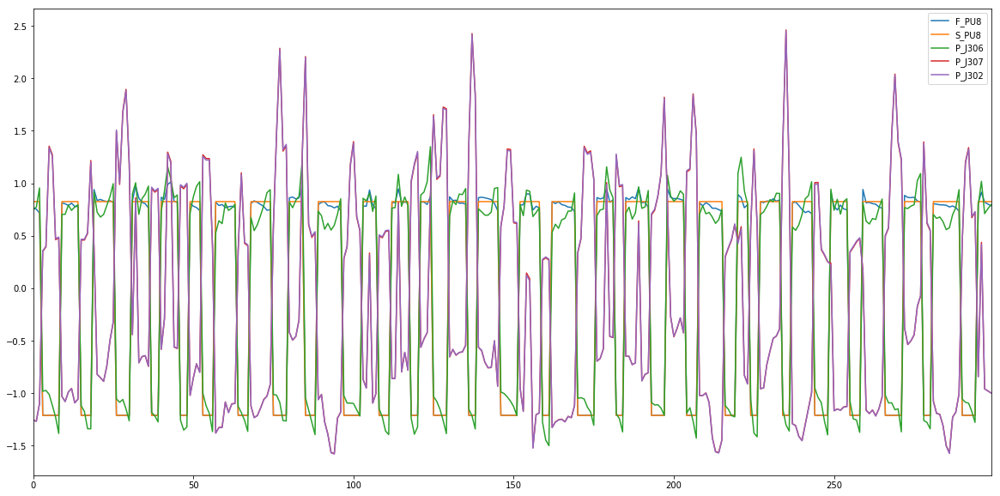

most correlated items of P_J306 are :
[['F_PU8', 0.9904838309260136], ['S_PU8', 0.9894258484203827], ['P_J302', -0.7634029635219715], ['P_J307', -0.7600288189255437]]


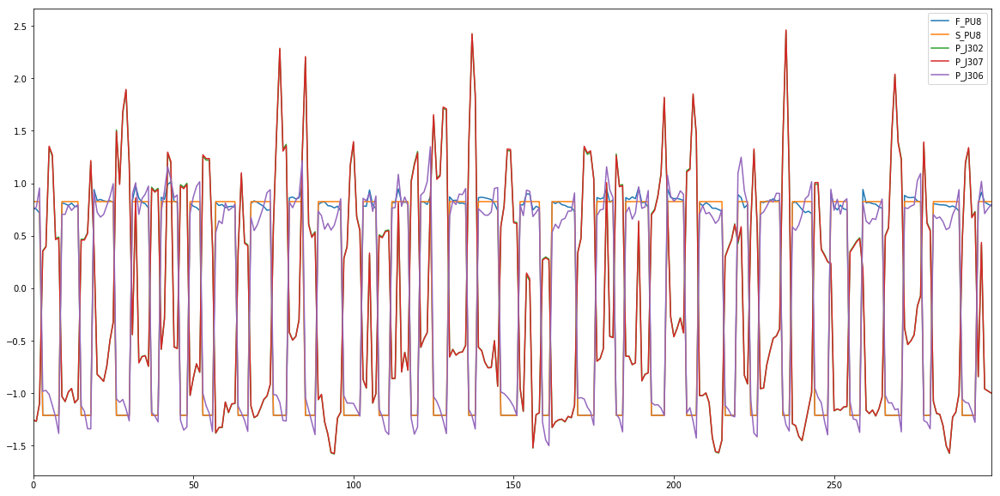

most correlated items of P_J307 are :
[['F_PU8', -0.8035963027831527], ['S_PU8', -0.8208046863264209], ['P_J302', 0.9999621199875782], ['P_J306', -0.7600288189255437]]


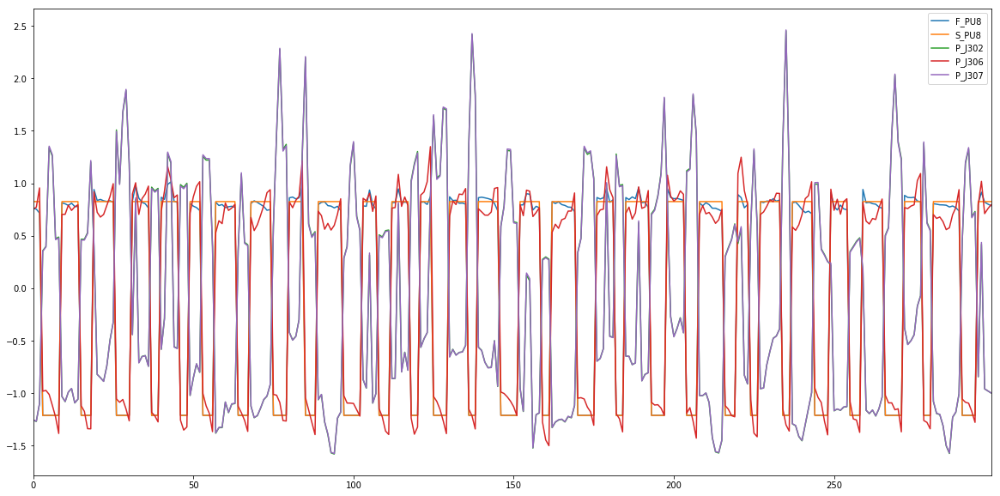

most correlated items of P_J317 are :
[['F_PU10', 0.8477355048749448], ['S_PU10', 0.8618425210153933]]


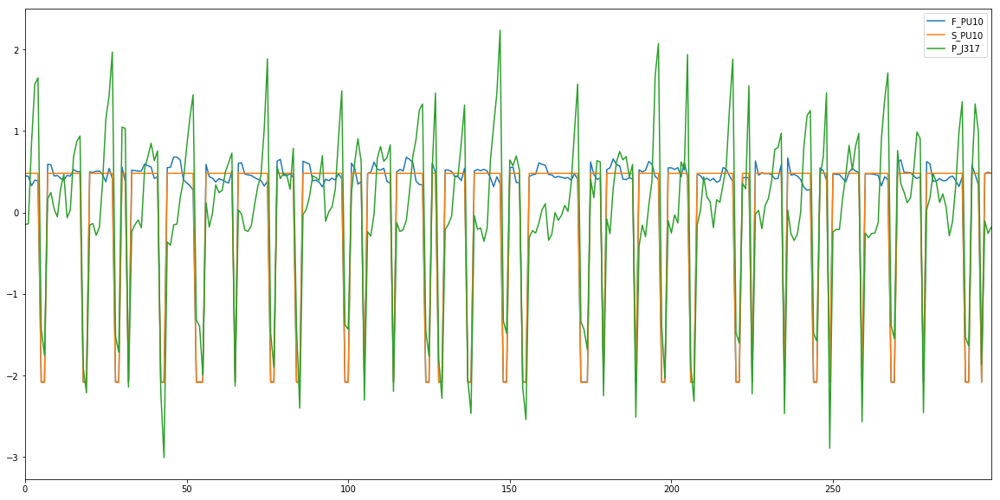

most correlated items of P_J14 are :
[['F_V2', -0.9272660136287085], ['S_V2', -0.9196422712371278]]


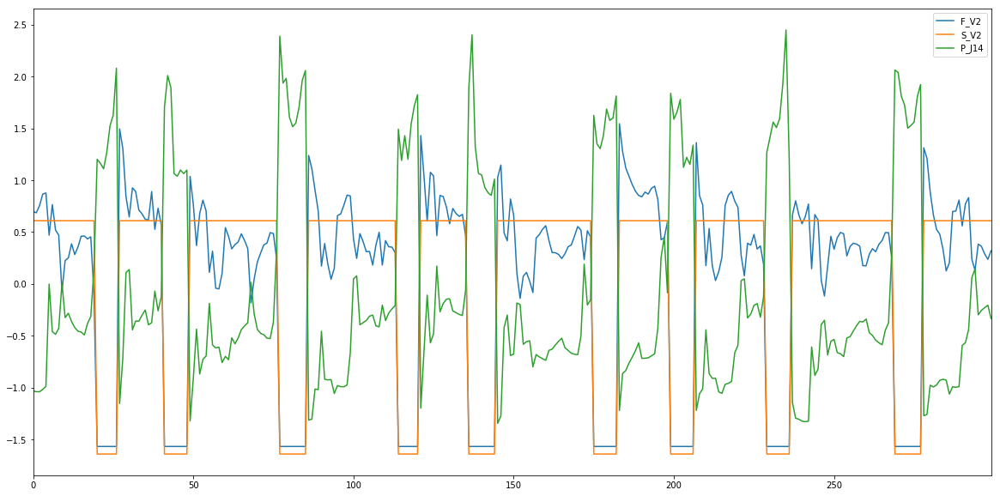

most correlated items of P_J422 are :
[['P_J300', 0.9957163122710345], ['P_J289', 0.9965599265013624]]


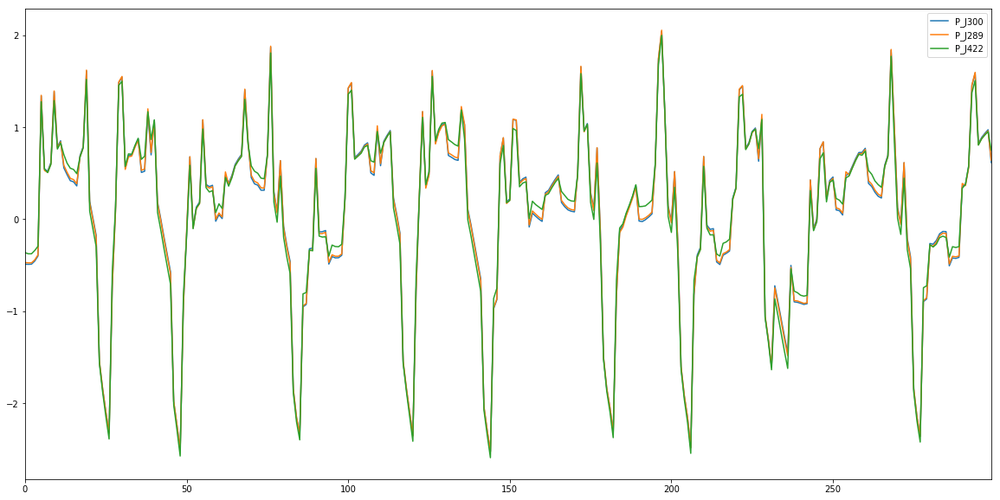

most correlated items of ATT_FLAG are :
[['L_T1', nan]]


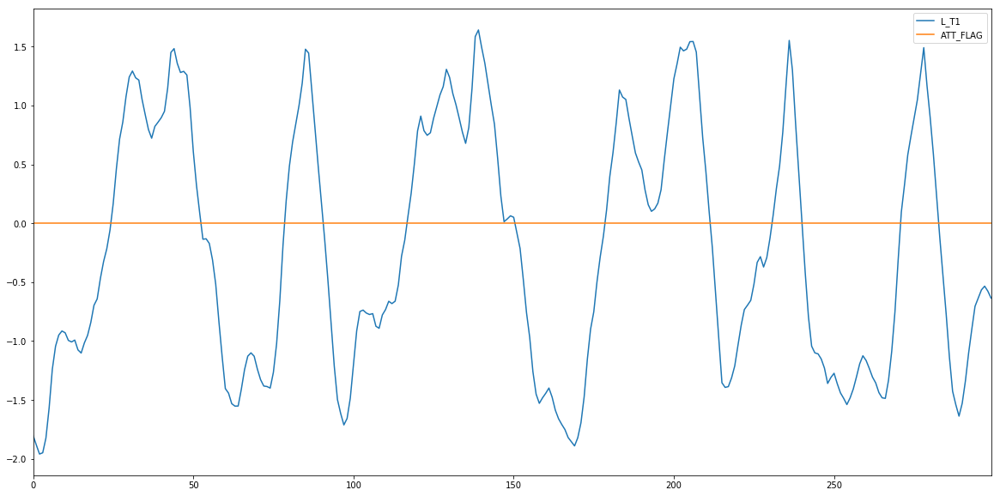

In [12]:
#calclate correlation
def correlationCal(signal):
    correlation=signal.corr()
    for i in correlation.columns.tolist():
        list=correlation.columns.tolist()
        list.remove(i)
        tmp=[abs(x) for x in (correlation[i].tolist())]
        del tmp[correlation.columns.tolist().index(i)]
        tmp2=(correlation[i].tolist())
        del tmp2[correlation.columns.tolist().index(i)]
        correlatedCol=[]
        for j in range(len(list)):
            if tmp[j]>0.7:
                correlatedCol.append([list[j],tmp2[j]])
        if len(correlatedCol)==0:
            index=tmp.index(max(tmp))
            correlatedCol.append([list[index],tmp2[index]])
        print(f'most correlated items of {i} are :')
        print(correlatedCol)
        #plots of correlated signals
        for j in correlatedCol:
            signal[j[0]][0:300].plot(figsize=(20,10))
        signal[i][0:300].plot(figsize=(20,10))
        plt.legend()
        plt.show()
    return

correlationCal(normalized_1)

most correlated items of L_T1 are :
[['S_V2', -0.45734002309775795]]


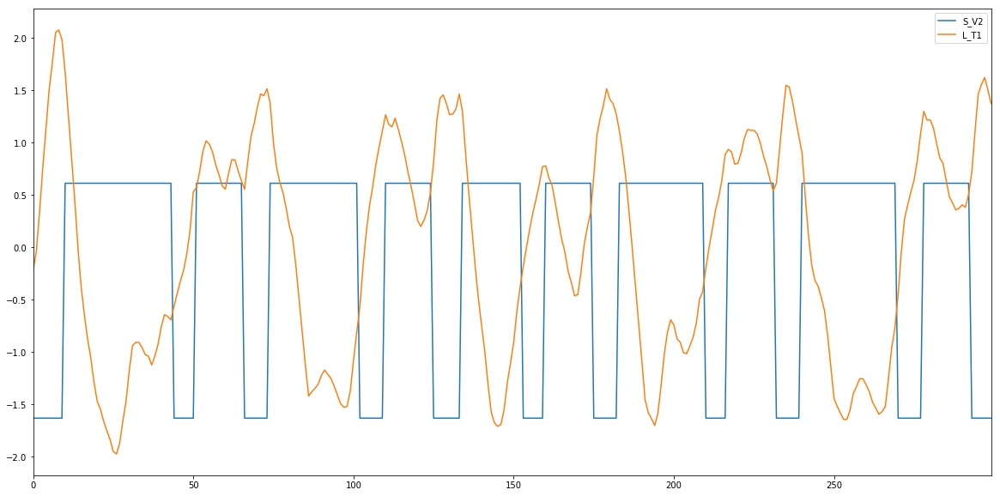

most correlated items of L_T2 are :
[['P_J289', 0.5959411473234164]]


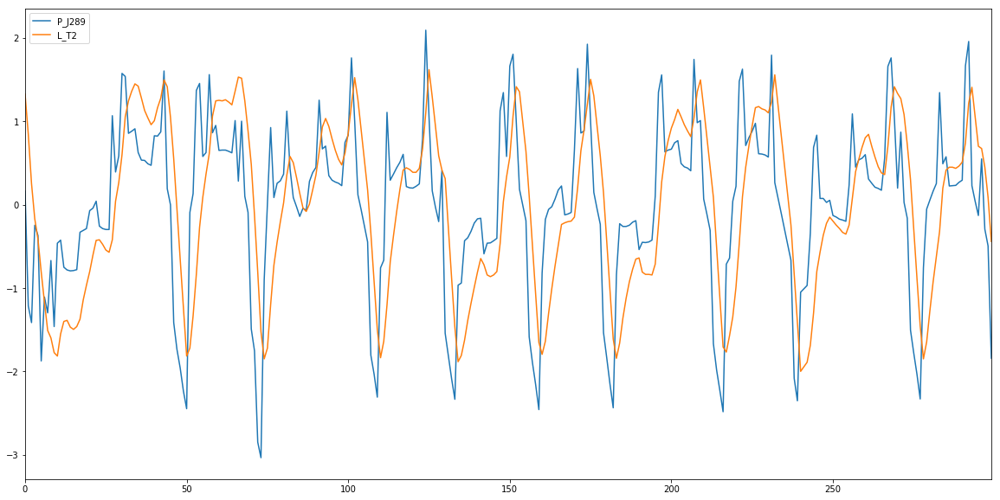

most correlated items of L_T3 are :
[['F_PU8', -0.3710803414078007]]


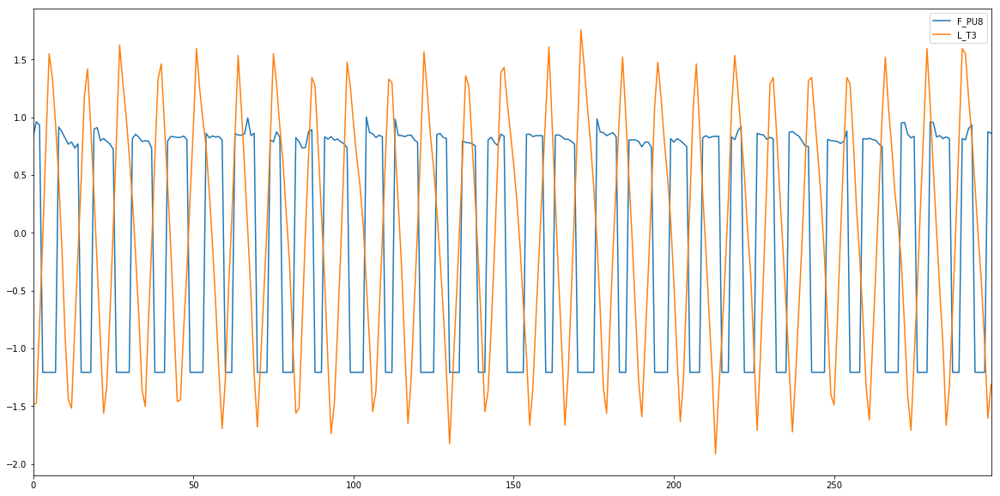

most correlated items of L_T4 are :
[['P_J300', 0.22068452866397578]]


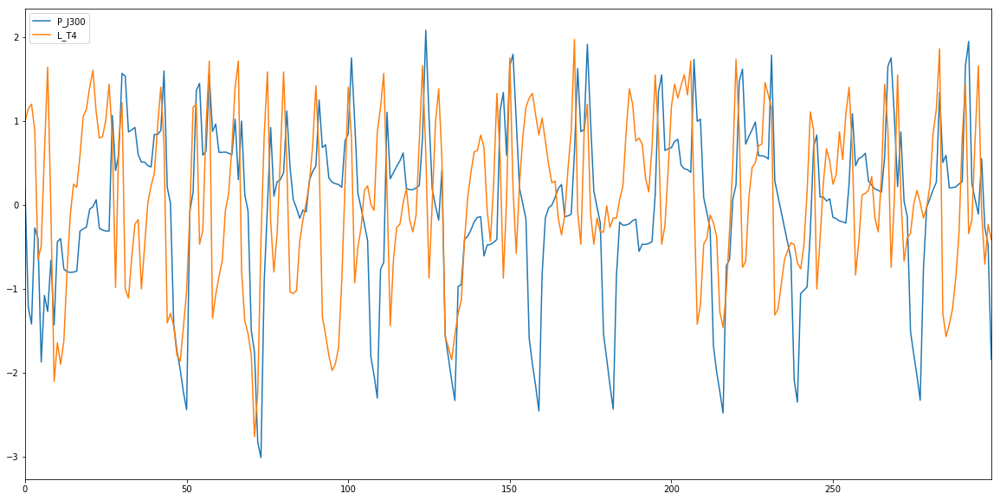

most correlated items of L_T5 are :
[['P_J256', 0.27571336800434965]]


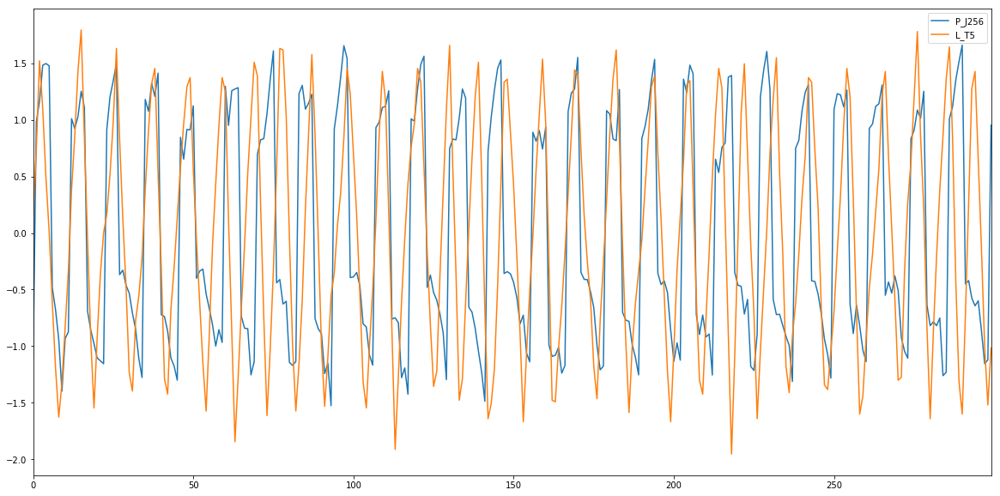

most correlated items of L_T6 are :
[['L_T7', 0.4898662586808593]]


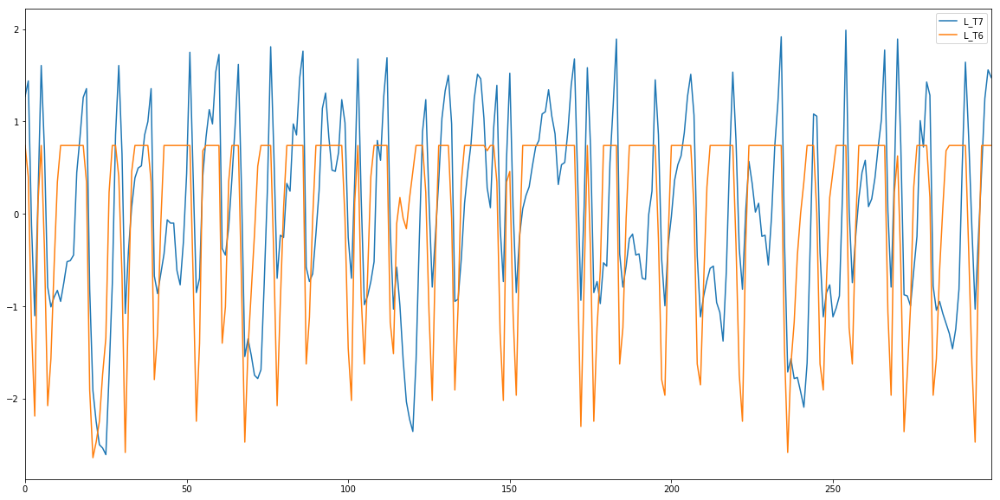

most correlated items of L_T7 are :
[['L_T6', 0.4898662586808593]]


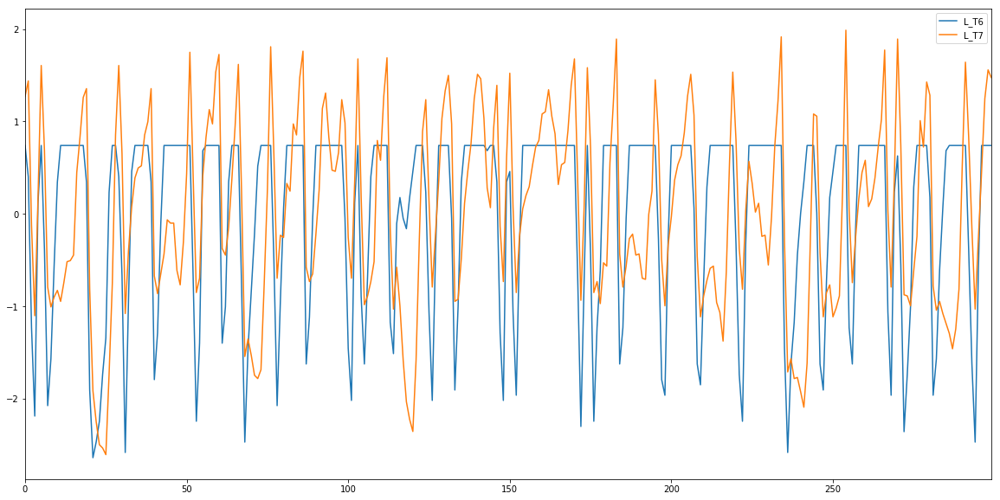

most correlated items of F_PU1 are :
[['F_PU2', -0.939660151799139], ['S_PU2', -0.9560291927378436], ['P_J269', -0.9998364405765486]]


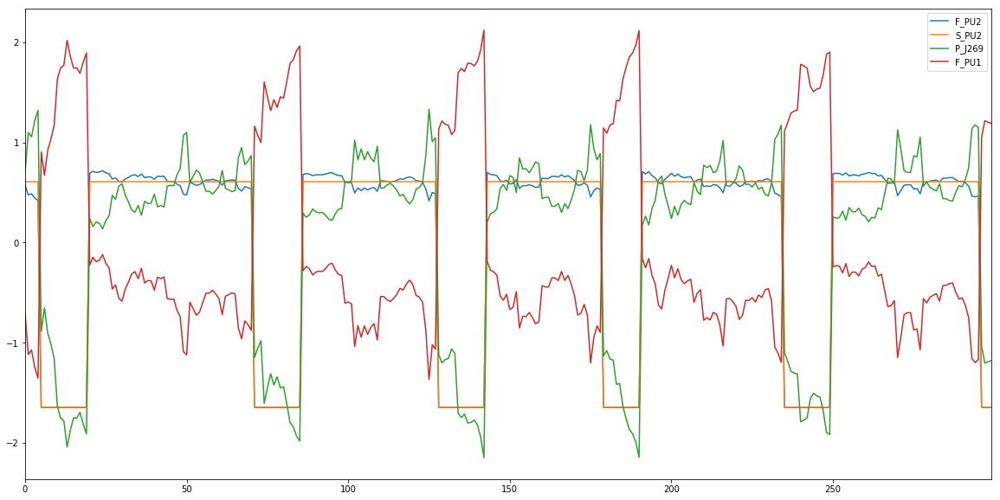

most correlated items of S_PU1 are :
[['L_T1', nan]]


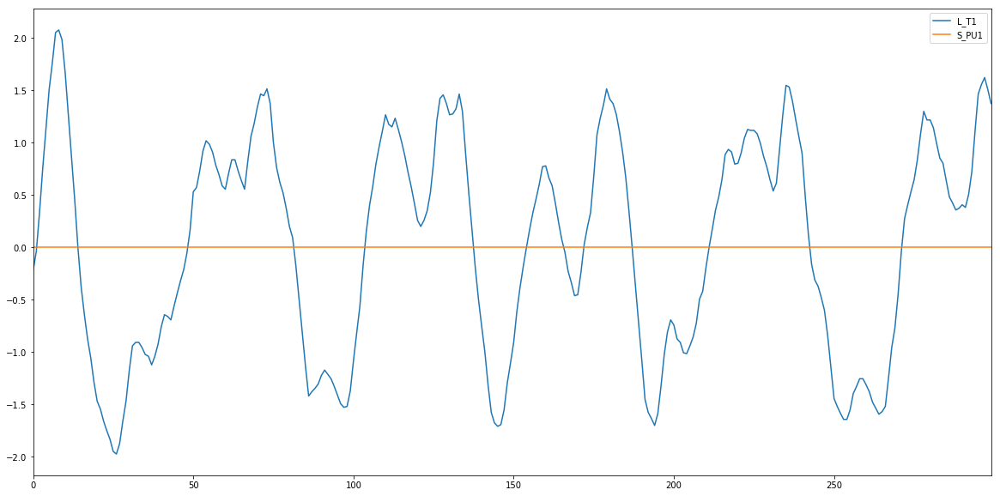

most correlated items of F_PU2 are :
[['F_PU1', -0.939660151799139], ['S_PU2', 0.9982213136182861], ['P_J280', -0.8355521075905824], ['P_J269', 0.9428040085185408]]


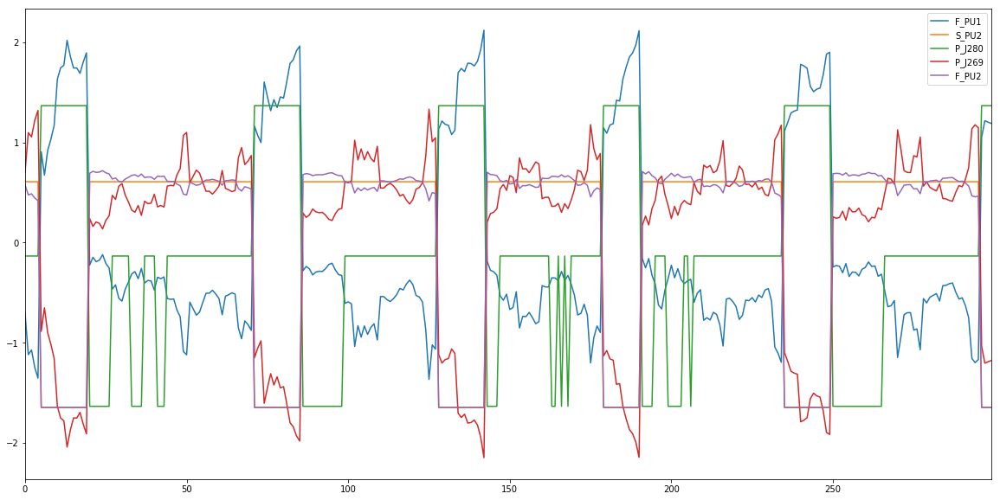

most correlated items of S_PU2 are :
[['F_PU1', -0.9560291927378436], ['F_PU2', 0.9982213136182861], ['P_J280', -0.8165336829311962], ['P_J269', 0.9583586485972152]]


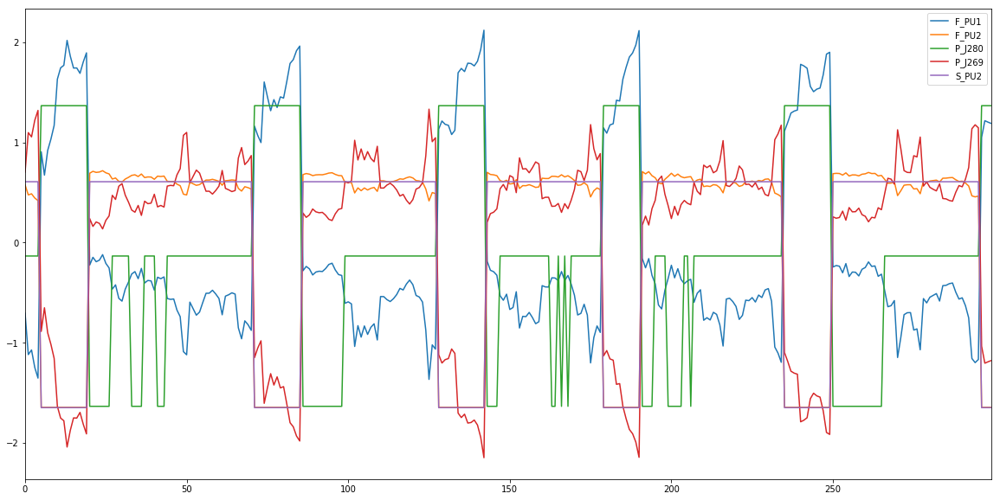

most correlated items of F_PU3 are :
[['L_T1', nan]]


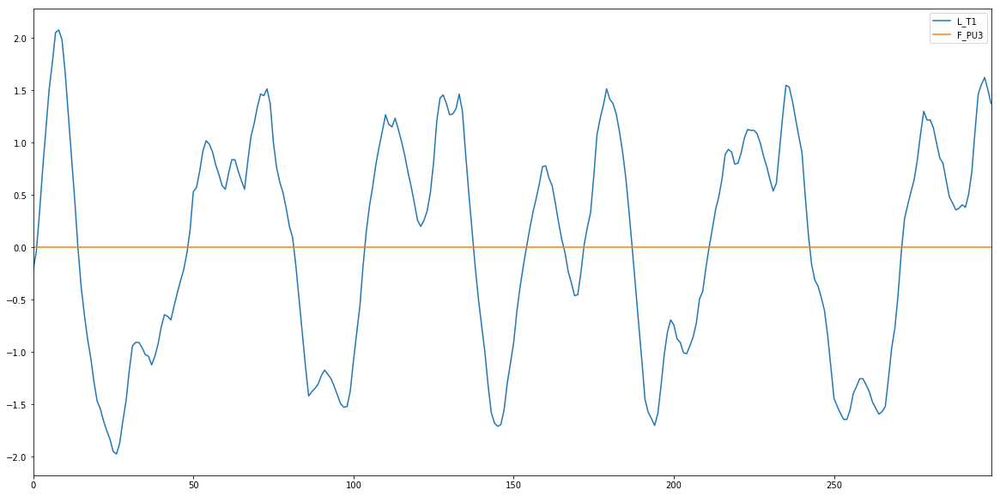

most correlated items of S_PU3 are :
[['L_T1', nan]]


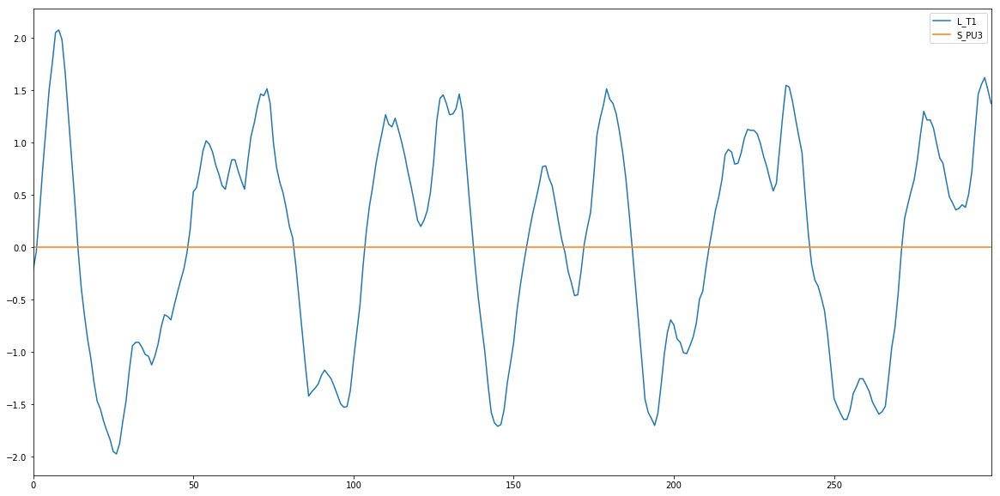

most correlated items of F_PU4 are :
[['S_PU4', 0.9987019246250315], ['P_J256', 0.9564888645702558]]


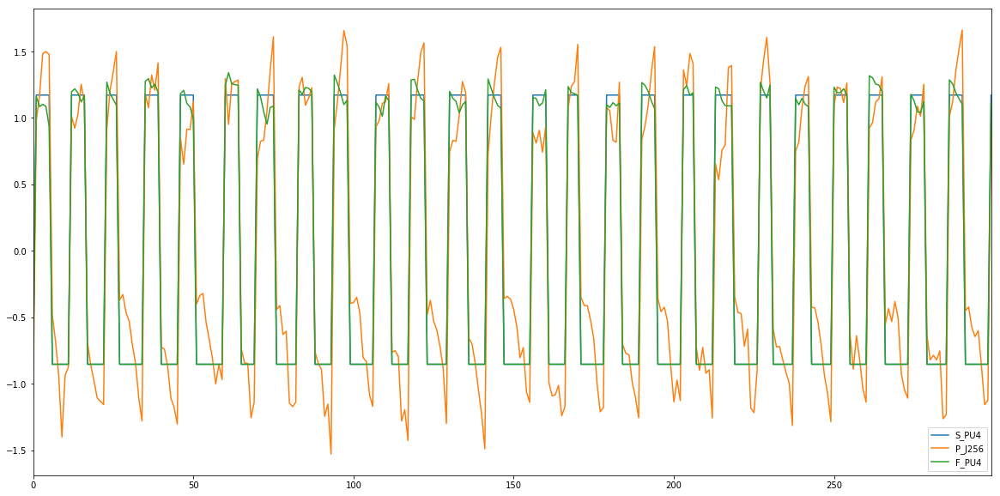

most correlated items of S_PU4 are :
[['F_PU4', 0.9987019246250315], ['P_J256', 0.9593294488636337]]


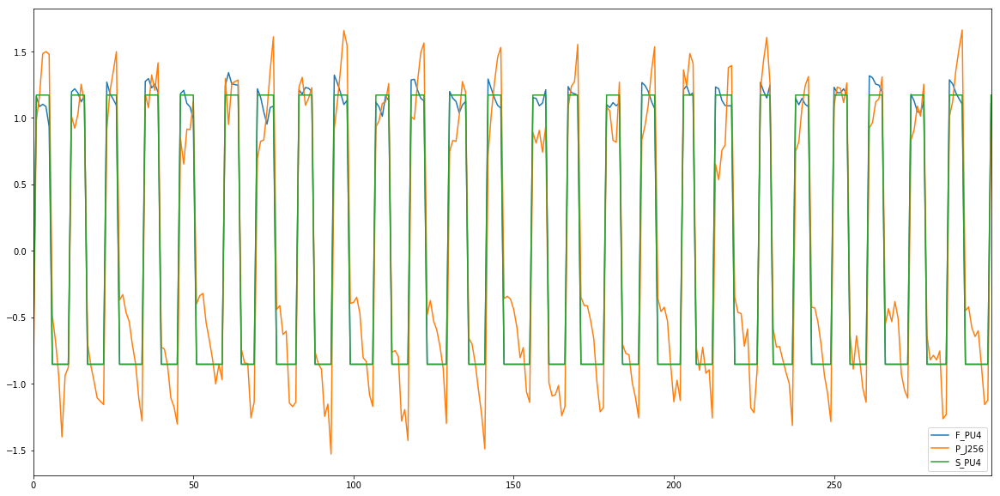

most correlated items of F_PU5 are :
[['L_T1', nan]]


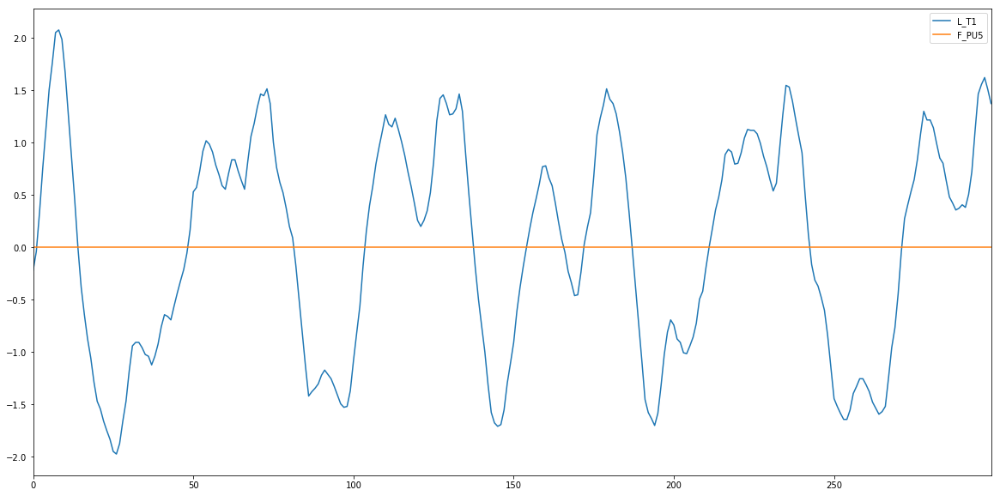

most correlated items of S_PU5 are :
[['L_T1', nan]]


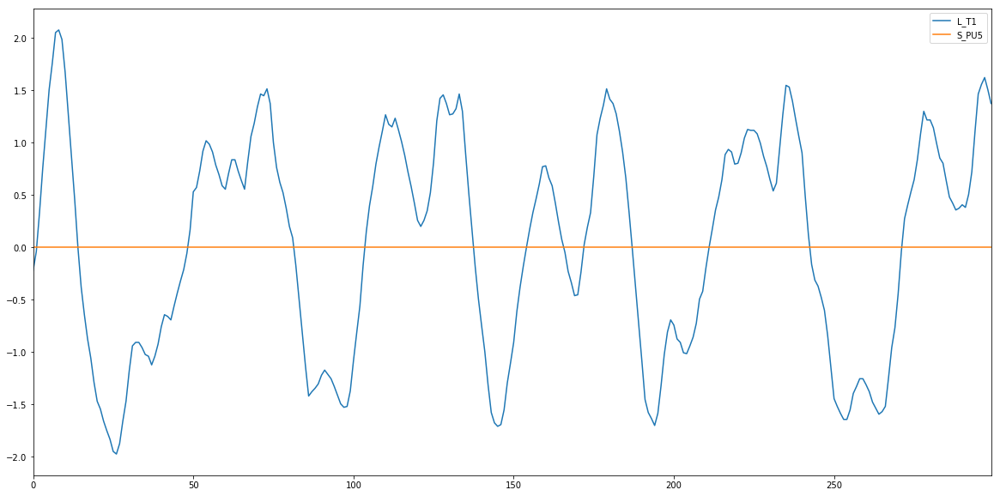

most correlated items of F_PU6 are :
[['S_PU6', 0.9955185315038974]]


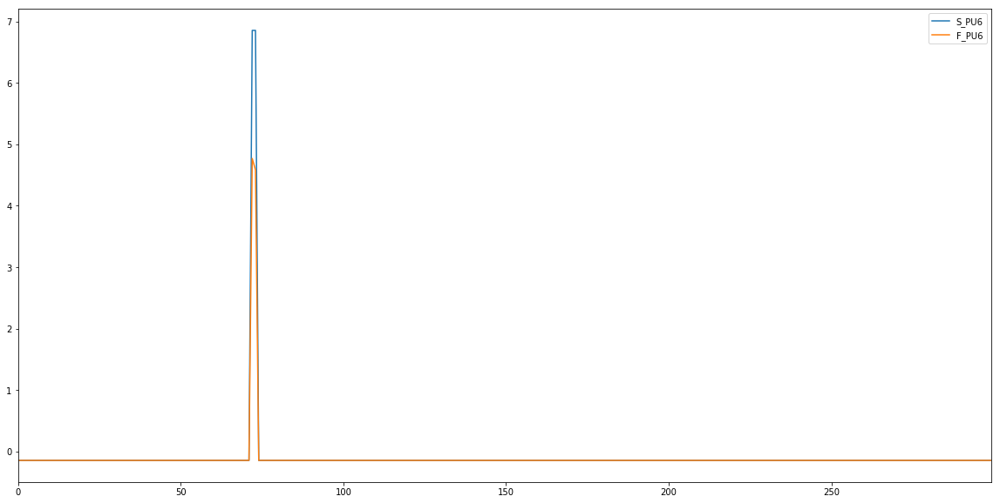

most correlated items of S_PU6 are :
[['F_PU6', 0.9955185315038974]]


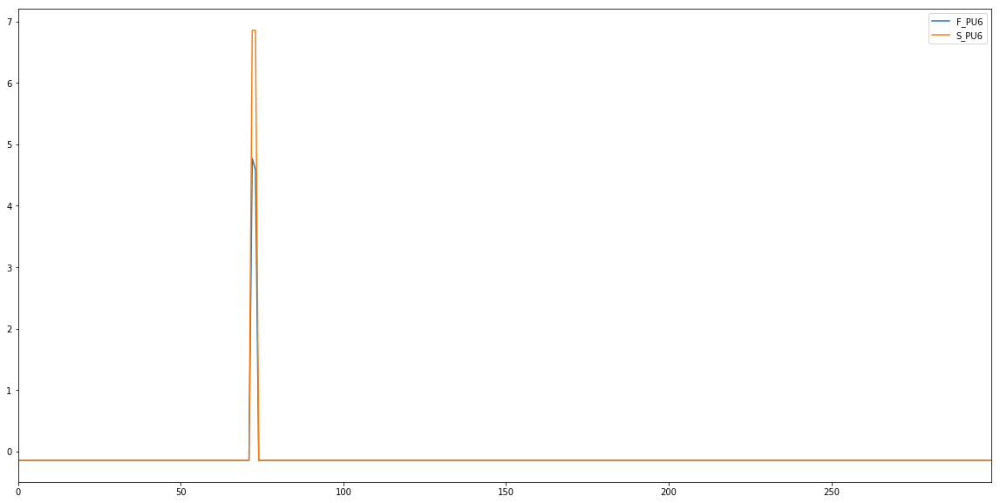

most correlated items of F_PU7 are :
[['S_PU7', 0.9880365991588885], ['P_J415', 0.8691051423332221]]


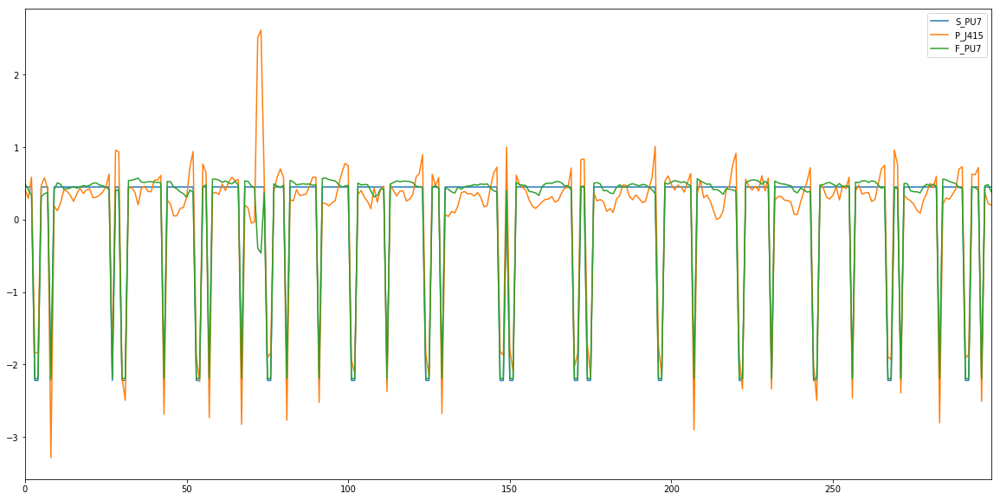

most correlated items of S_PU7 are :
[['F_PU7', 0.9880365991588885], ['P_J415', 0.8797930030881316]]


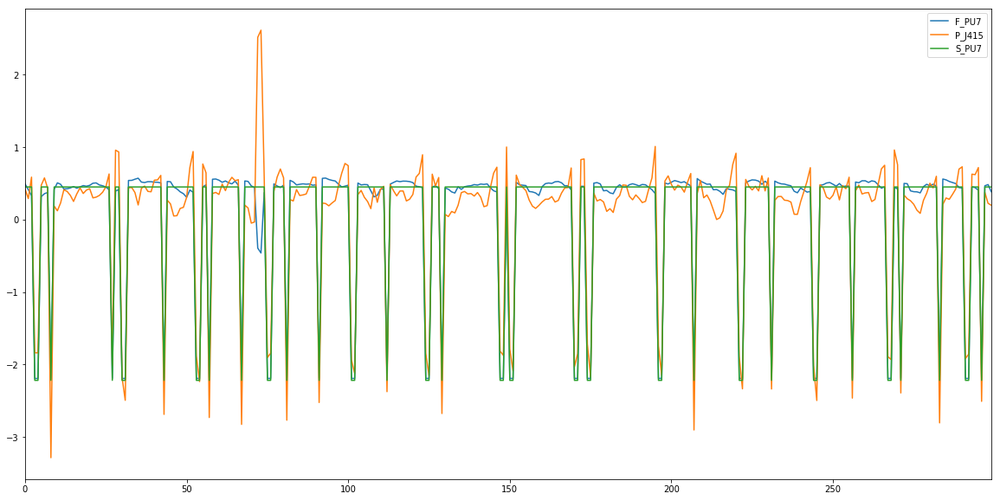

most correlated items of F_PU8 are :
[['S_PU8', 0.9989455043583498], ['P_J302', -0.7576307168617853], ['P_J306', 0.9901499050323473], ['P_J307', -0.754967204473588]]


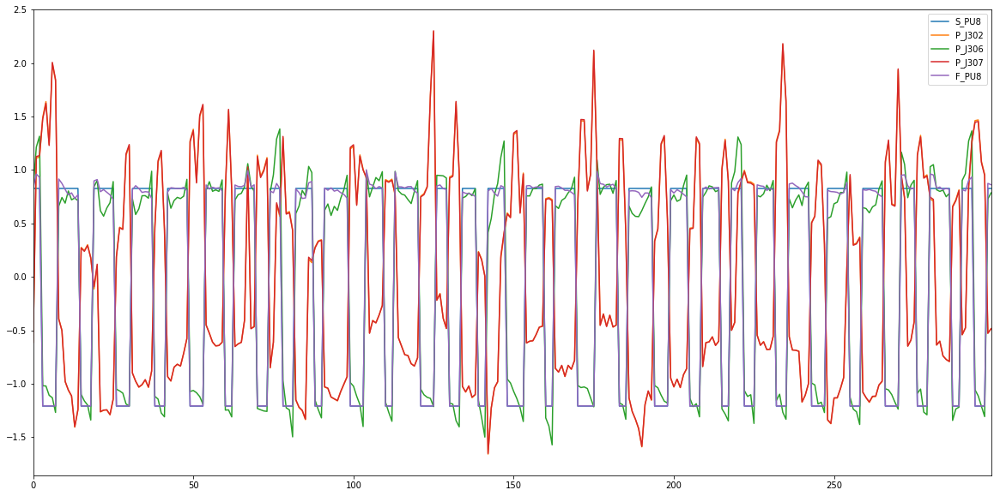

most correlated items of S_PU8 are :
[['F_PU8', 0.9989455043583498], ['P_J302', -0.7786013024881203], ['P_J306', 0.9883714242901054], ['P_J307', -0.7760181715144648]]


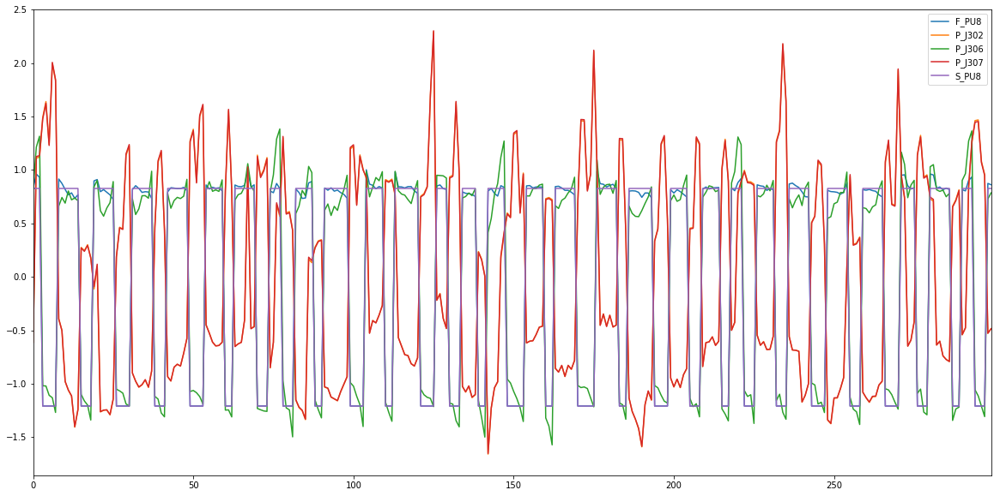

most correlated items of F_PU9 are :
[['L_T1', nan]]


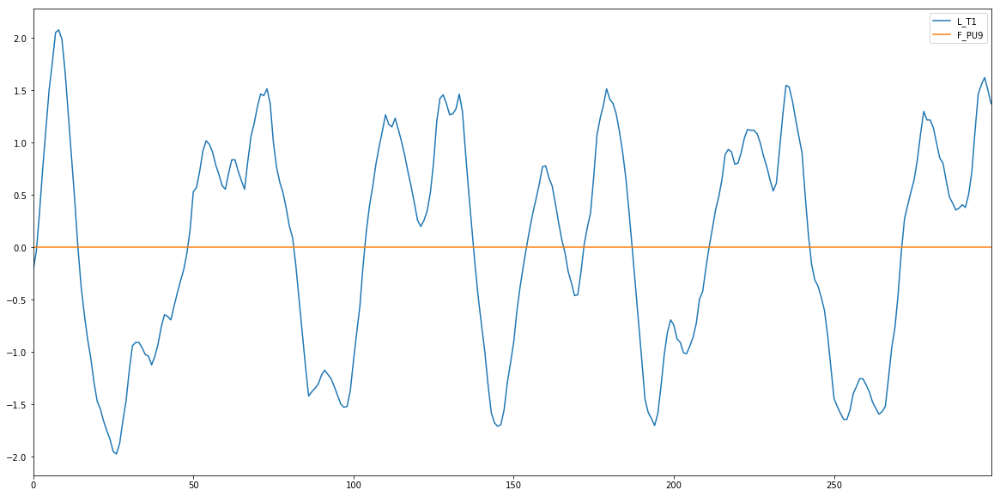

most correlated items of S_PU9 are :
[['L_T1', nan]]


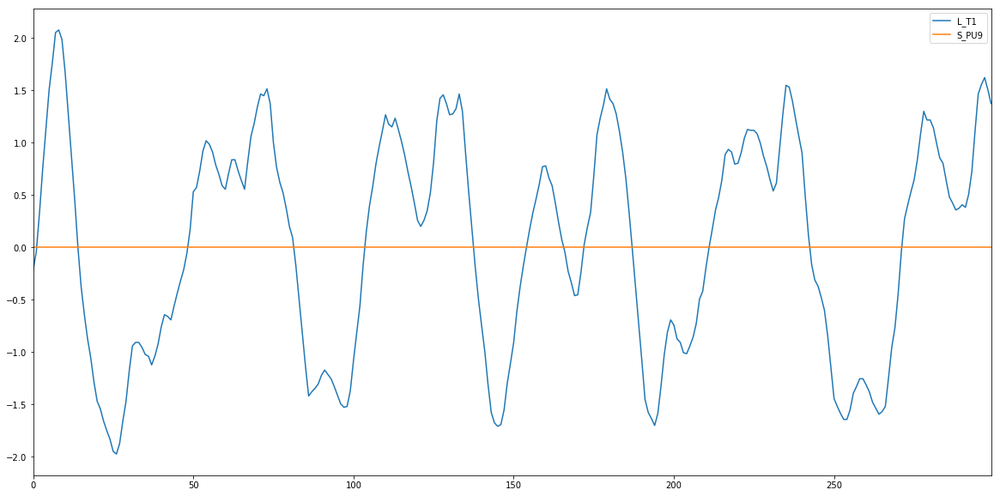

most correlated items of F_PU10 are :
[['S_PU10', 0.9958516228226145], ['P_J317', 0.8069120925014632]]


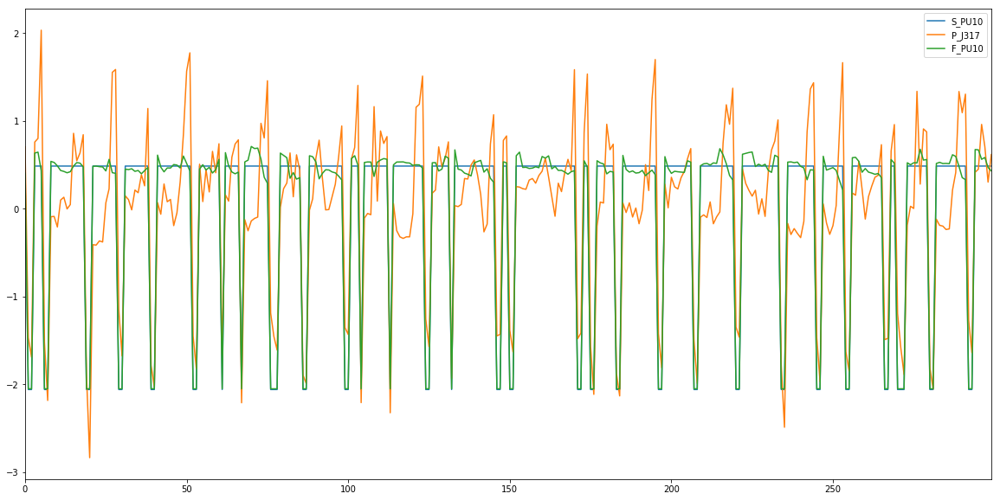

most correlated items of S_PU10 are :
[['F_PU10', 0.9958516228226145], ['P_J317', 0.8279309490542005]]


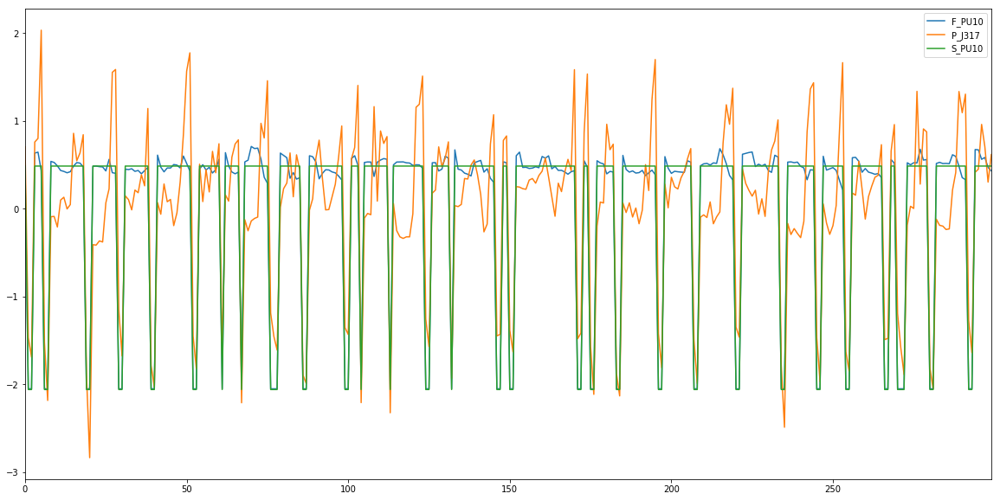

most correlated items of F_PU11 are :
[['S_PU11', 0.9984503523618022]]


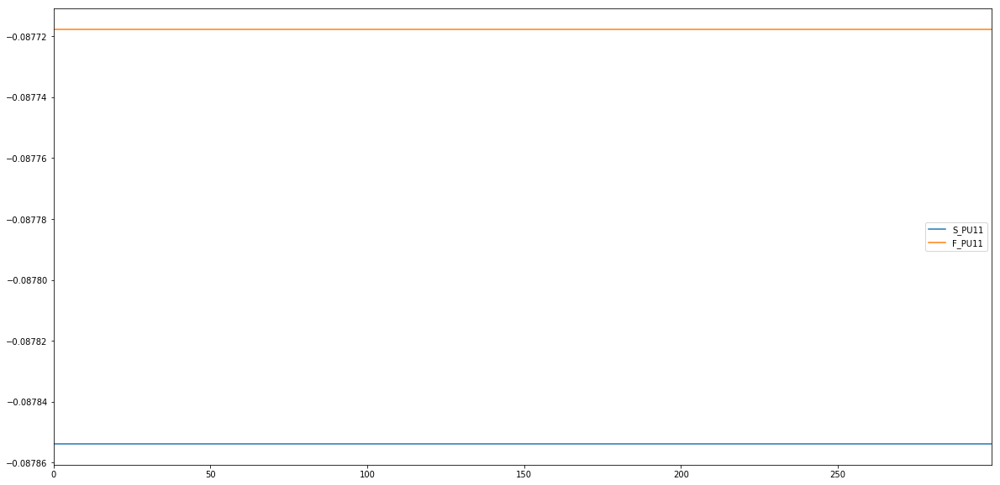

most correlated items of S_PU11 are :
[['F_PU11', 0.9984503523618022]]


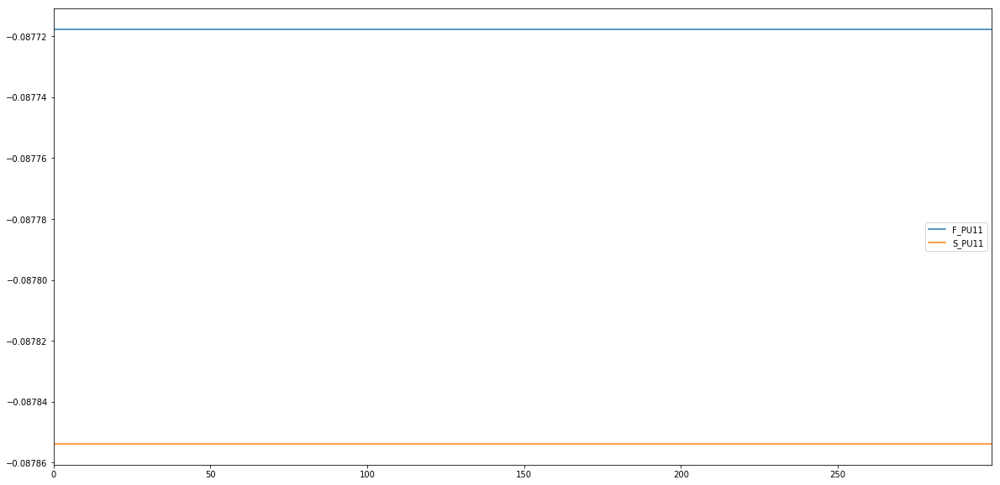

most correlated items of F_V2 are :
[['S_V2', 0.9545539000730489], ['P_J14', -0.8894203882584759]]


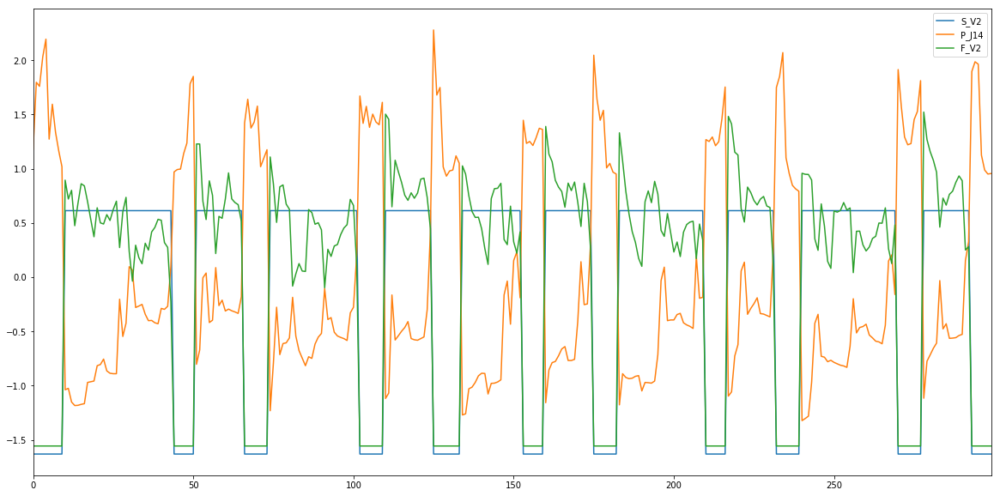

most correlated items of S_V2 are :
[['F_V2', 0.9545539000730489], ['P_J14', -0.8866279765675166]]


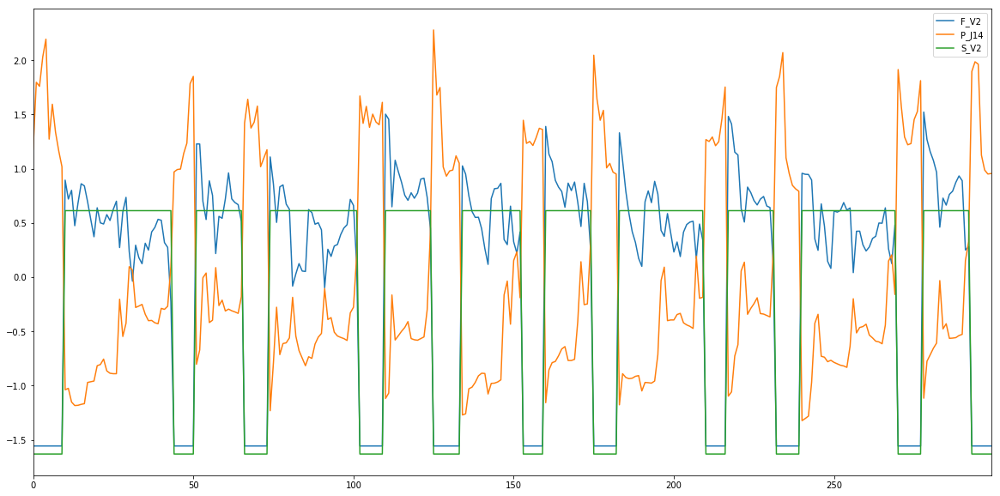

most correlated items of P_J280 are :
[['F_PU2', -0.8355521075905824], ['S_PU2', -0.8165336829311962], ['P_J269', -0.7008964188408457]]


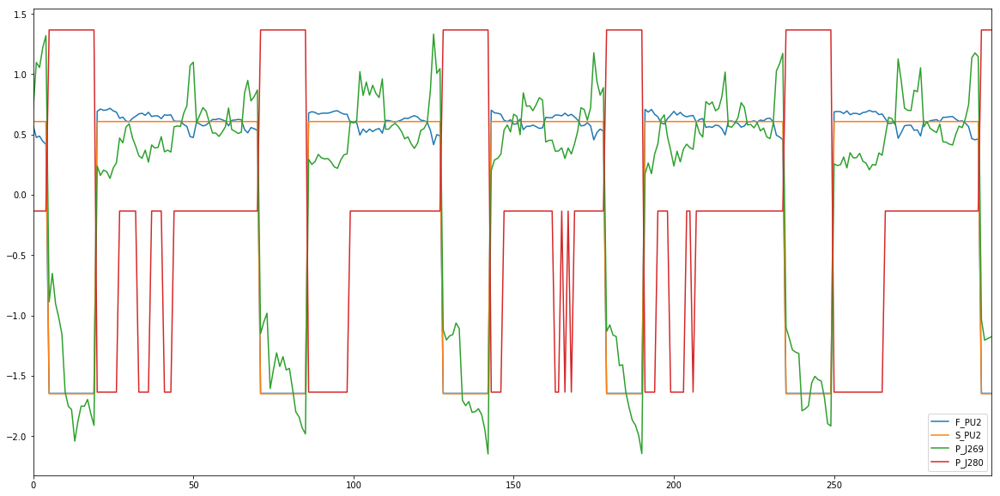

most correlated items of P_J269 are :
[['F_PU1', -0.9998364405765486], ['F_PU2', 0.9428040085185408], ['S_PU2', 0.9583586485972152], ['P_J280', -0.7008964188408457]]


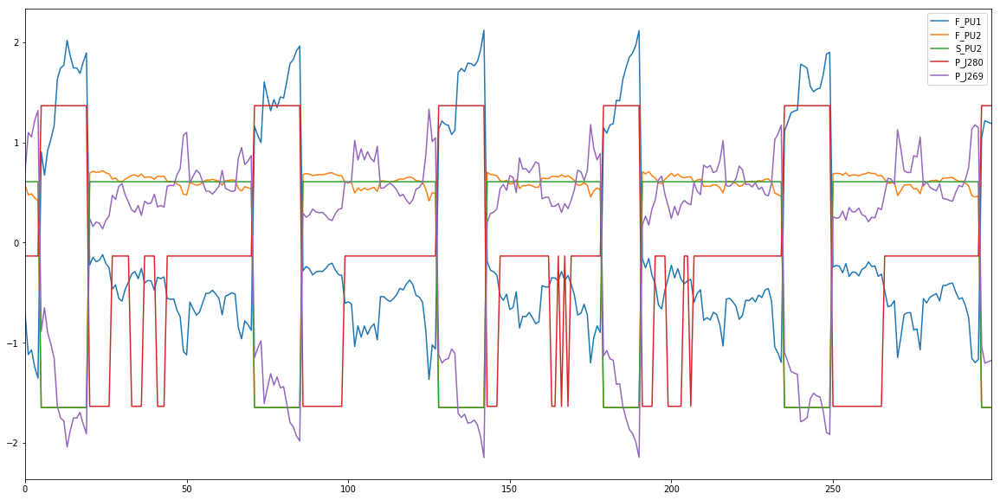

most correlated items of P_J300 are :
[['P_J289', 0.999857842541899], ['P_J422', 0.995842704980764]]


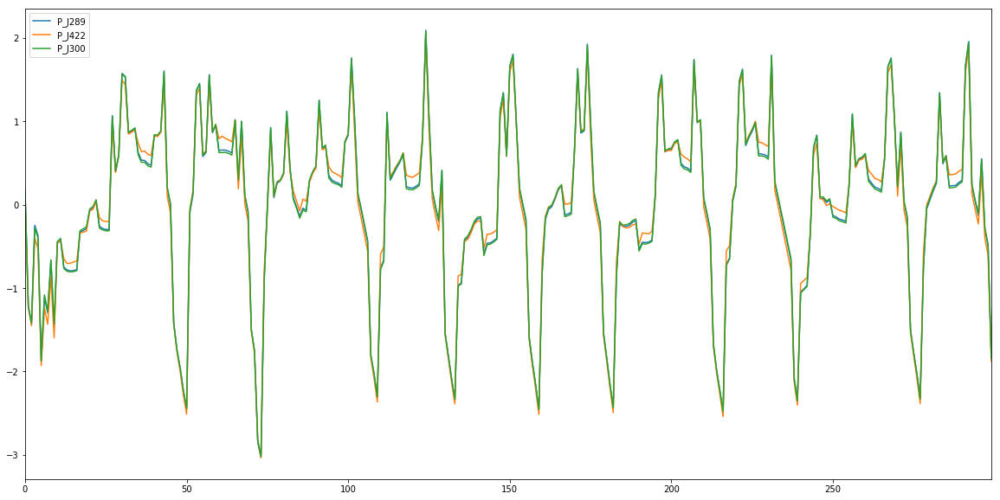

most correlated items of P_J256 are :
[['F_PU4', 0.9564888645702558], ['S_PU4', 0.9593294488636337]]


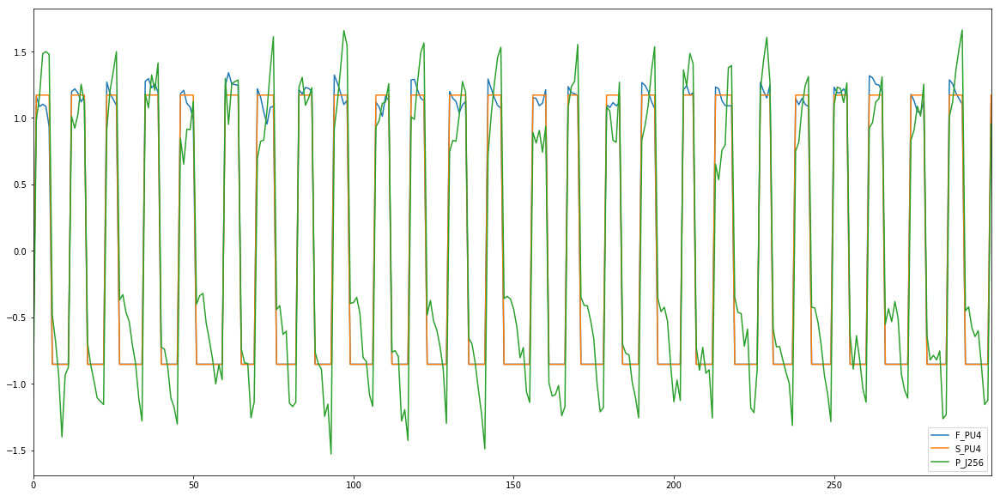

most correlated items of P_J289 are :
[['P_J300', 0.999857842541899], ['P_J422', 0.9966460039320828]]


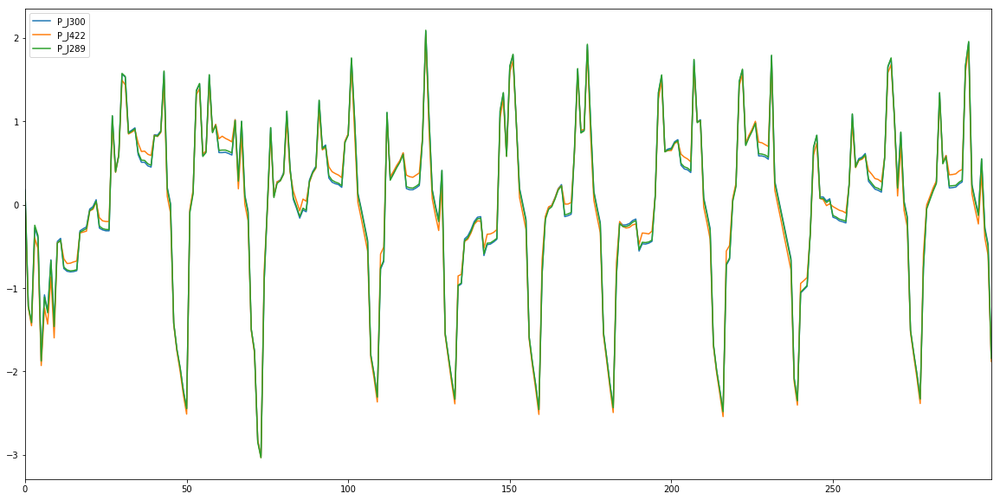

most correlated items of P_J415 are :
[['F_PU7', 0.8691051423332221], ['S_PU7', 0.8797930030881316]]


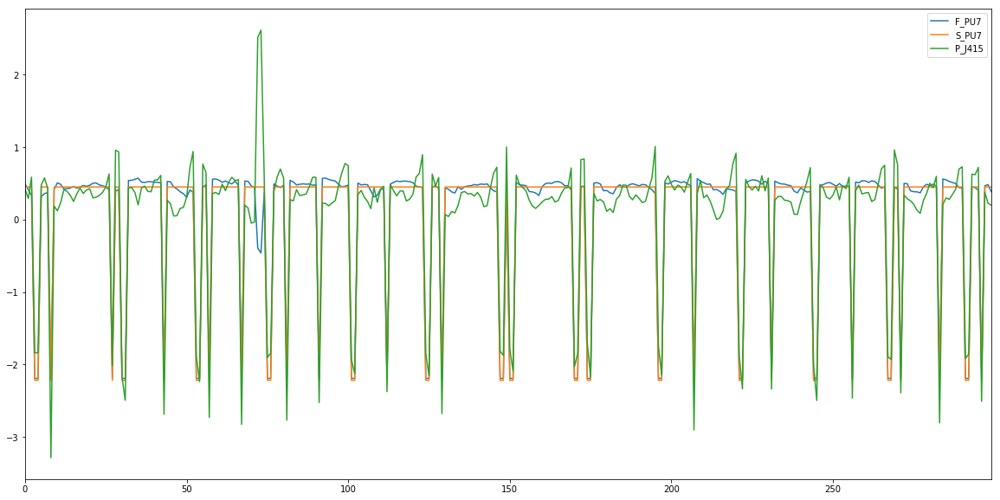

most correlated items of P_J302 are :
[['F_PU8', -0.7576307168617853], ['S_PU8', -0.7786013024881203], ['P_J306', -0.7104699388687378], ['P_J307', 0.9999591473251053]]


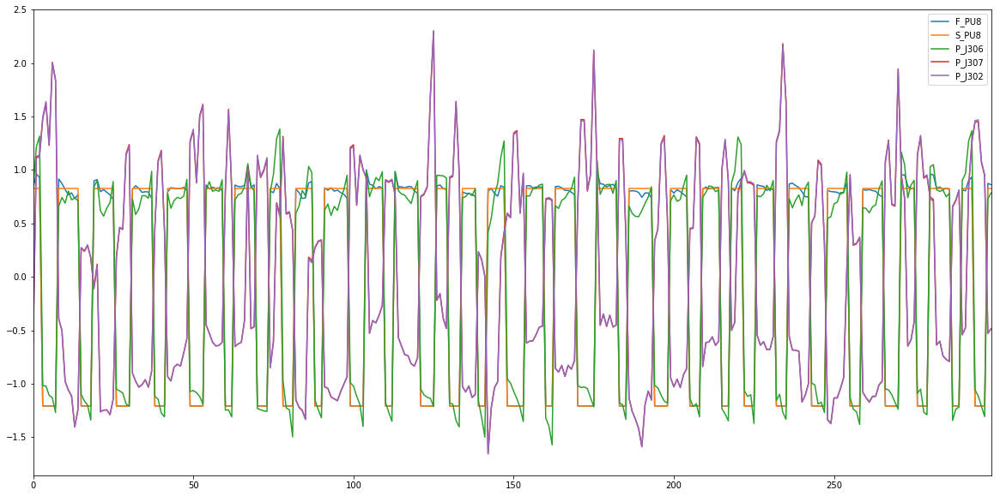

most correlated items of P_J306 are :
[['F_PU8', 0.9901499050323473], ['S_PU8', 0.9883714242901054], ['P_J302', -0.7104699388687378], ['P_J307', -0.7075129264236908]]


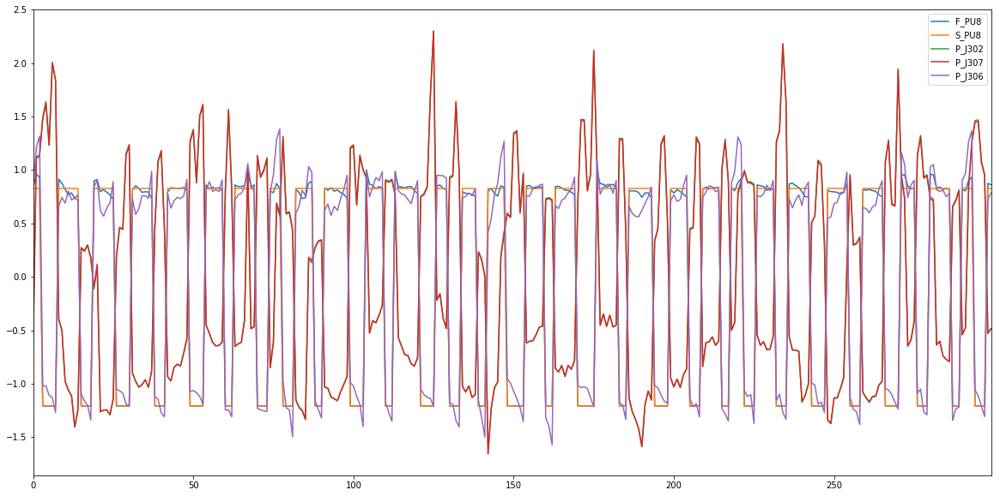

most correlated items of P_J307 are :
[['F_PU8', -0.754967204473588], ['S_PU8', -0.7760181715144648], ['P_J302', 0.9999591473251053], ['P_J306', -0.7075129264236908]]


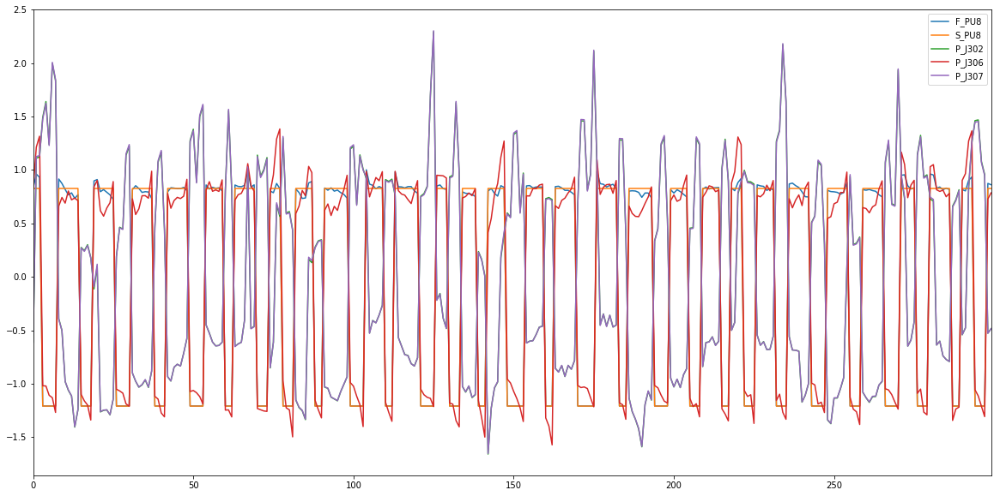

most correlated items of P_J317 are :
[['F_PU10', 0.8069120925014632], ['S_PU10', 0.8279309490542005]]


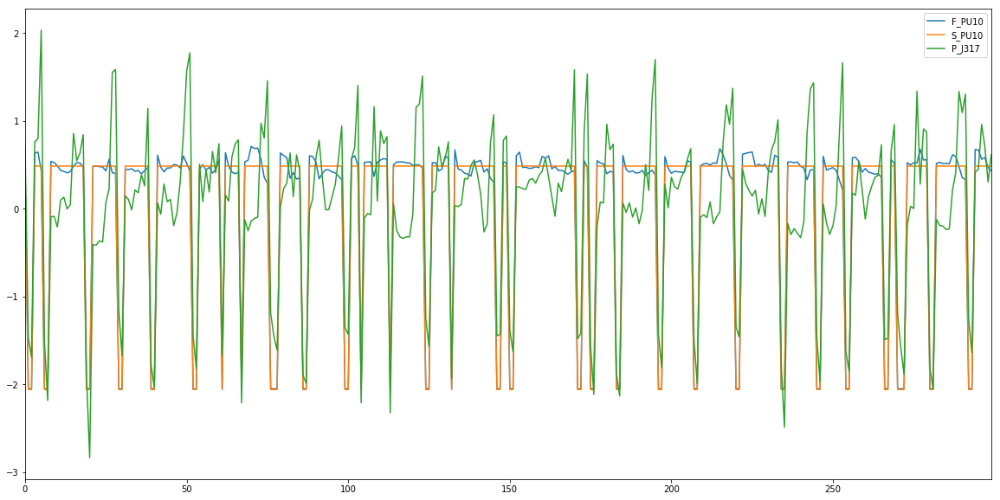

most correlated items of P_J14 are :
[['F_V2', -0.8894203882584759], ['S_V2', -0.8866279765675166]]


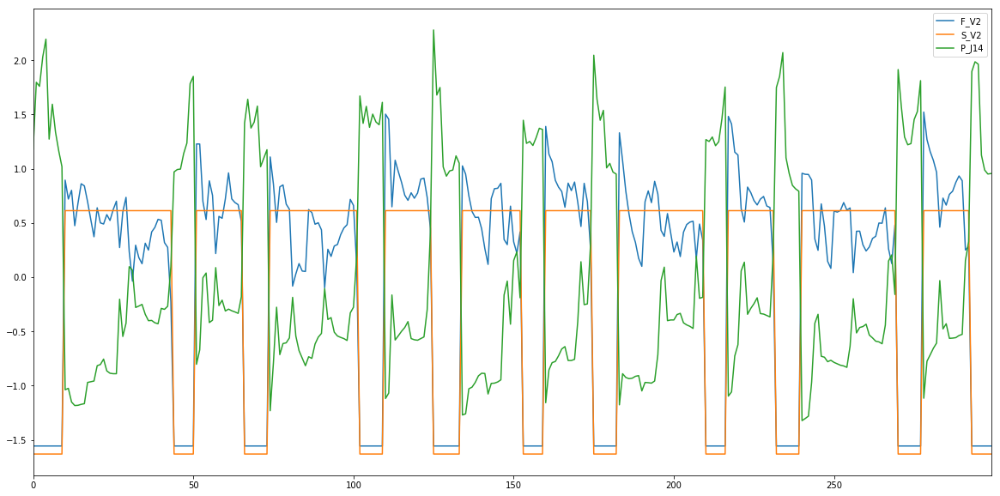

most correlated items of P_J422 are :
[['P_J300', 0.995842704980764], ['P_J289', 0.9966460039320828]]


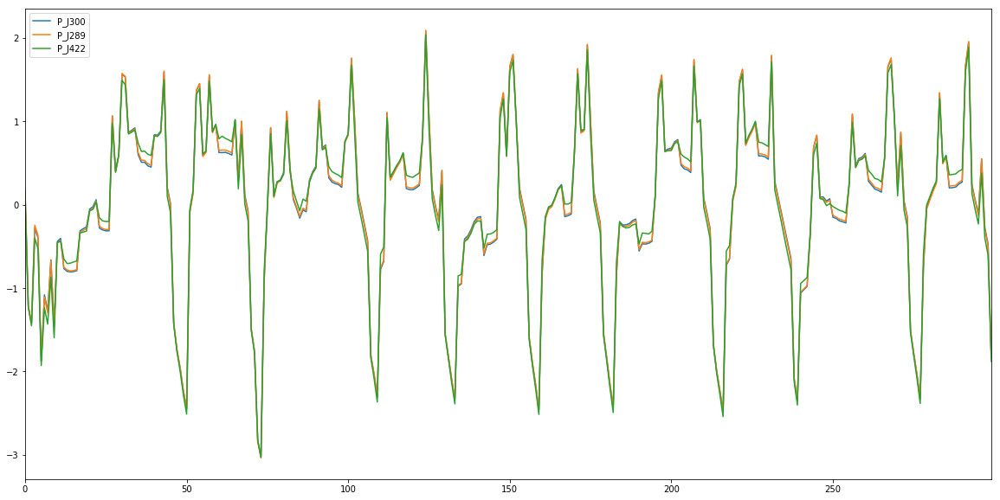

most correlated items of ATT_FLAG are :
[['F_PU6', 0.42760579889044753]]


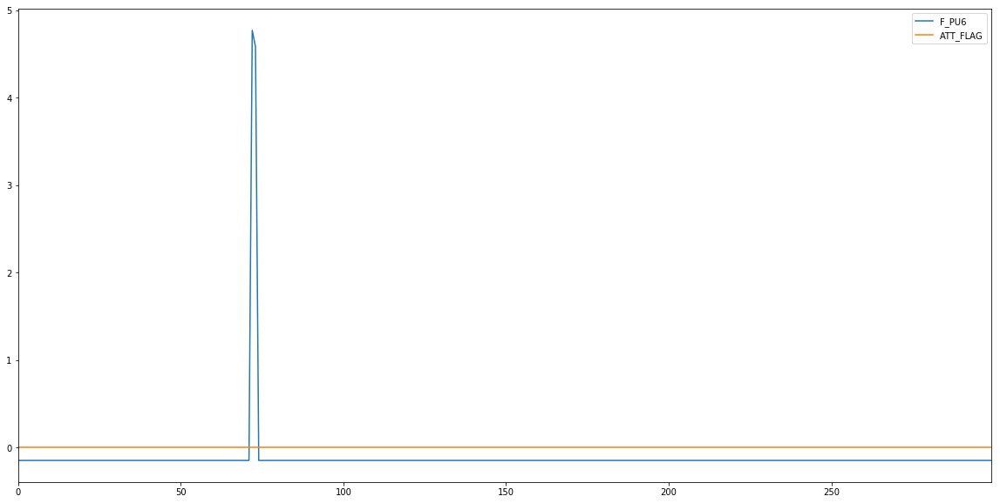

In [13]:
correlationCal(normalized_2)

## 3.Make prediction using sliding window and linear regression

To Do: Other options: Regression Trees, Probabilistic Models, Polynomial Regression;

validation method might not be proper.

MSE of L_T1 and prediction with window width 5 and predLength 2 is: 0.11916781153761317


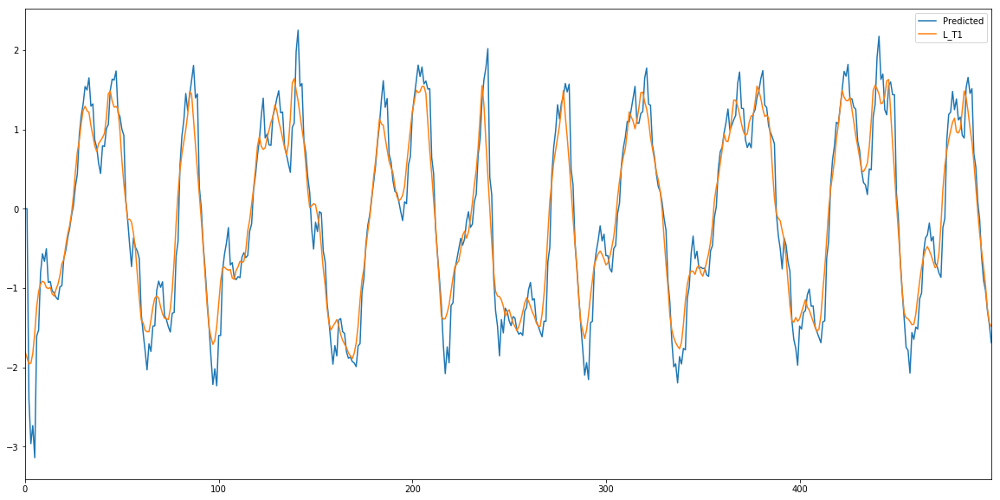

MSE of L_T2 and prediction with window width 5 and predLength 2 is: 0.3249092466740068


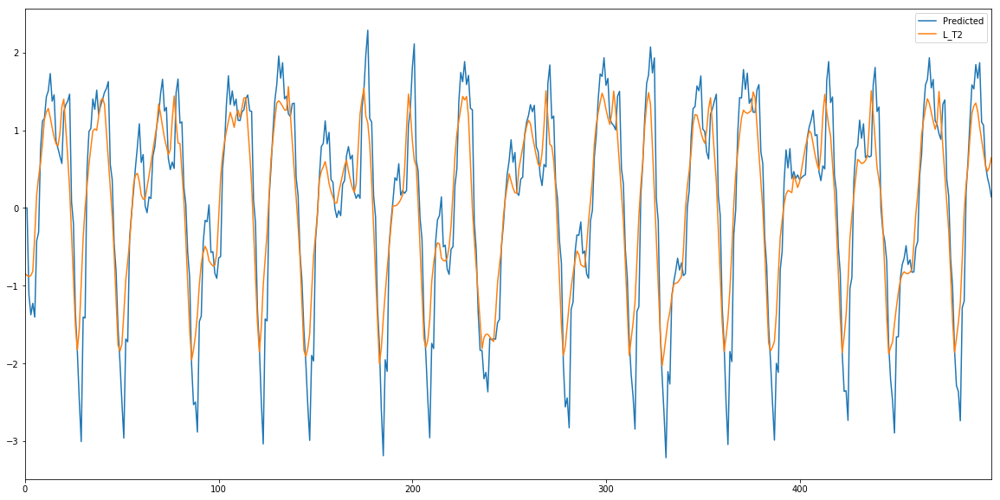

MSE of L_T3 and prediction with window width 5 and predLength 2 is: 1.700563857074493


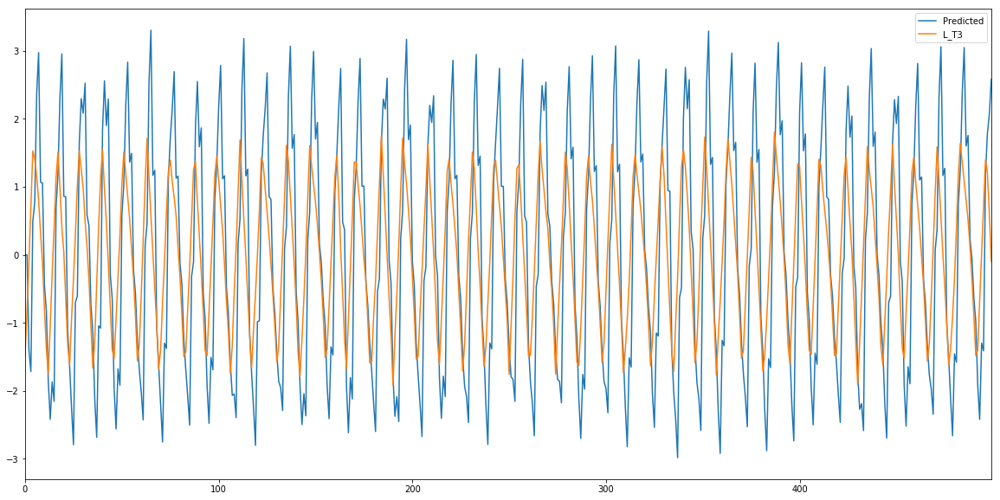

MSE of L_T4 and prediction with window width 5 and predLength 2 is: 2.048954795430166


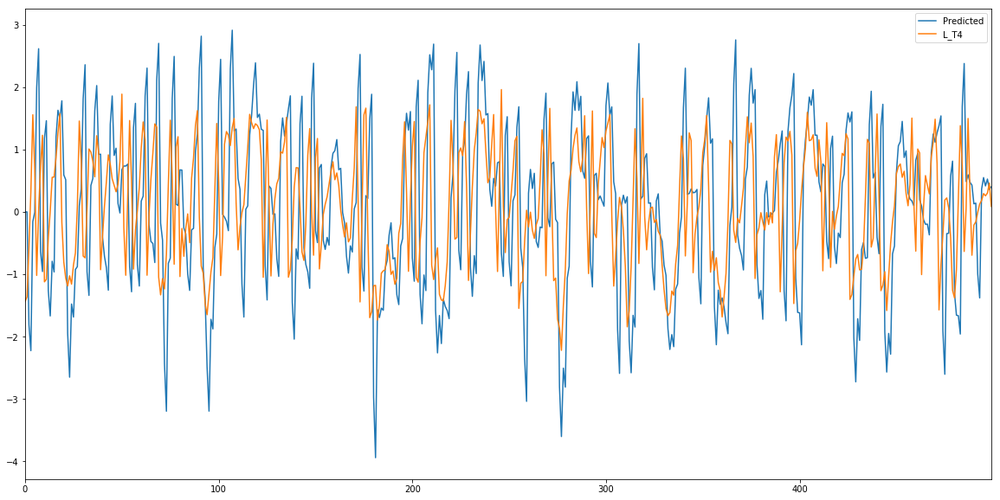

MSE of L_T5 and prediction with window width 5 and predLength 2 is: 2.606083242082811


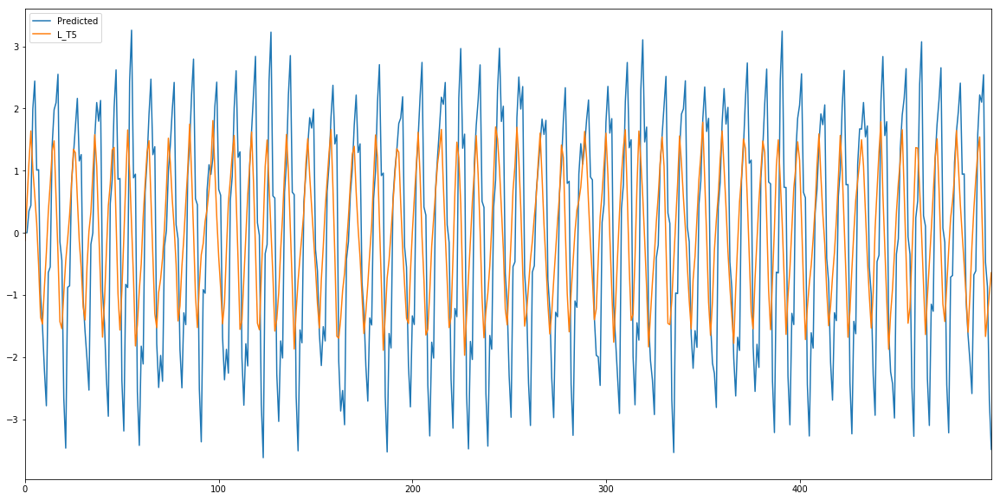

MSE of L_T6 and prediction with window width 5 and predLength 2 is: 3.246547050723536


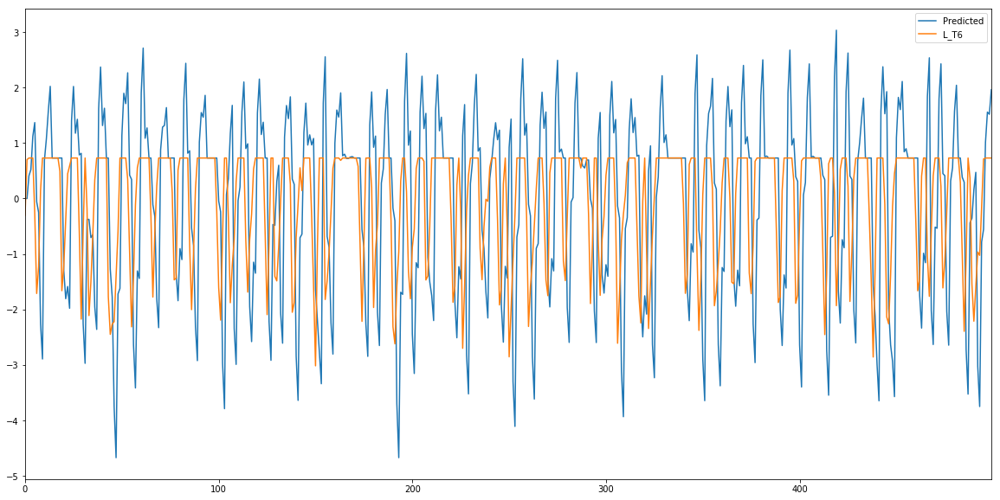

MSE of L_T7 and prediction with window width 5 and predLength 2 is: 2.8331001128438302


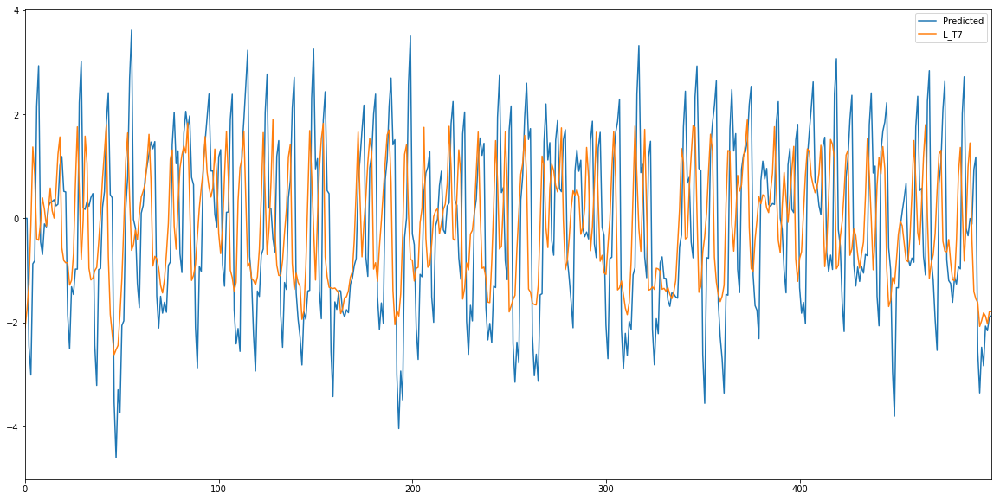

MSE of F_PU1 and prediction with window width 5 and predLength 2 is: 0.5996002054814016


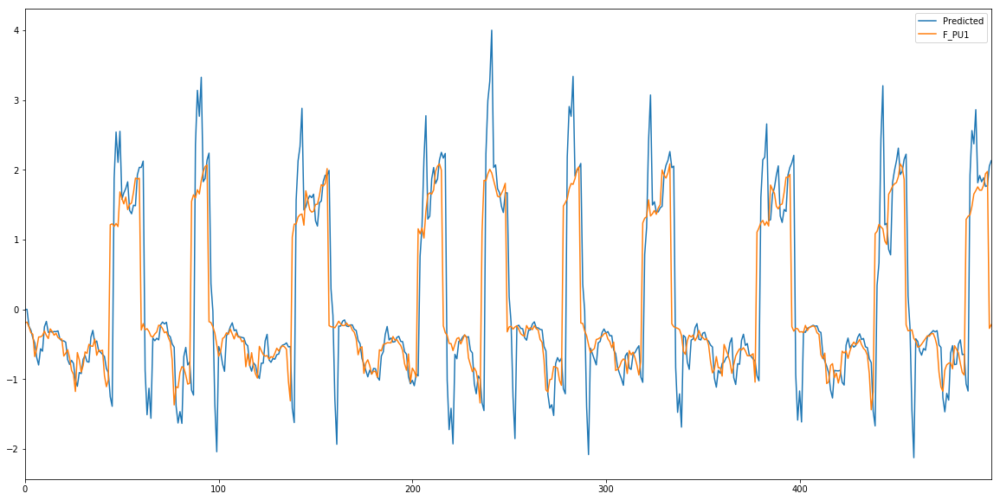

MSE of S_PU1 and prediction with window width 5 and predLength 2 is: 0.0


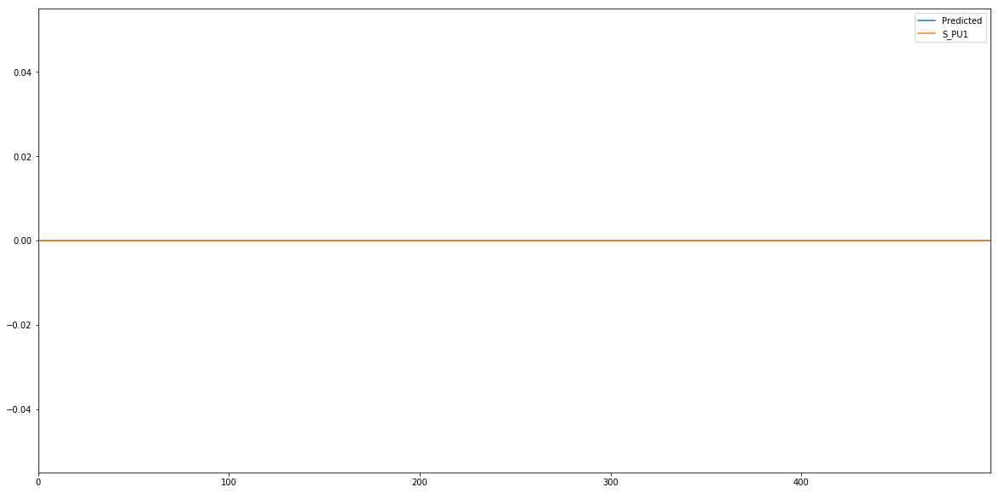

MSE of F_PU2 and prediction with window width 5 and predLength 2 is: 0.5010599463342679


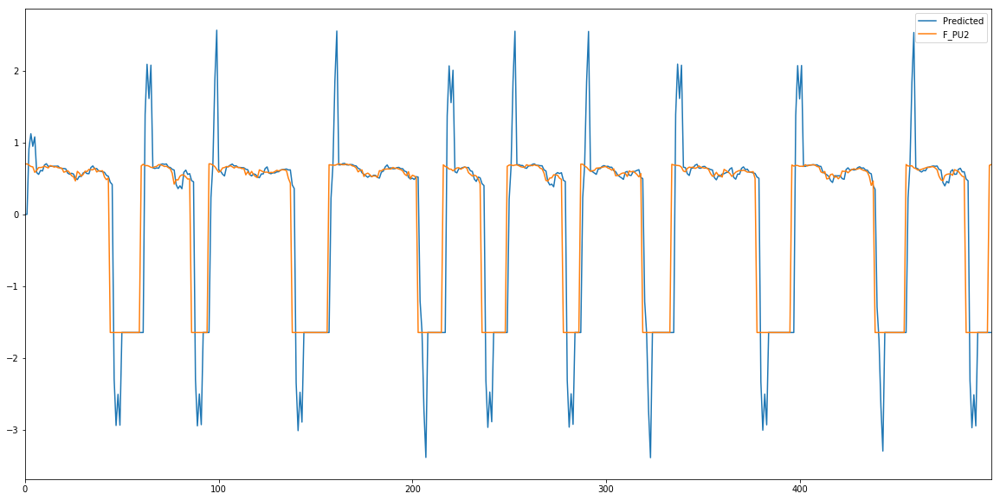

MSE of S_PU2 and prediction with window width 5 and predLength 2 is: 0.5113475282584815


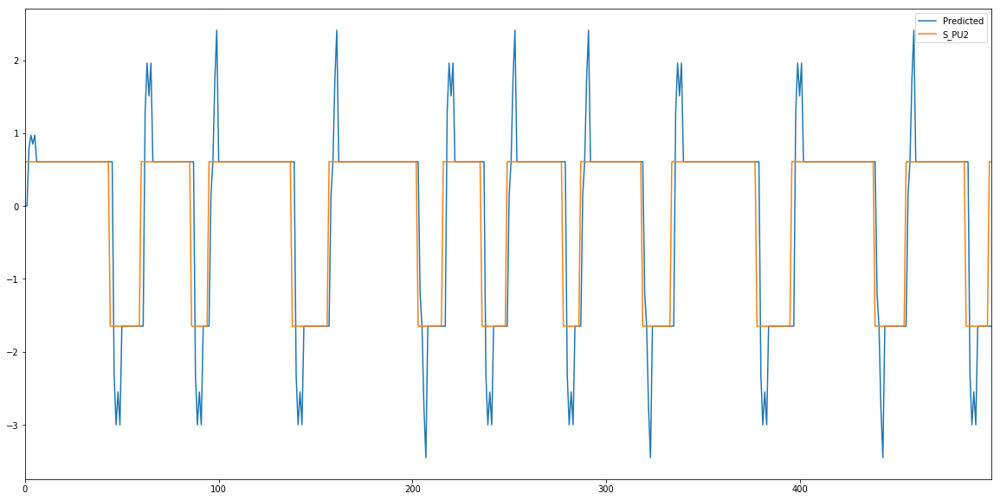

MSE of F_PU3 and prediction with window width 5 and predLength 2 is: 0.0


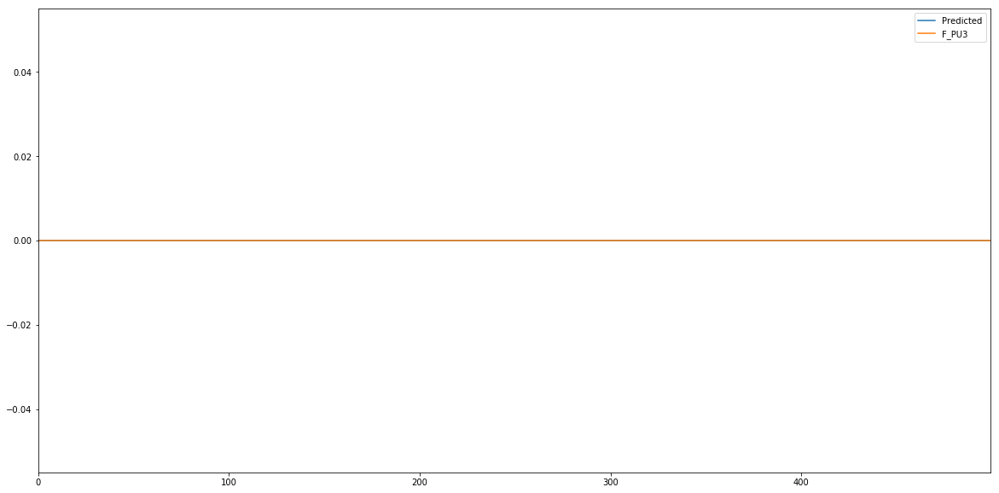

MSE of S_PU3 and prediction with window width 5 and predLength 2 is: 0.0


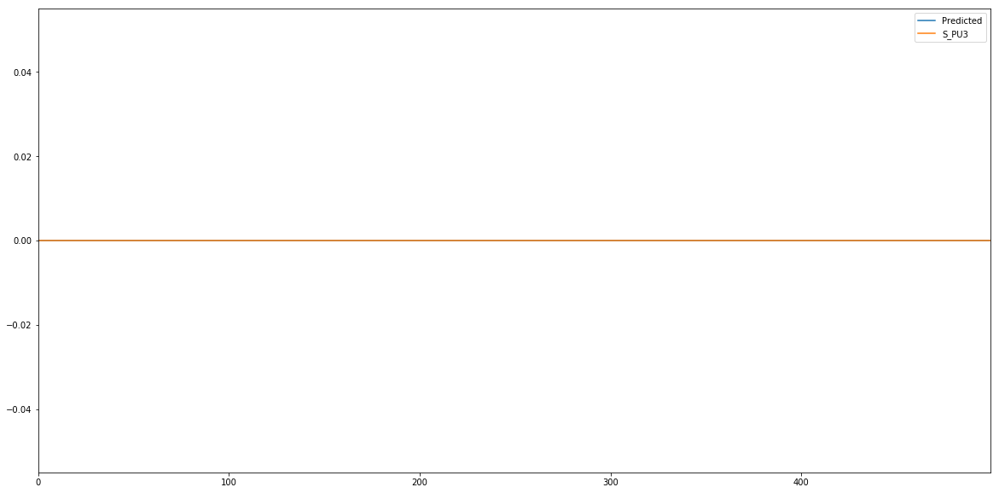

MSE of F_PU4 and prediction with window width 5 and predLength 2 is: 1.9152978994087284


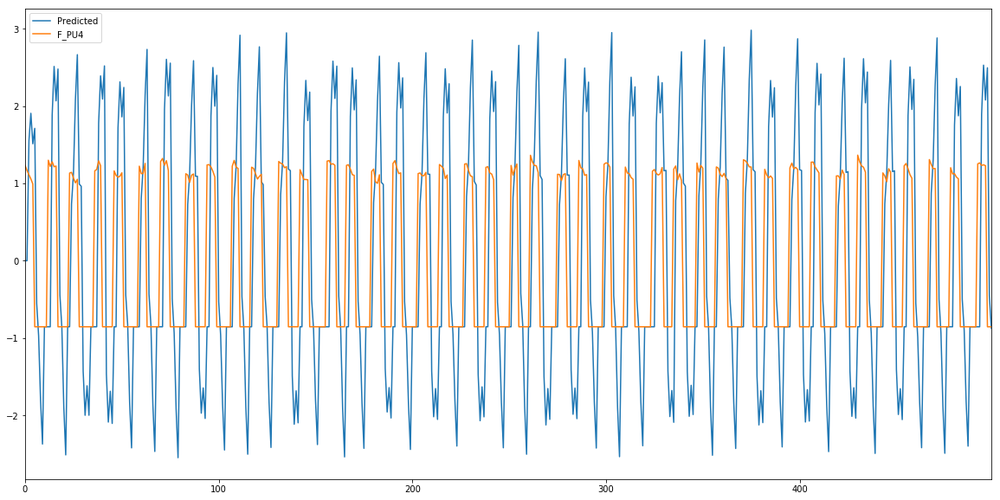

MSE of S_PU4 and prediction with window width 5 and predLength 2 is: 1.8997709377039074


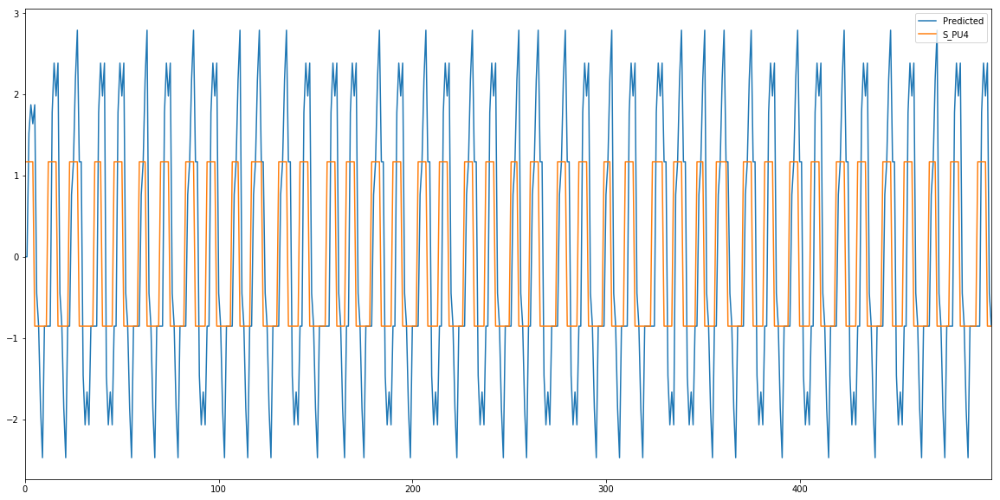

MSE of F_PU5 and prediction with window width 5 and predLength 2 is: 0.0


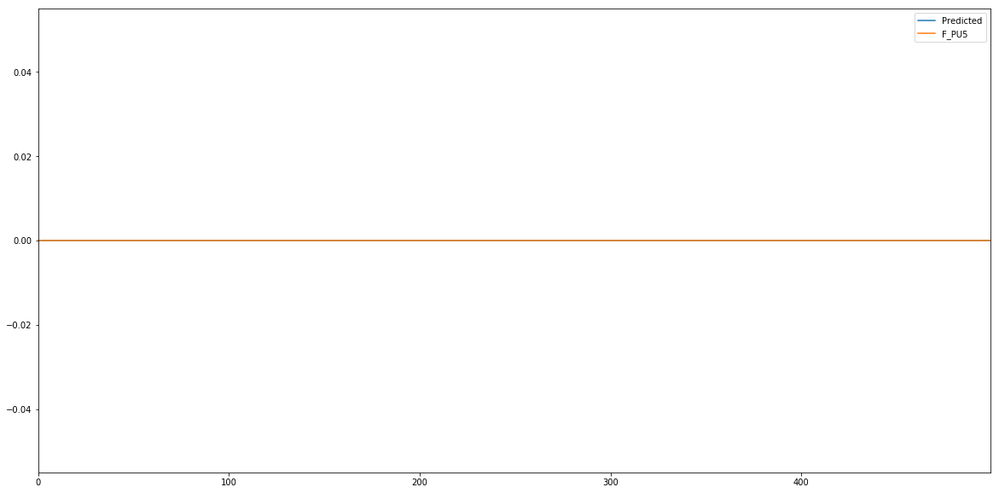

MSE of S_PU5 and prediction with window width 5 and predLength 2 is: 0.0


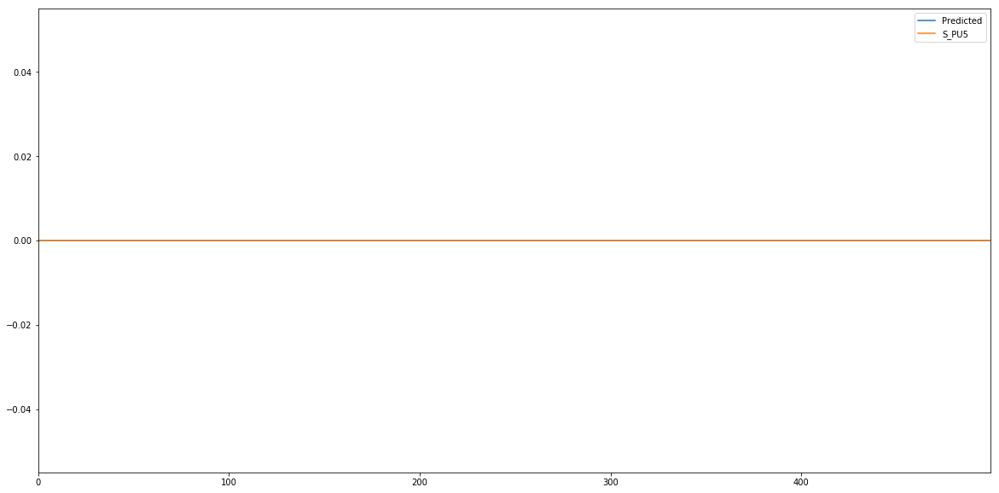

MSE of F_PU6 and prediction with window width 5 and predLength 2 is: 1.0864232779271439e-05


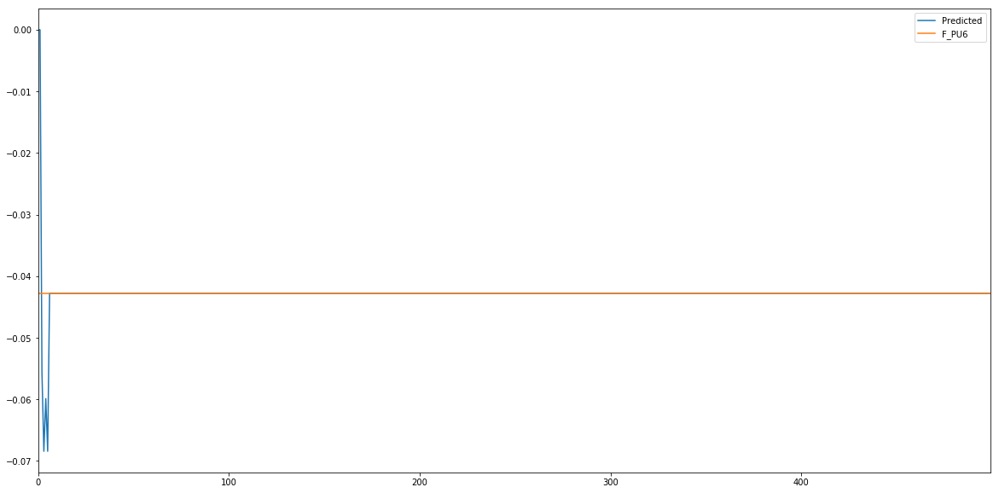

MSE of S_PU6 and prediction with window width 5 and predLength 2 is: 1.086668403925679e-05


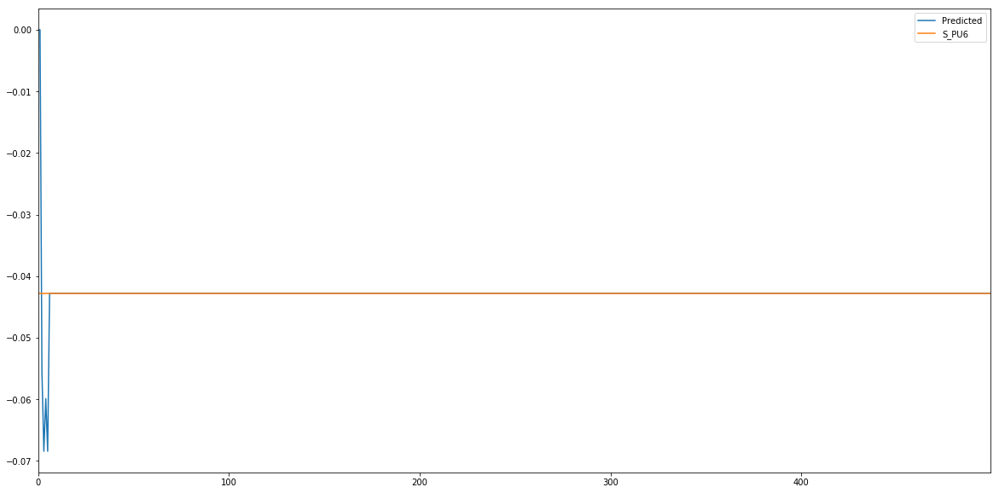

MSE of F_PU7 and prediction with window width 5 and predLength 2 is: 2.415883444236846


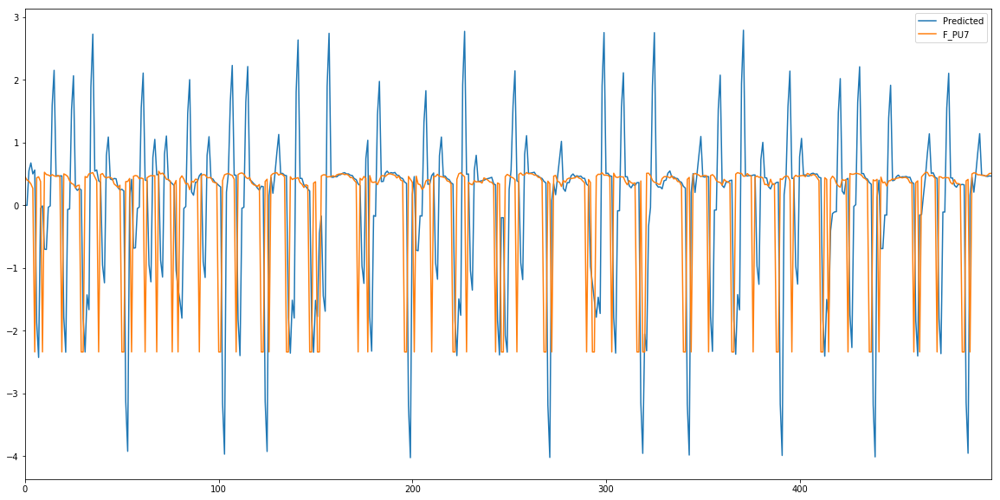

MSE of S_PU7 and prediction with window width 5 and predLength 2 is: 2.432159598714206


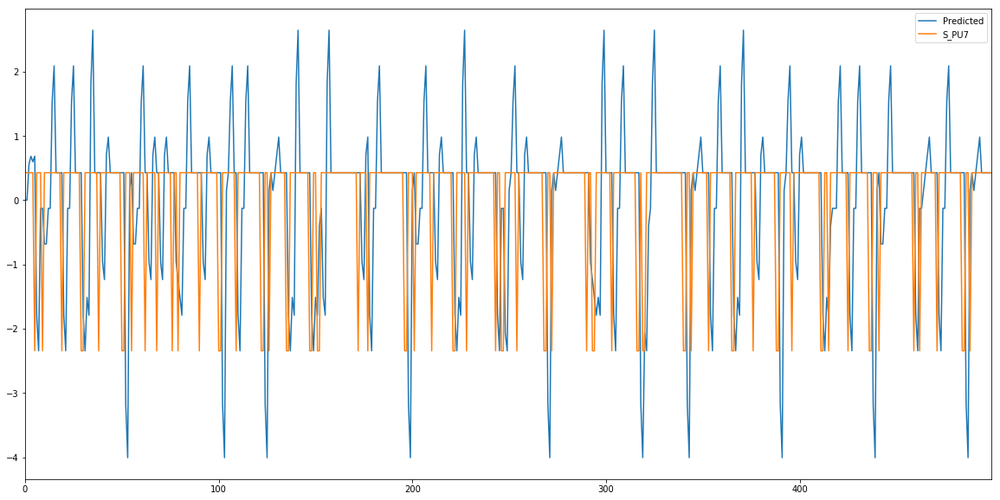

MSE of F_PU8 and prediction with window width 5 and predLength 2 is: 2.578093571303989


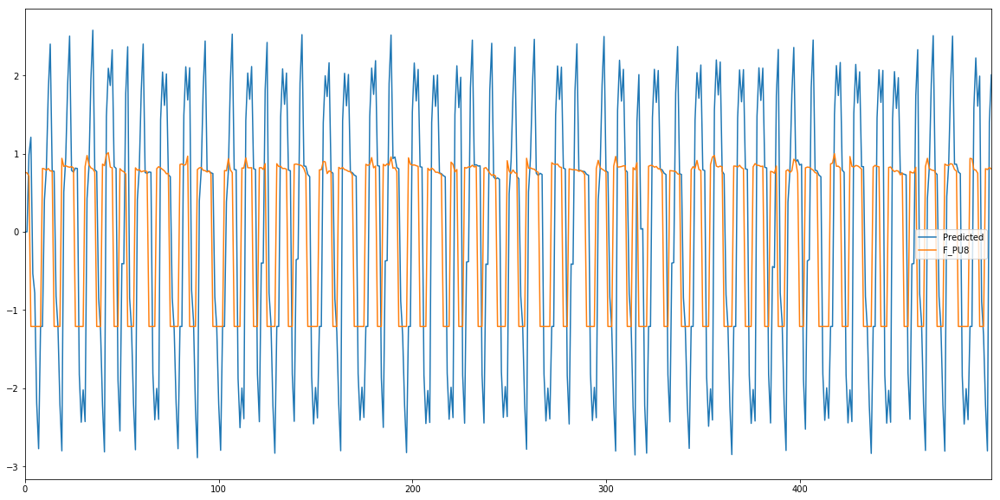

MSE of S_PU8 and prediction with window width 5 and predLength 2 is: 2.595623839549542


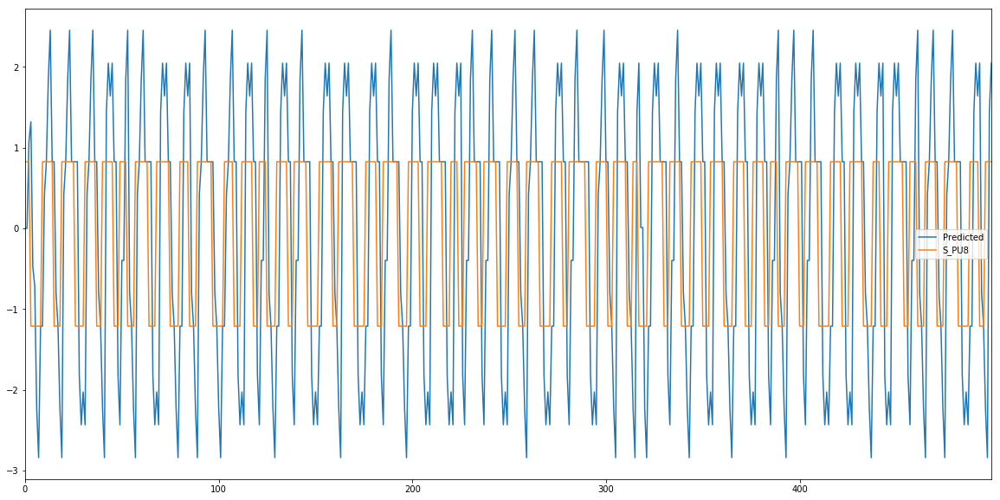

MSE of F_PU9 and prediction with window width 5 and predLength 2 is: 0.0


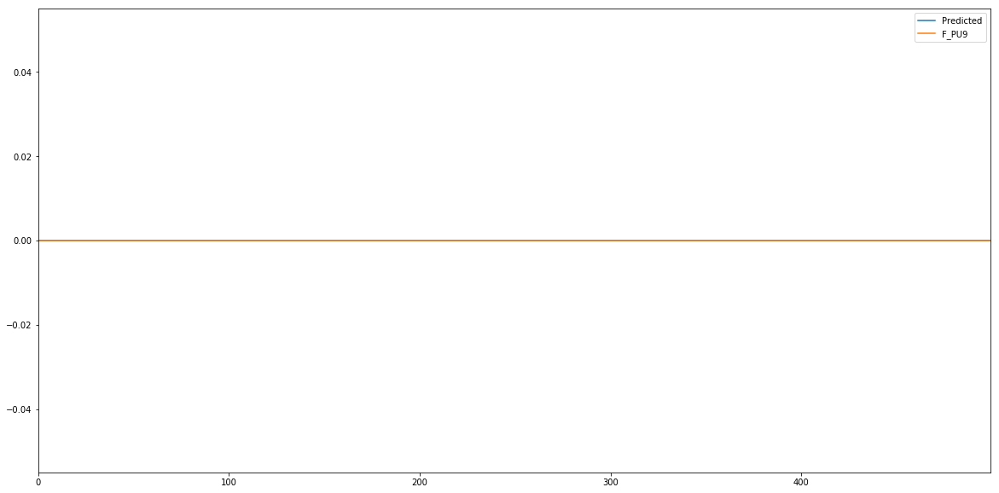

MSE of S_PU9 and prediction with window width 5 and predLength 2 is: 0.0


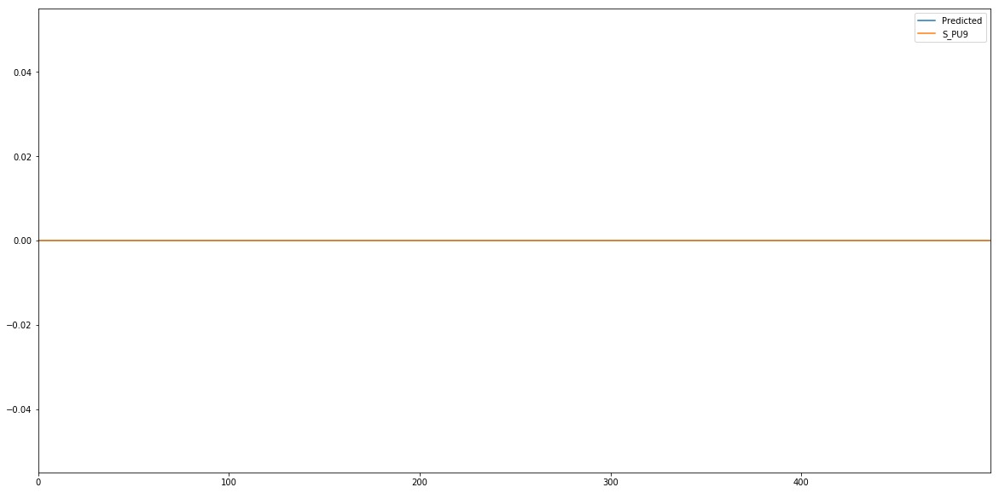

MSE of F_PU10 and prediction with window width 5 and predLength 2 is: 3.338348790285929


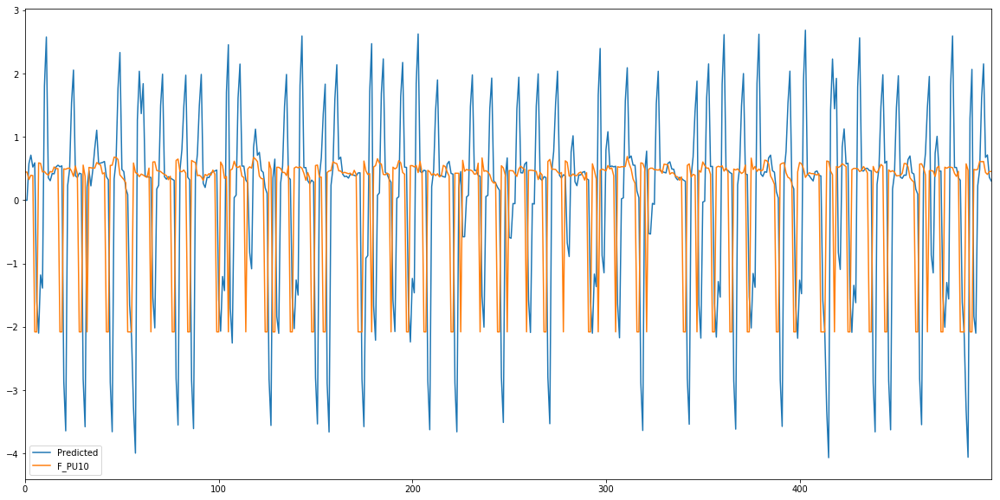

MSE of S_PU10 and prediction with window width 5 and predLength 2 is: 3.3613655418338984


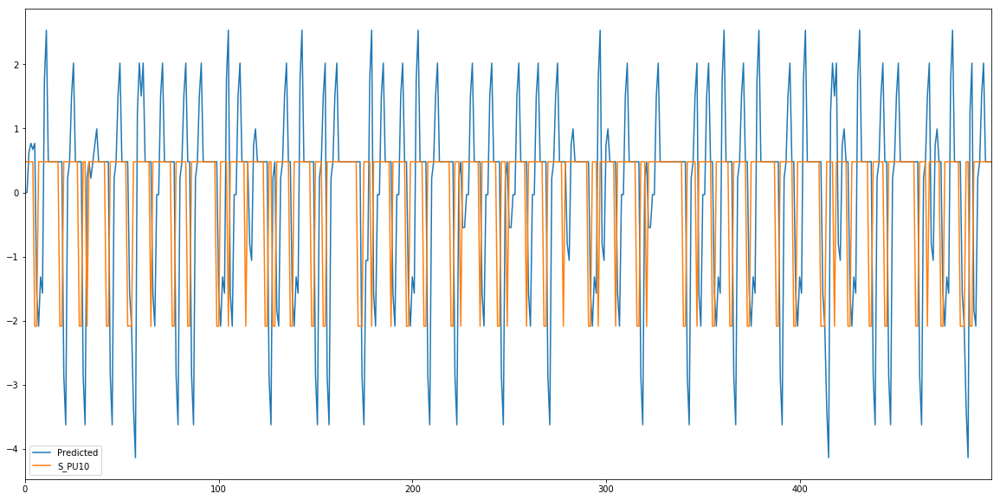

MSE of F_PU11 and prediction with window width 5 and predLength 2 is: 2.6997456123693187e-06


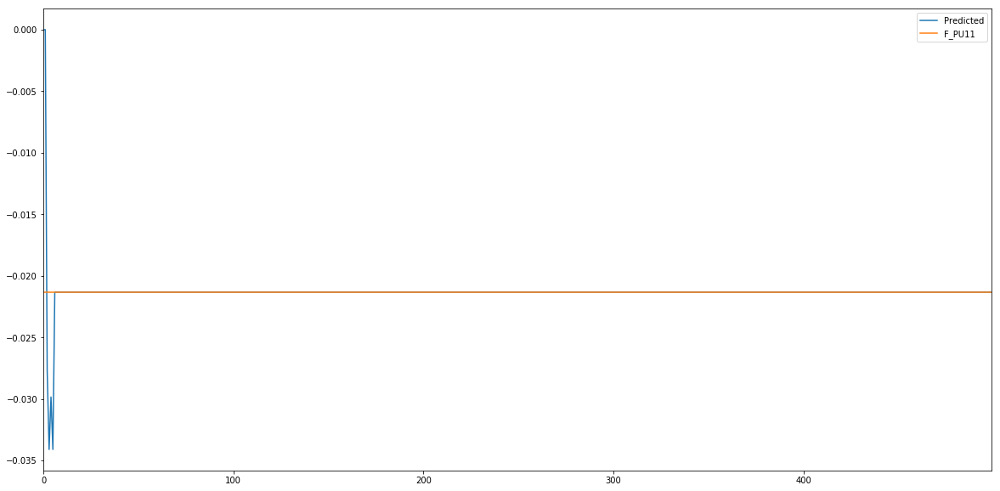

MSE of S_PU11 and prediction with window width 5 and predLength 2 is: 2.7129482677660945e-06


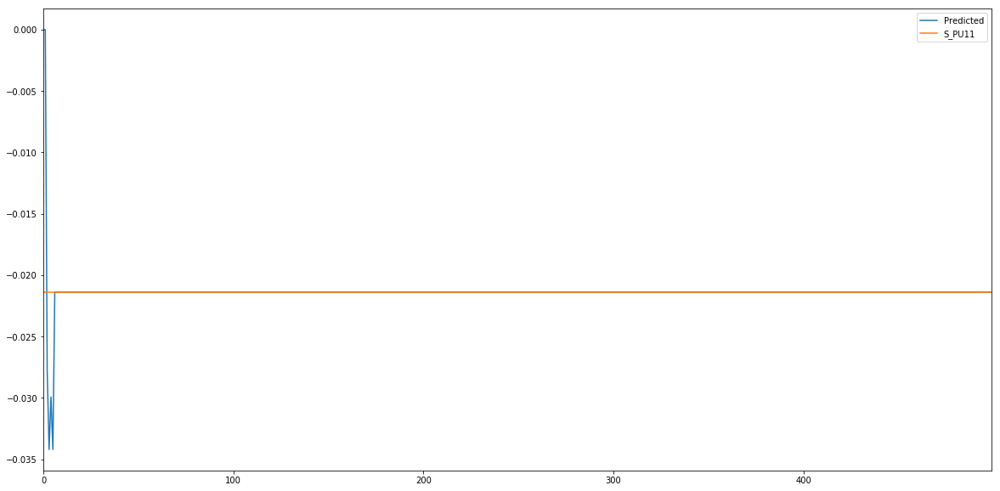

MSE of F_V2 and prediction with window width 5 and predLength 2 is: 0.989970003009888


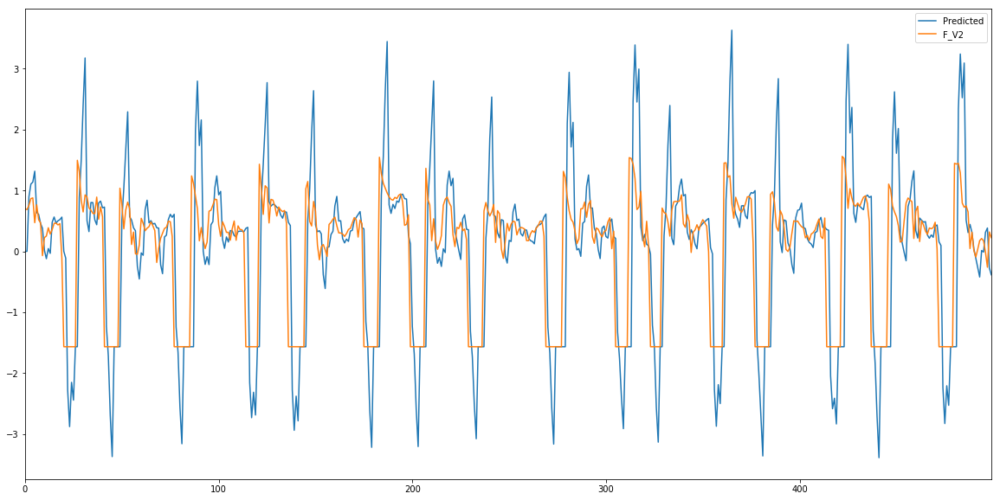

MSE of S_V2 and prediction with window width 5 and predLength 2 is: 0.7539384331509418


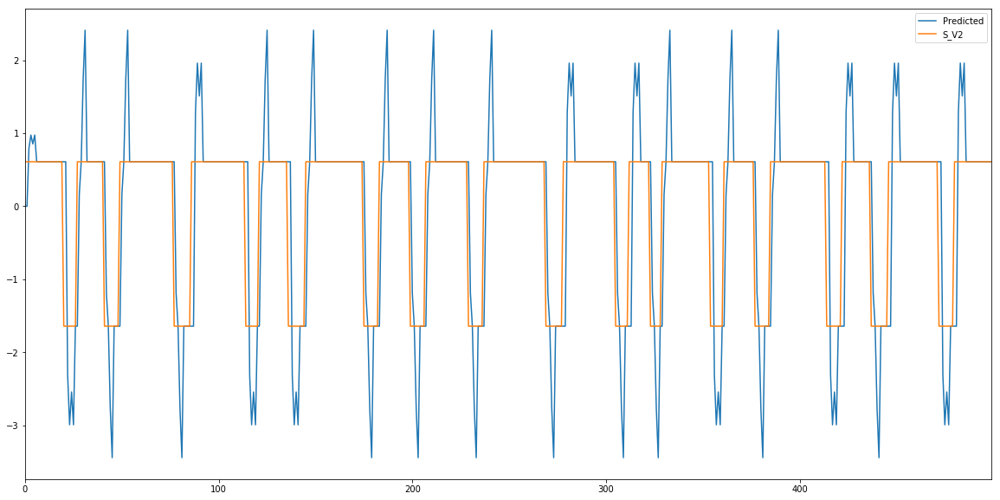

MSE of P_J280 and prediction with window width 5 and predLength 2 is: 0.4850242124226031


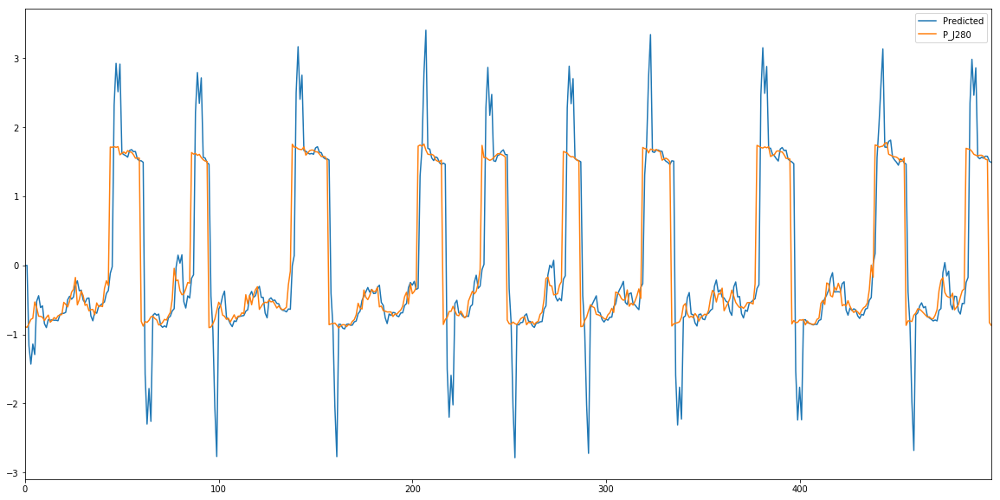

MSE of P_J269 and prediction with window width 5 and predLength 2 is: 0.5961997347623871


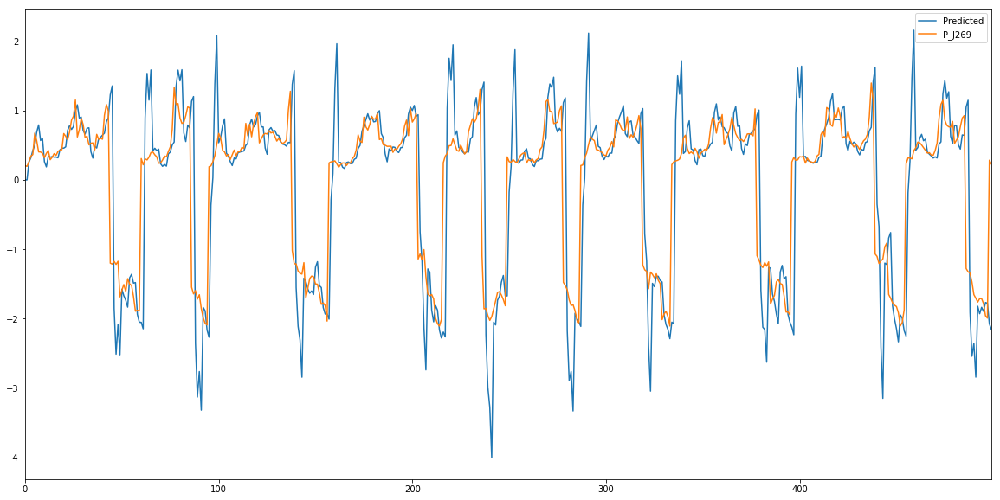

MSE of P_J300 and prediction with window width 5 and predLength 2 is: 1.0007260881062072


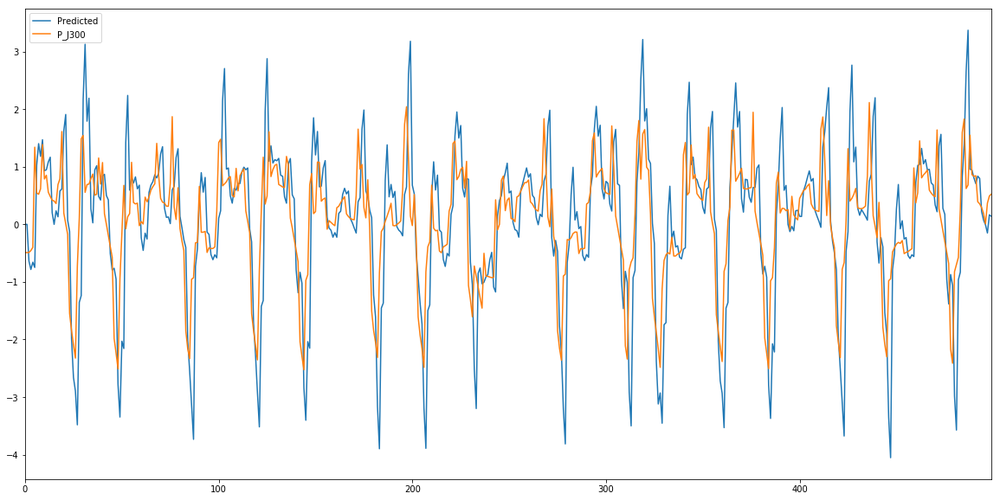

MSE of P_J256 and prediction with window width 5 and predLength 2 is: 2.0817208292952447


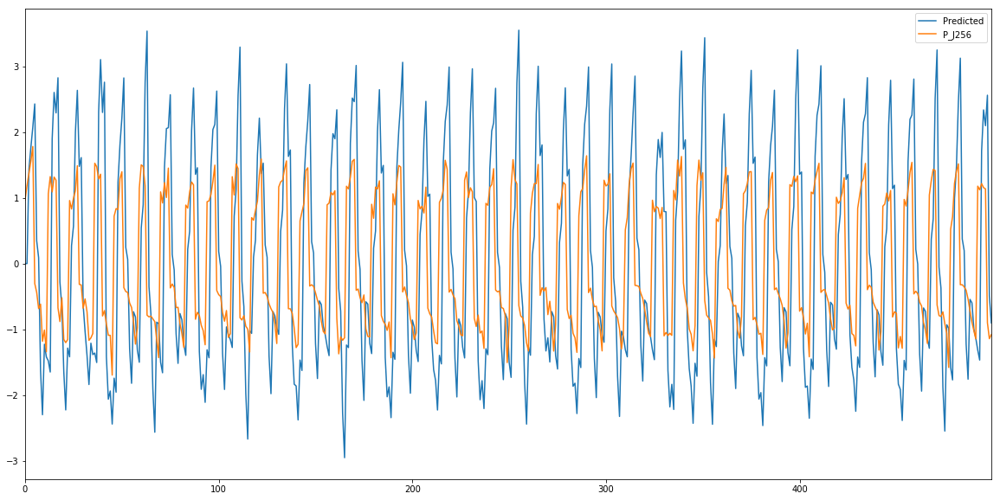

MSE of P_J289 and prediction with window width 5 and predLength 2 is: 0.9951952786916913


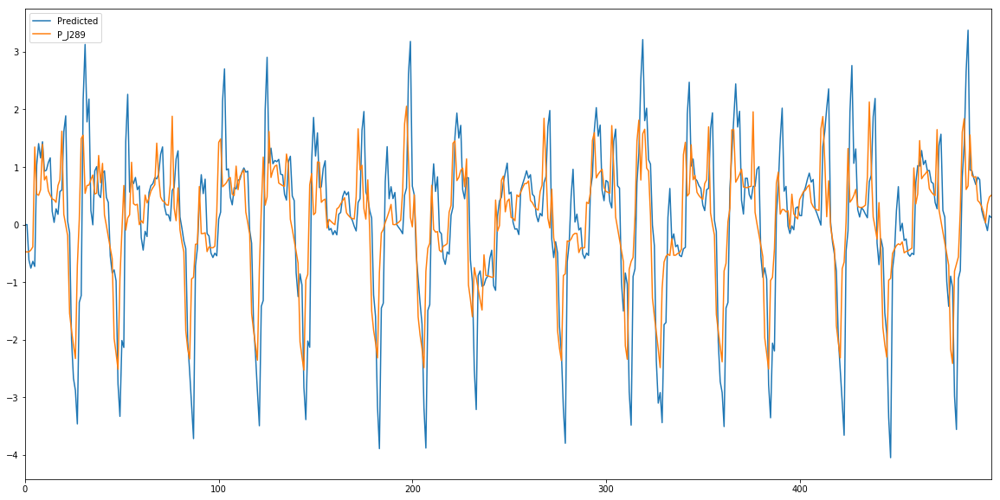

MSE of P_J415 and prediction with window width 5 and predLength 2 is: 2.5063689339937043


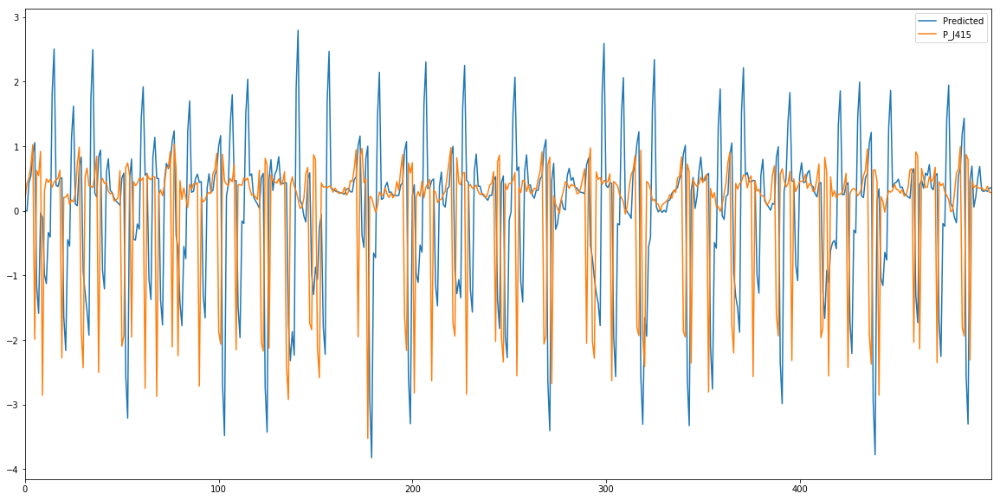

MSE of P_J302 and prediction with window width 5 and predLength 2 is: 2.368479058480873


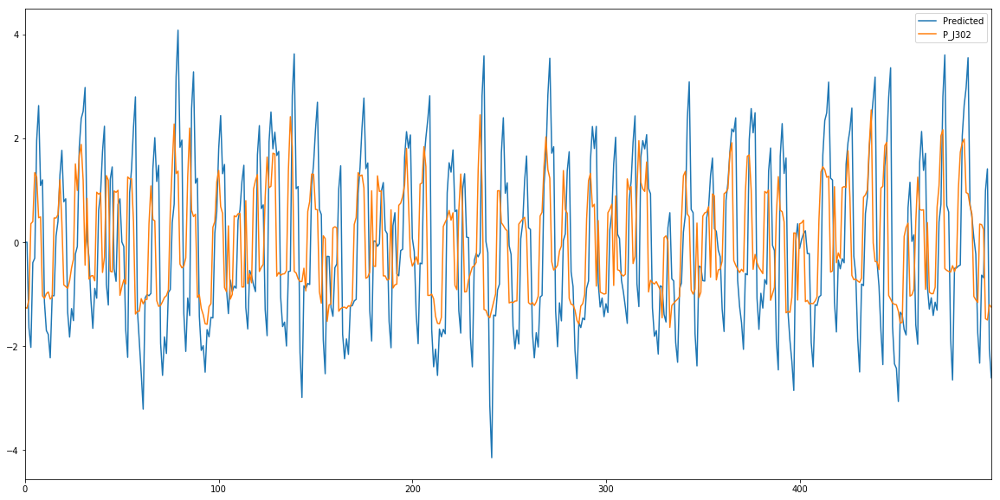

MSE of P_J306 and prediction with window width 5 and predLength 2 is: 2.671463664869055


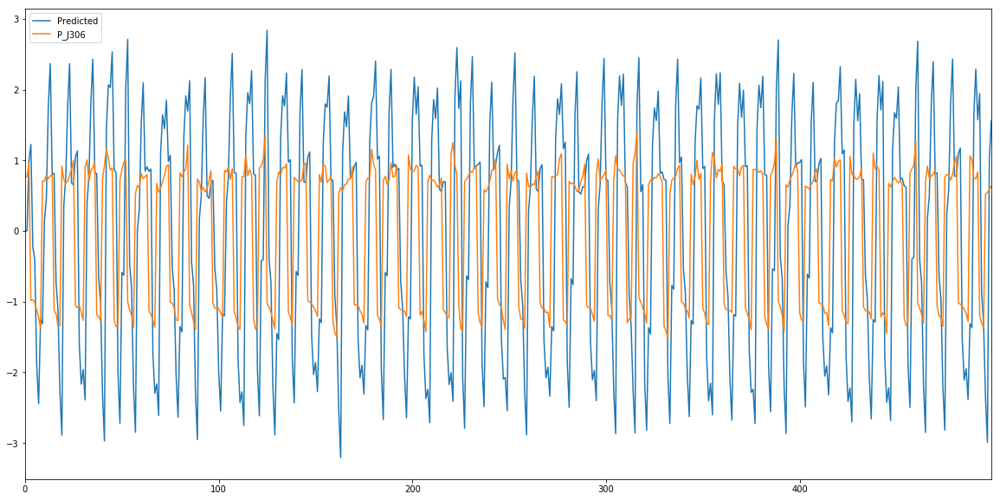

MSE of P_J307 and prediction with window width 5 and predLength 2 is: 2.376489972214668


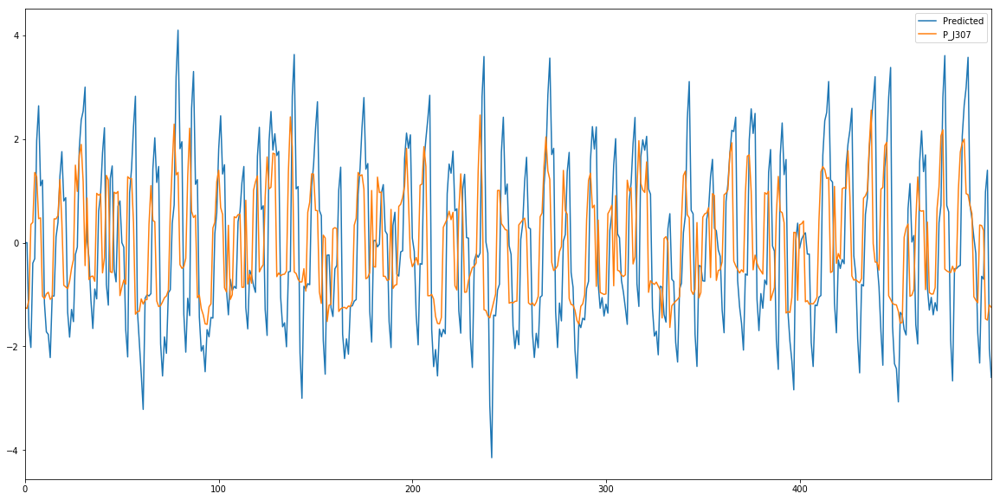

MSE of P_J317 and prediction with window width 5 and predLength 2 is: 3.7823397818178583


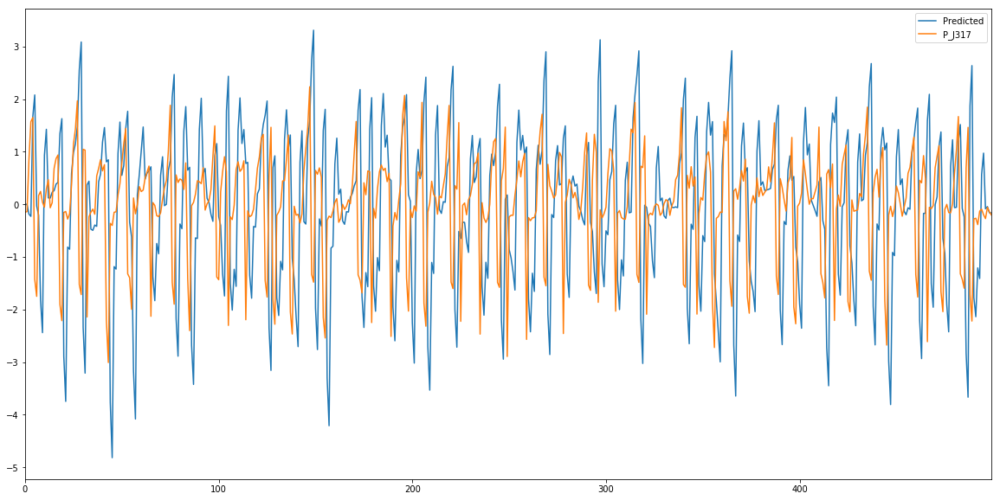

MSE of P_J14 and prediction with window width 5 and predLength 2 is: 1.044965354736674


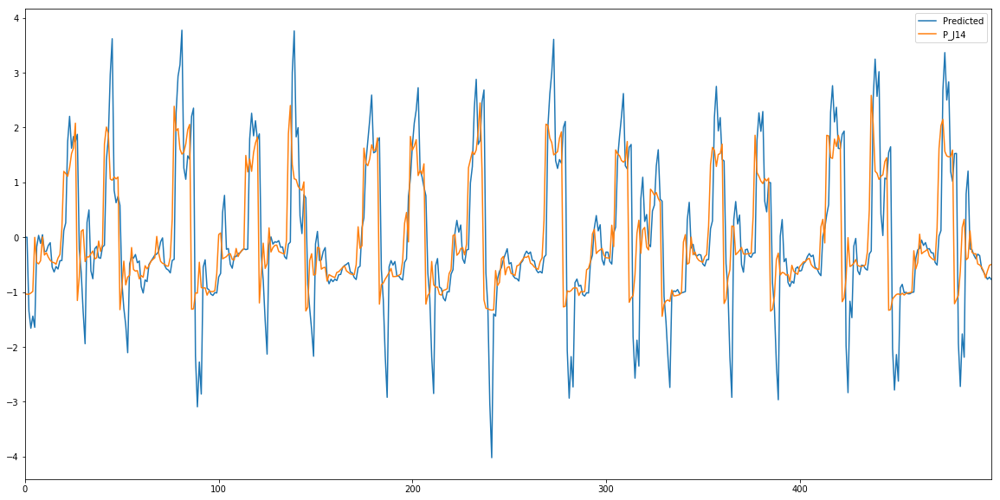

MSE of P_J422 and prediction with window width 5 and predLength 2 is: 0.9354513919206051


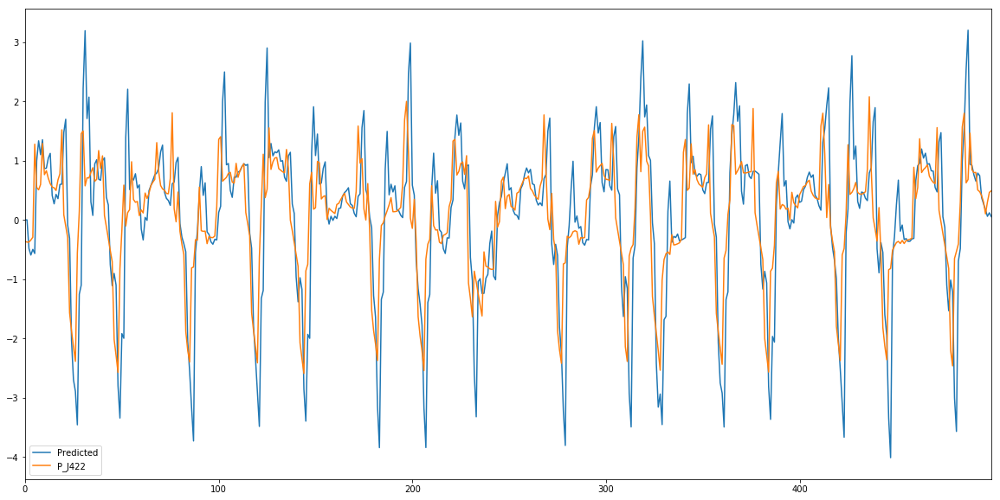

MSE of ATT_FLAG and prediction with window width 5 and predLength 2 is: 0.0


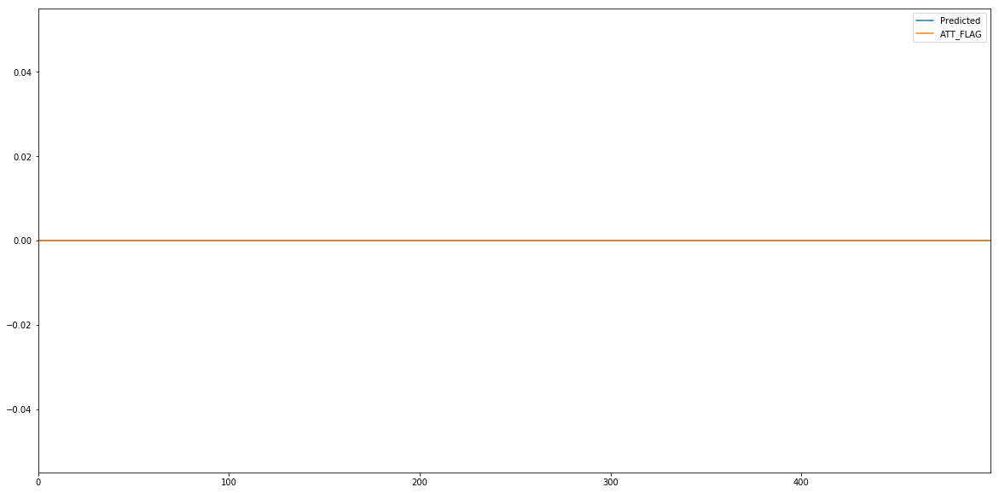

In [14]:
#prediction using sliding window and linear regression
from sklearn.linear_model import LinearRegression

#turn list of list to a list
def flatten(list):
    flattened_list=[]
    for i in list:
        for j in i:
            flattened_list.append(j)
    return flattened_list

def prediction(signal,width,predLength):
    #signal is what need to be predicted
    #width is the width of sliding window, padding method is used
    #predLength is how many steps to predict
    signal=signal.tolist()
    prediction=[]
    for i in range(0,len(signal),predLength):
        slice=[]
        if i < width:
            slice=slice+[0]*(width-i)
            slice=slice+signal[0:i]
        else:
            slice=signal[i-width:i]
            #predict value at location i
        X=np.array(range(width)).reshape(-1,1)
        y=np.array(slice).reshape(-1,1)
        reg=LinearRegression().fit(X,y)
        if i+predLength>=len(signal):
            predLength=len(signal)-i
        tmp=reg.predict(np.array(range(width,width+predLength)).reshape(-1,1))
        prediction.extend(flatten(tmp))
    return prediction


from sklearn.metrics import mean_squared_error

#sliding window with width 5
width=5
predLength=2
col=normalized_1.columns.tolist()
col.remove('DATETIME')
for i in col:
    a=prediction(normalized_1[i][0:500],width,predLength)
    #MSE
    y_true=np.array(normalized_1[i][0:500])
    y_predict=np.array(a)
    mse=mean_squared_error(y_true,y_predict)
    print(f'MSE of {i} and prediction with window width {width} and predLength {predLength} is: {mse}')
    pd.Series(a).plot(figsize=(20,10),label='Predicted')
    normalized_1[i][0:500].plot(figsize=(20,10))
    plt.legend()
    plt.show()

# Predicting using ARMA

Learn an autoregressive moving average model (see Wikipedia for an introduction if unfamiliar) for at least 5 individual sensors (pick them in a sensible way!). Most statistical packages (R, statsmodels in Python) contain standard algorithm for fitting these models from training data. Use autocorrelation plots in order to identify the order of the ARMA models. The parameters can be determined using Akaike’s Information Criterion (AIC) or another model selection method. Note that there exists a wide range of ARMA variants; you only have to use the basic model.Decide how to set the detection threshold sensibly. Study some of the anomalies detected anomalies. What kind of anomalies can you detect using ARMA models? Which sensors can be modeled effectively using ARMA?<br/>
Steps:<br/>
1.Pick 5 sensors<br/>
2.autocorrelation plot http://people.duke.edu/~rnau/411arim3.htm  https://onlinecourses.science.psu.edu/stat510/lesson/3/3.1<br/>
3.AIC to determine parameter (Box–Jenkins method)<br/>
4.detection threshold<br/>
5.detect anotomy and performance analysis<br/>
https://otexts.com/fpp2/AR.html <br/>
https://machinelearningmastery.com/difference-time-series-dataset-python/

## 1.Pick Sensors
Attacks in the list will affect following sensors:<br/>
1.L_T7,T7:low level<br/>
2.like 1,PU10,PU11<br/>
3.L_T1:low level, PU1/PU2:on T1:overflow<br/>
4.like 3, pressure at pumps outlet<br/>
5.PU7:reduce to 0.9, T4:low level<br/>
6.PU7:reduced to 0.7 L_T4:drop concealed<br/>
7.like 6, L_T1,PU1/PU2<br/>
We choose L_T1,L_T7,F_PU1,F_PU7,F_PU10

## 2.Use autocorrelation plot to decide model order.

In [15]:
print(normalized_2.columns)

Index(['DATETIME', 'L_T1', 'L_T2', 'L_T3', 'L_T4', 'L_T5', 'L_T6', 'L_T7',
       'F_PU1', 'S_PU1', 'F_PU2', 'S_PU2', 'F_PU3', 'S_PU3', 'F_PU4', 'S_PU4',
       'F_PU5', 'S_PU5', 'F_PU6', 'S_PU6', 'F_PU7', 'S_PU7', 'F_PU8', 'S_PU8',
       'F_PU9', 'S_PU9', 'F_PU10', 'S_PU10', 'F_PU11', 'S_PU11', 'F_V2',
       'S_V2', 'P_J280', 'P_J269', 'P_J300', 'P_J256', 'P_J289', 'P_J415',
       'P_J302', 'P_J306', 'P_J307', 'P_J317', 'P_J14', 'P_J422', 'ATT_FLAG'],
      dtype='object')


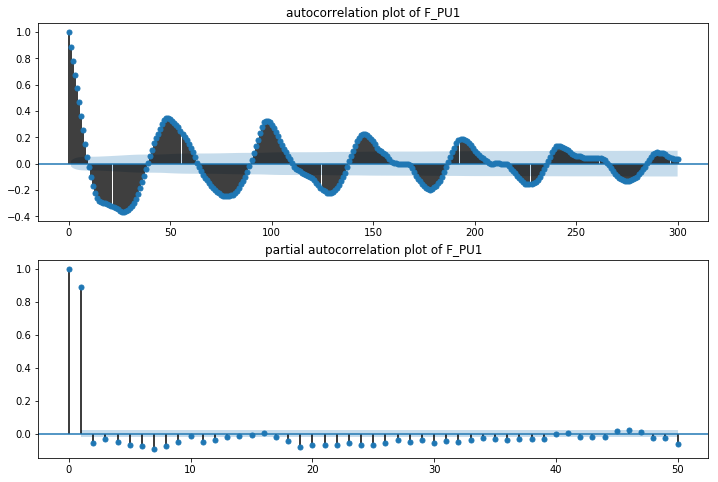

In [16]:
#Use autocorrelation method to decide parameter 

# from pandas.plotting import autocorrelation_plot

# autocorrelation_plot(normalized_1['F_PU1'][0:200])

# %pip install statsmodels scipy

from scipy import stats
import statsmodels.api as sm

def autocorrelation_plots(signal,name,lags=50):
    series=signal[name]
    fig = plt.figure(figsize=(12,8))
    ax1 = fig.add_subplot(211)
    fig = sm.graphics.tsa.plot_acf(series.values.squeeze(), lags=lags, ax=ax1)
    ax1.title.set_text("autocorrelation plot of "+ name)
    ax2 = fig.add_subplot(212)
    fig = sm.graphics.tsa.plot_pacf(series, lags=50, ax=ax2)
    ax2.title.set_text("partial autocorrelation plot of "+ name)
    
autocorrelation_plots(normalized_1,'F_PU1',300)

# from pandas.plotting import autocorrelation_plot
# fig = plt.figure(figsize=(12,8))
# autocorrelation_plot(normalized_1['F_PU1'][0:200])

F_PU1 is sinusoidal->AR(2)<br/>

## 3. Determine parameter
Time series signals are cyclic(time series with cyclic behavior is stationary), so no differencing is needed<br/>
https://otexts.com/fpp2/arima-estimation.html

When using a model for estimation, it's inevitable to lose some information. AIC is used to measure the amount of information lost by using certain model. The smaller AIC is, the model is more close to real process. AIC looks after both underfitting and overfitting.<br/>
$$AIC=2k-2ln(\hat{L})$$
k is the number of estimated parameters. \hat{L} is the maximum value of the likelihood function for the model.<br/>
BIC import the number of parameters, but in our assignment the numbers of parameters are similar.<br/>

In [17]:
from statsmodels.tsa.arima_model import ARIMA
import math

def  comAIC(signal,name,rangeP:list,rangeQ:list):
    series=signal[name]
    min=math.inf
    qstart=rangeQ[0]
    qend=rangeQ[1]
    pstart=rangeP[0]
    pend=rangeP[1]
    bestOrder=[]
    coea=coem=[]
    for i in range(pstart,pend+1,1):
        for j in range(qstart,qend+1,1):
                model = ARIMA(series, order=(i,0,j))
                model_fit = model.fit(disp=0)
                if model_fit.aic<min:
                    min=model_fit.aic
                    bestOrder=[i,0,j]
                    coea=model_fit.arparams
                    coem=model_fit.maparams
                print(f'when p,d,q are {i,0,j} aic is, {model_fit.aic}')
    print(f'min aic is {min} when p,d,q are {bestOrder}')
    return bestOrder,min,coea,coem

[order,aic,coea,coem]=comAIC(normalized_2,'F_PU1',[1,5],[1,5])

when p,d,q are (1, 0, 1) aic is, 5372.601440494274
when p,d,q are (1, 0, 2) aic is, 5371.1044046797215
when p,d,q are (1, 0, 3) aic is, 5362.129538182938
when p,d,q are (1, 0, 4) aic is, 5356.599808467828
when p,d,q are (1, 0, 5) aic is, 5343.558459792836
when p,d,q are (2, 0, 1) aic is, 5156.896445953406
when p,d,q are (2, 0, 2) aic is, 5151.0296961212625
when p,d,q are (2, 0, 3) aic is, 5141.888887202714
when p,d,q are (2, 0, 4) aic is, 5142.702502496941
when p,d,q are (2, 0, 5) aic is, 5144.245779252277
when p,d,q are (3, 0, 1) aic is, 5151.93957205765
when p,d,q are (3, 0, 2) aic is, 5125.831364955425
when p,d,q are (3, 0, 3) aic is, 5142.598018975685
when p,d,q are (3, 0, 4) aic is, 5144.549720640892
when p,d,q are (3, 0, 5) aic is, 5143.255552017944
when p,d,q are (4, 0, 1) aic is, 5143.30501799321
when p,d,q are (4, 0, 2) aic is, 5142.521068875272
when p,d,q are (4, 0, 3) aic is, 5124.033176932838
when p,d,q are (4, 0, 4) aic is, 5123.851794552783
when p,d,q are (4, 0, 5) aic is

c:\users\a\appdata\local\programs\python\python37\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


when p,d,q are (5, 0, 3) aic is, 5121.464272493586


c:\users\a\appdata\local\programs\python\python37\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


when p,d,q are (5, 0, 4) aic is, 5127.032496489405
when p,d,q are (5, 0, 5) aic is, 5128.827829136768
min aic is 5121.464272493586 when p,d,q are [5, 0, 3]


## 4.detect threshold
trainging at every step is inefficient. So we only train once using training dataset 1. prediction is calculated based on formula. Need to notice that we've already standardized the time series so mean is 0.

In [18]:
def thresholdTraining(train,test,name,size):
    attacks=test['ATT_FLAG']
    attackindex=attacks.index[attacks == 1].tolist()
    test=test[name].tolist()
    #due to configuration constraint and the time-consuming trainging process, we only test 25 aic combinations
    [order,aic,coea,coem]=comAIC(train,name,[1,size],[1,size])
    #order is trained previously using training dataset 1
    p=order[0]
    q=order[-1]
    size=max(len(coea),len(coem))
    history=[x for x in test[-size:]]
    predictions=list()
    #predict time series
    for t in range(len(test)):
        history=history[-size:]
        yhat=0
        for j in range(len(coea)):
            yhat+=coea[j]*history[j]
        for j in range(len(coem)):
            yhat+=coem[j]*history[j]
        predictions.append(yhat)
        obs = test[t]
        history.append(obs)
    #MSE
    error = mean_squared_error(test, predictions)
    print('Test MSE: %.3f' % error)
    # plot
    plt.figure(figsize=(12,8))
    plt.plot(test,label='original')
    plt.plot(predictions, color='red',label='predicted')
    plt.legend()
    plt.show()
    #train threshold
    difference=[]
    for i in range(len(test)):
        difference.append(abs(test[i]-predictions[i]))
    mean=np.mean(difference)
    #range of threshold
    difference=list(map(lambda x: abs(x-mean), difference))
    maximum=max(difference)
    minimum=min(difference)
    threshold=0
    bestPredictAttacks=None
    for i in np.arange(minimum,maximum,0.01):
        predictAttacks=[]
        for t in range(len(test)):
            if abs(predictions[t]-mean)>i:
                predictAttacks.append(1)
            else:
                predictAttacks.append(0)
        #f1 score
        tp=0
        fn=0
        fp=0
        best=0
        f1=0
        for t in range(len(test)):
            if attacks[t]==1 and predictAttacks[t]==1:
                tp+=1
            if attacks[t]==1 and predictAttacks[t]==0:
                fn+=1
            if attacks[t]==1 and predictAttacks[t]==0:
                fp+=1        
        if tp>0:
            precision=tp/(tp+fp)
            recall=tp/(tp+fn)
            f1=2*(precision*recall)/(recall+precision)
        if f1>best:
            best=f1
            threshold=i
            bestPredictAttacks=predictAttacks     
    #plot predicted attacks
    plt.figure(figsize=(12,8))
    plt.plot(attacks,color='yellow')
    plt.plot(bestPredictAttacks,color='red')
#     errorrate=best/np.sum(attacks)
#     print(f'Error rate is {errorrate}')
    print(f'threshold is {threshold}')
    plt.show()
    return order,coea,coem,threshold

when p,d,q are (1, 0, 1) aic is, -10989.974861199767
when p,d,q are (1, 0, 2) aic is, -13814.23103181813
when p,d,q are (1, 0, 3) aic is, -15016.379961236406
when p,d,q are (2, 0, 1) aic is, -16503.855355333206
when p,d,q are (2, 0, 2) aic is, -16524.21126823674
when p,d,q are (2, 0, 3) aic is, -16538.793109623828
when p,d,q are (3, 0, 1) aic is, -16515.48772915627
when p,d,q are (3, 0, 2) aic is, -16649.924237053925
when p,d,q are (3, 0, 3) aic is, -16648.76209451938
min aic is -16649.924237053925 when p,d,q are [3, 0, 2]
Test MSE: 1.254


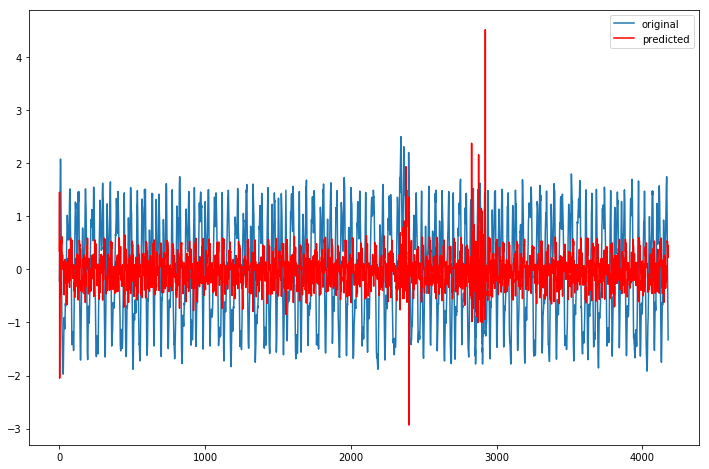

threshold is 1.960733506480329


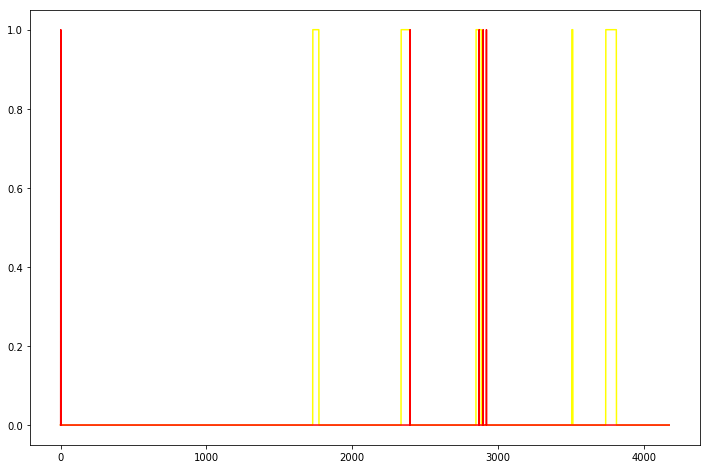

([3, 0, 2],
 array([ 2.69937542, -2.440846  ,  0.73828454]),
 array([-0.73521147, -0.22612868]),
 1.960733506480329)

In [19]:
thresholdTraining(normalized_1,normalized_2,'L_T1',3)

## 5.detect anotomy and performance analysis<br/>

when p,d,q are (1, 0, 1) aic is, 11202.48820264977
when p,d,q are (1, 0, 2) aic is, 11197.635491436227
when p,d,q are (1, 0, 3) aic is, 11185.540430284573
when p,d,q are (2, 0, 1) aic is, 10571.917603628393
when p,d,q are (2, 0, 2) aic is, 10564.320487225606
when p,d,q are (2, 0, 3) aic is, 10539.716842800339
when p,d,q are (3, 0, 1) aic is, 10565.4743530438


c:\users\a\appdata\local\programs\python\python37\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


when p,d,q are (3, 0, 2) aic is, 10506.466102310884
when p,d,q are (3, 0, 3) aic is, 10535.814747382774
min aic is 10506.466102310884 when p,d,q are [3, 0, 2]
Test MSE: 1.314


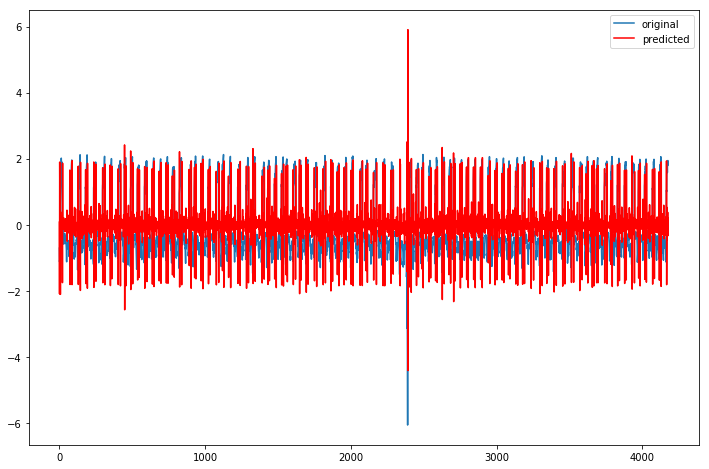

threshold is 5.340569079595522


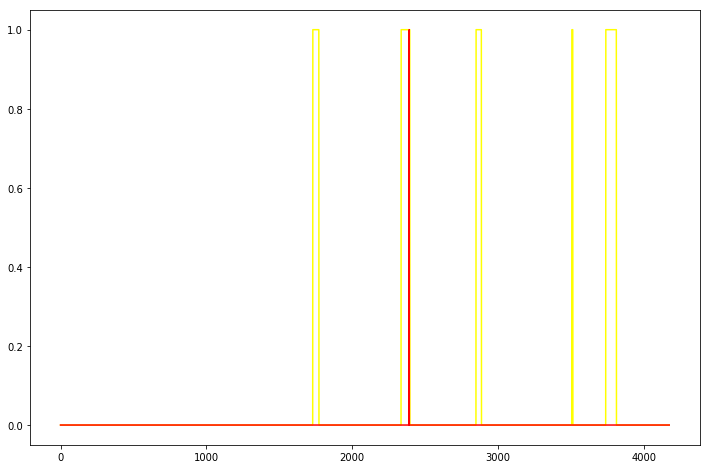

Test MSE: 1.291


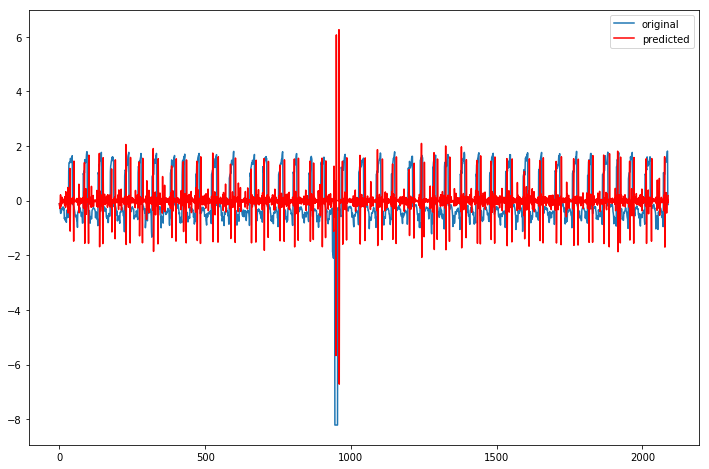

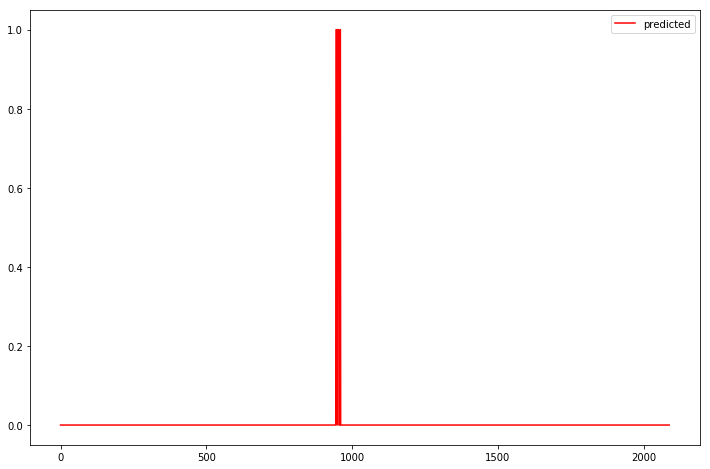

In [20]:
def predict(train1,train2,test,name,size):
    order,coea,coem,threshold=thresholdTraining(train1,train2,name,size)
    #first several samples are needed to predict following time series
    test=test[name].tolist()
    size=max(len(coea),len(coem))
    history=test[0:size]
    predictions=test[0:size]
    #predict time series
    for t in range(len(test)-size):
        history=history[-size:]
        yhat=0
        for j in range(len(coea)):
            yhat+=coea[j]*history[j]
        for j in range(len(coem)):
            yhat+=coem[j]*history[j]
        predictions.append(yhat)
        obs = test[t]
        history.append(obs)
    #MSE
    error = mean_squared_error(test, predictions)
    print('Test MSE: %.3f' % error)
    # plot predict time series
    plt.figure(figsize=(12,8))
    plt.plot(test,label='original')
    plt.plot(predictions, color='red',label='predicted')
    plt.legend()
    plt.show()
    #plot predict anomalies
    difference=[]
    for i in range(len(test)):
        difference.append(abs(test[i]-predictions[i]))
    mean=np.mean(difference)
    predictAttacks=[]
    for i in range(len(predictions)):
        if abs(predictions[i]-test[i])>threshold:
            predictAttacks.append(1)
        else:
            predictAttacks.append(0)
    plt.figure(figsize=(12,8))
    plt.plot(predictAttacks,color='red',label='predicted')
    plt.legend()
    plt.show()
        
predict(normalized_1,normalized_2,normalized_t,'F_PU1',3)

## To do 6.Combine the 5 chosen signals:

# Discrete models task


Discretize the sensor data using any of the methods discussed in class. Explain why you choose this
method and why the obtained discretization makes sense. Visualize the discretization.<br/>
Apply any of the sequential data mining methods (N-grams, Sequence alignment with kNN, …) to
sliding windows with a length of your choosing in order to find anomalies. Whenever an observed Ngram’s
probability is too small, or the sequential data is too distant from any training sequence,
raise an alarm. Set your thresholds sensibly. What kind of anomalies can you detect using the
sequential model? Which sensors can be modeled effectively?

## 1. discretize and visualize signals

In [21]:
# %pip install tslearn #you may need to install other module first
from tslearn.piecewise import SymbolicAggregateApproximation

In [22]:
def discreteSignal(signal,name,n_sax,paa_width):
    #n_sax: Number of SAX symbols to use
    dataset=signal[name].copy()
    n_sax_symbols = 8
    n_paa_segments = math.ceil(len(dataset)/paa_width)
    sax = SymbolicAggregateApproximation(n_segments=n_paa_segments, alphabet_size_avg=n_sax_symbols)
    sax_dataset_inv = sax.inverse_transform(sax.fit_transform(dataset))
    sax_signal=sax_dataset_inv[0].ravel().tolist()
    return sax_signal

def saxplot(signal,name,n_sax,paa_width,sax_signal):
    dataset=signal[name].copy()
    plt.figure(figsize=(20,10))
    plt.plot(dataset[0:300], "g",label=name)
    plt.plot(sax_signal[0:300], "b",label='sax')
    plt.legend()
    plt.title(f"SAX {n_sax} symbols, paa width {paa_width}" )
    return

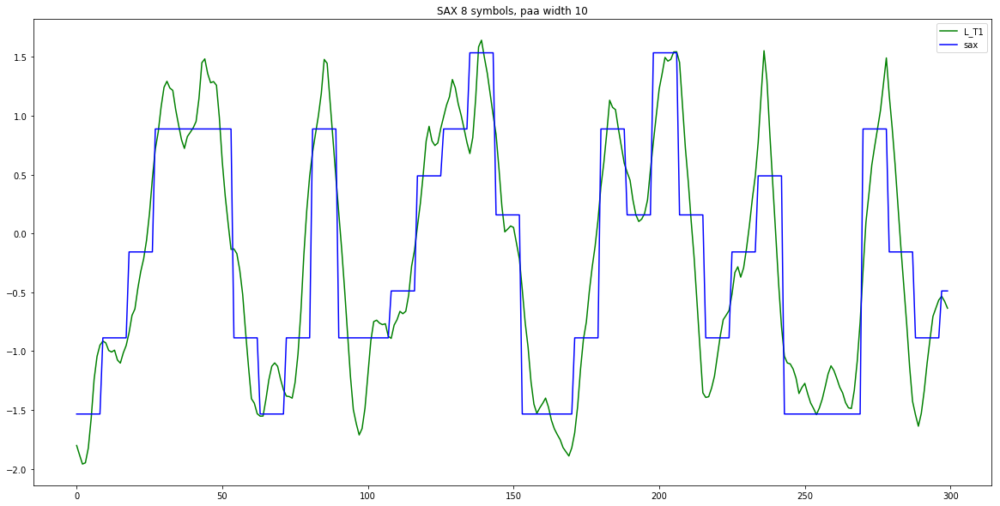

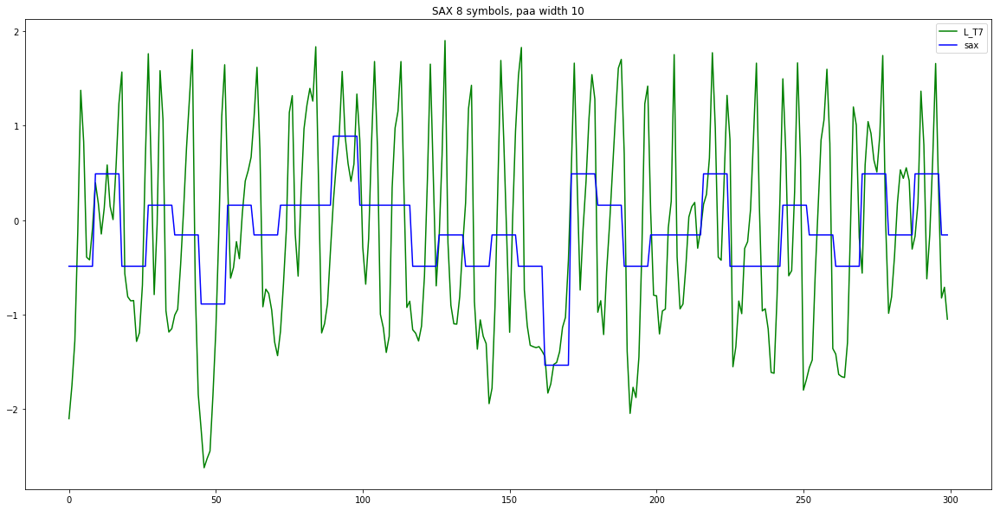

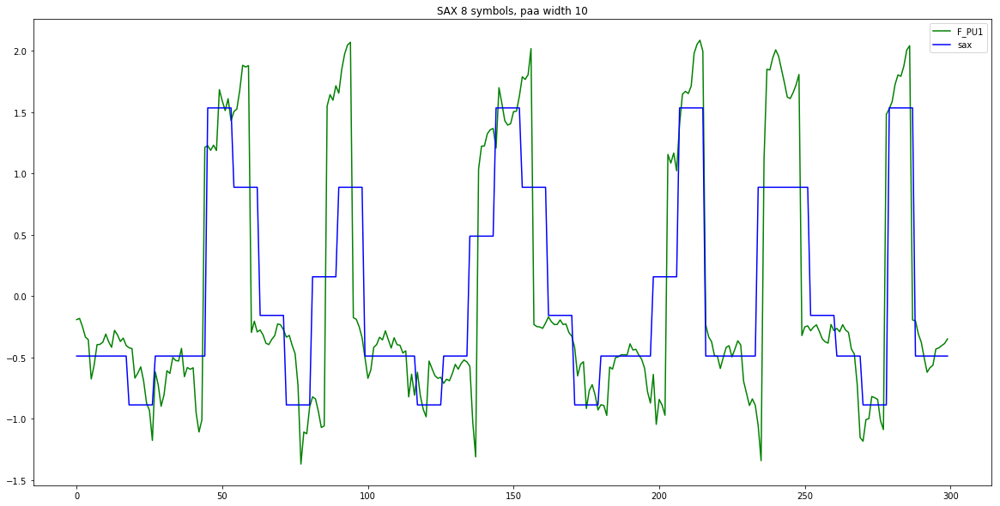

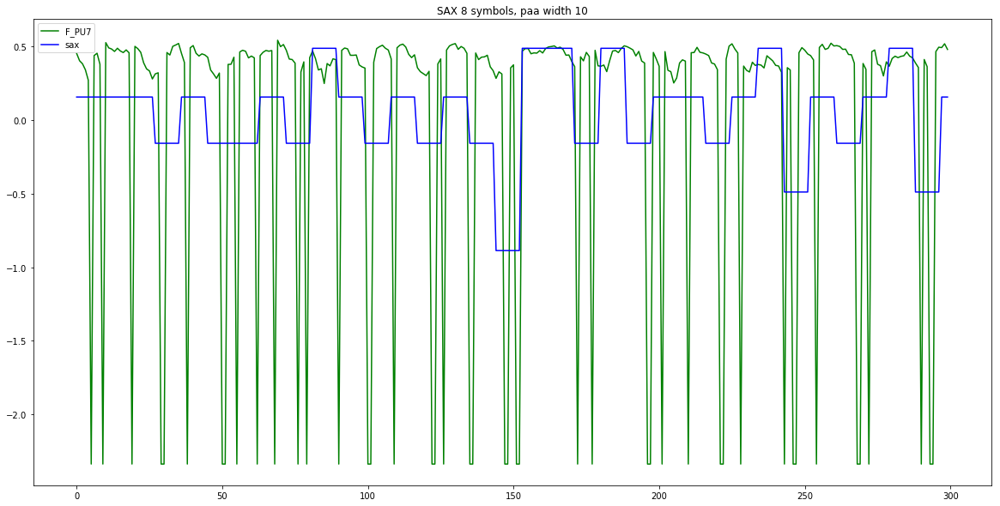

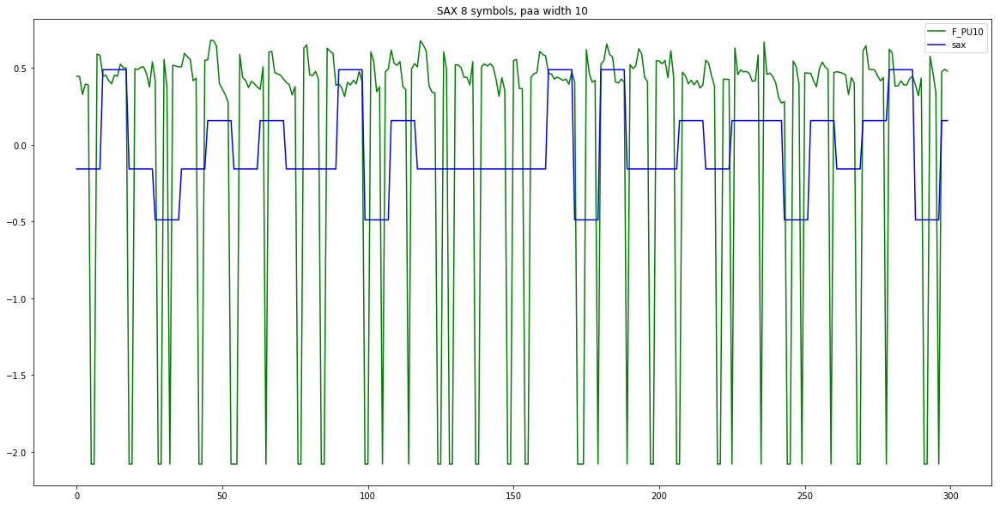

In [23]:
normalized_1_sax_LT1=discreteSignal(normalized_1,'L_T1',8,10)
saxplot(normalized_1,'L_T1',8,10,normalized_1_sax_LT1)
normalized_1_sax_LT7=discreteSignal(normalized_1,'L_T7',8,10)
saxplot(normalized_1,'L_T7',8,10,normalized_1_sax_LT7)
normalized_1_sax_F_PU1=discreteSignal(normalized_1,'F_PU1',8,10)
saxplot(normalized_1,'F_PU1',8,10,normalized_1_sax_F_PU1)
normalized_1_sax_F_PU7=discreteSignal(normalized_1,'F_PU7',8,10)
saxplot(normalized_1,'F_PU7',8,10,normalized_1_sax_F_PU7)
normalized_1_sax_F_PU10=discreteSignal(normalized_1,'F_PU10',8,10)
saxplot(normalized_1,'F_PU10',8,10,normalized_1_sax_F_PU10)

## 2.Apply KNN to sliding window
I use distance-based KNN to predict anomaly<br/>
~~Anomaly if distance to nearest neighbour n compared to distance from n to nearest neighbour is above threshold~~ : This will not work properly as it's quite common for neighbours have 0 distance in sax signal<br/>
So instead, I use 'Anomaly if distance from other points is above threshold'

In [24]:
def predictSaxThreshold(signal,name,n_sax,paa_width,k,windowWidth):
    attacks=signal['ATT_FLAG']
    attackindex=attacks.index[attacks == 1].tolist()
    #discretize signal
    signal=discreteSignal(signal,name,n_sax,paa_width)
    attacks=attacks.tolist()
    minimum=10
    maximum=0
    #range of threshold
    for i in attackindex:
        if i>=windowWidth:
            left=i-windowWidth
        else:
            left=0
        tmp=signal[left:i]
        tmp=list(map(lambda x:abs(x-signal[i]),tmp))
        if maximum<max(tmp):
            maximum=max(tmp)
        if minimum>min(tmp):
            minimum=min(tmp)
    #train threshold
    history=signal[0:windowWidth]
    best=math.inf
    for i in np.arange(minimum,maximum,0.01):
        predictedAttacks=attacks[0:windowWidth]
        for j in range(windowWidth,len(signal)):
            distance=knnDistance(k,history,windowWidth,signal[j])
            if distance>i:
                predictedAttacks.append(1)
            else:
                predictedAttacks.append(0)
            history.append(signal[j])
        fp=0
        for t in range(len(attacks)):
            if attacks[t]==0 and predictedAttacks[t]==1:
                fp+=1
        if fp<best:    
            best=fp
            threshold=i
            bestPredictAttacks=predictedAttacks     
    plt.figure(figsize=(20,10))
    plt.plot(signal,label='original',color='green',alpha=0.4)
    plt.plot(attacks,label='original',color='red',alpha=0.4)
    plt.plot(bestPredictAttacks,label='predicted',color='blue')
    plt.legend()
    plt.show()
    return threshold
            
def predictSignal(signal,name,n_sax,paa_width,k,windowWidth,threshold):
    signal=signal[name]
#     signal=discreteSignal(signal,name,n_sax,paa_width)
    history=signal[0:windowWidth]
    predictedAttacks=[]
    for i in range(windowWidth,len(signal)):
        nextPoint=signal[i]
        distance=knnDistance(k,history,windowWidth,nextPoint)
        if distance>threshold:
            predictedAttacks.append(1)
        else:
            predictedAttacks.append(0)
    plt.figure(figsize=(20,10))
    plt.plot(signal,label='original',color='green')
#     plt.plot(signal,label='original_sax',color='red')
    plt.plot(predictedAttacks,label='predicted',color='blue')
    plt.legend()
    plt.show()
    
def knnDistance(k,previousSeries:list,windowWidth,nextPoint):
    pointsInWindow=previousSeries[-windowWidth:]
    distance=list(map(lambda x: abs(x-nextPoint), pointsInWindow))
    distance.sort()
    return sum(distance[0:k])/k

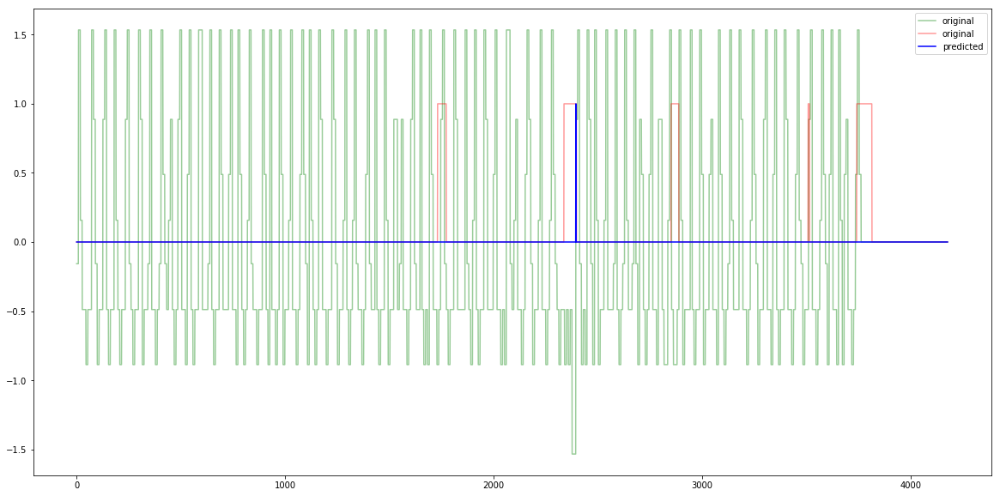

2.35


In [25]:
threshold=predictSaxThreshold(normalized_2,'F_PU1',8,10,5,10)
print(threshold)

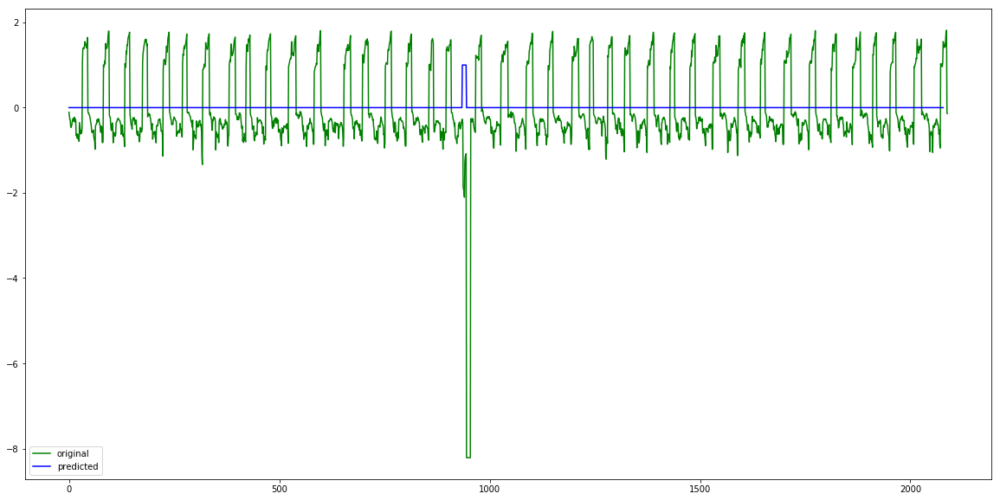

In [26]:
predictSignal(normalized_t,'F_PU1',8,10,5,10,threshold)

# PCA

In [27]:
from sklearn.decomposition import PCA
pca=PCA()
pca_normlized_1=normalized_1.drop(columns={'ATT_FLAG','DATETIME'})
pca_normlized_2=normalized_2.drop(columns={'ATT_FLAG','DATETIME'})
pca_normlized_t=normalized_t.drop(columns={'DATETIME'})
pca.fit(pca_normlized_1)

PCA(copy=True, iterated_power='auto', n_components=None, random_state=None,
  svd_solver='auto', tol=0.0, whiten=False)

https://stackoverflow.com/questions/22126717/extracting-pca-components-with-sklearn

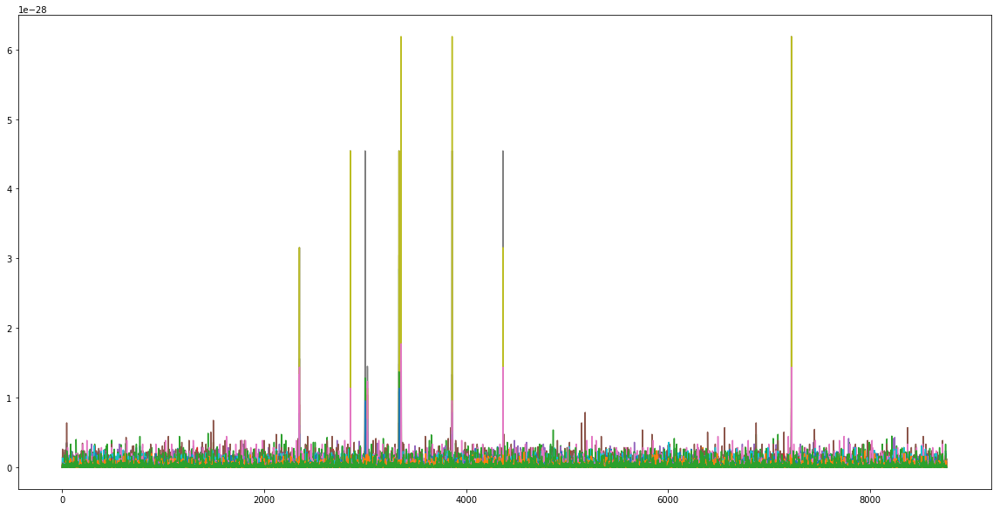

In [28]:
#Get the components from transforming the original data.
scores = pca.transform(pca_normlized_1)
# Reconstruct from the 2 dimensional scores 
reconstruct = pca.inverse_transform(scores )
#The residual is the amount not explained by the first two components
residual=pow(pca_normlized_1-reconstruct,2)
plt.figure(figsize=(20,10))
plt.plot(residual)

PCA is vulnearable to outliers, so I exclude 1% of all data points that are far from the mean of the series

mean is 7.48018944908681e-29
varivance is 8.488505487642939e-29
previous length is 8761
after remove, the length is 8674
threshold is 1.0999999999999999
index of removed samples are [45, 138, 206, 356, 491, 708, 770, 1256, 1298, 1445, 1497, 1594, 2001, 2120, 2348, 2349, 2350, 2674, 2733, 2774, 2818, 2854, 2855, 3000, 3001, 3009, 3023, 3024, 3080, 3222, 3297, 3336, 3337, 3356, 3357, 3358, 3597, 3824, 3848, 3849, 3861, 3862, 4066, 4070, 4110, 4118, 4186, 4365, 4366, 4383, 4576, 4837, 4905, 5025, 5145, 5180, 5667, 5746, 5889, 6008, 6018, 6086, 6345, 6399, 6468, 6681, 6736, 6873, 6874, 7089, 7148, 7211, 7222, 7223, 7451, 7566, 7734, 7793, 7857, 7909, 7994, 8336, 8373, 8462, 8528, 8713, 8720]


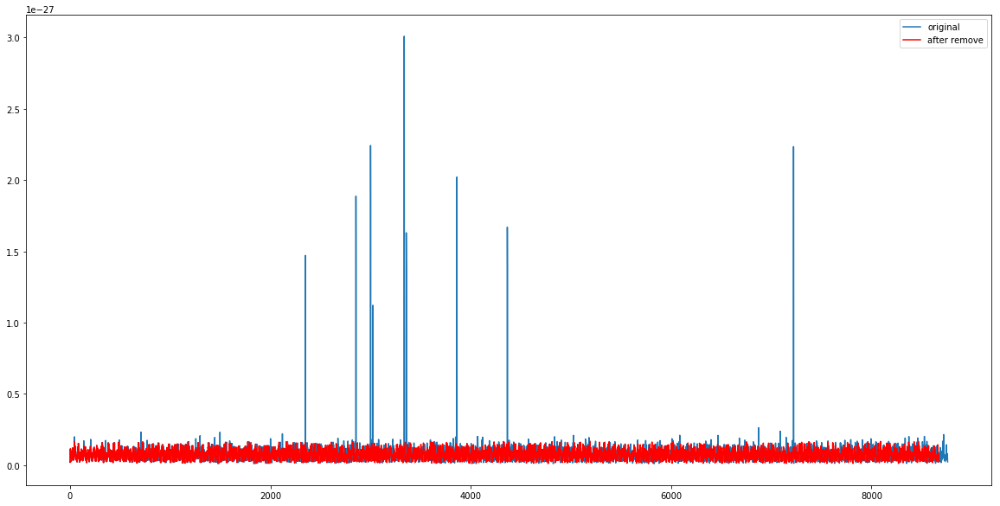

In [29]:
#total residual
total_residual=[]
for i in range(len(residual)):
    total_residual.append(np.sum(residual.loc[i,:]))
plt.figure(figsize=(20,10))
plt.plot(total_residual,label='original')
#remove abnormal points
mean=np.mean(total_residual)
variance=np.std(total_residual)
print(f'mean is {mean}')
print(f'varivance is {variance}')
removeIndex=[]
print(f'previous length is {len(total_residual)}')
threshold=0
ratio=0
res=None
while ratio<0.99:
    i=0
    threshold+=0.1
    res=total_residual.copy()
    length=len(res)
    while i != length:
        if abs(res[i]-mean)>threshold*variance:
            del res[i]
            length-=1
        else:
            i+=1
    ratio=len(res)/len(total_residual)

print(f'after remove, the length is {len(res)}')
print(f'threshold is {threshold}')

i=j=0
length=len(total_residual)
index=[]
while i != length:
    if abs(total_residual[i]-mean)>threshold*variance:
            del total_residual[i]
            index.append(j)
            length-=1
    else:
            i+=1
    j+=1
plt.plot(total_residual,label='after remove',color='red')
plt.legend()

print(f'index of removed samples are {index}')

In [30]:
#remove abnormal data
cleanedData=pca_normlized_1.drop(pca_normlized_1.index[index])
print(f'after remove length is {len(cleanedData)}')
#refit pca
pca.fit(cleanedData)
scores = pca.transform(cleanedData)
reconstruct = pca.inverse_transform(scores )
refit_residual=cleanedData-reconstruct
vr=pca.explained_variance_ratio_
for i in range(len(vr)):
    print(f'Percentage of variance explained by feature{i} is: {vr[i]}')
#decide how many  components to keep
sum=0
numberComponent=0
for i in vr:
    if sum<0.99:
        sum+=i
        numberComponent+=1
    else:
        break
print(f'number of principle component is {numberComponent}')

after remove length is 8674
Percentage of variance explained by feature0 is: 0.24306589445128973
Percentage of variance explained by feature1 is: 0.15084670969903832
Percentage of variance explained by feature2 is: 0.14345540098483672
Percentage of variance explained by feature3 is: 0.1109310479702998
Percentage of variance explained by feature4 is: 0.08085195374423429
Percentage of variance explained by feature5 is: 0.07505767282045861
Percentage of variance explained by feature6 is: 0.047910909544363556
Percentage of variance explained by feature7 is: 0.03702239647019547
Percentage of variance explained by feature8 is: 0.029149710387246758
Percentage of variance explained by feature9 is: 0.02796767154698472
Percentage of variance explained by feature10 is: 0.021073538530196327
Percentage of variance explained by feature11 is: 0.01710738491460927
Percentage of variance explained by feature12 is: 0.008305087935363968
Percentage of variance explained by feature13 is: 0.00328823879611014

0.00909090909090909
threshold is 104.73971365545644


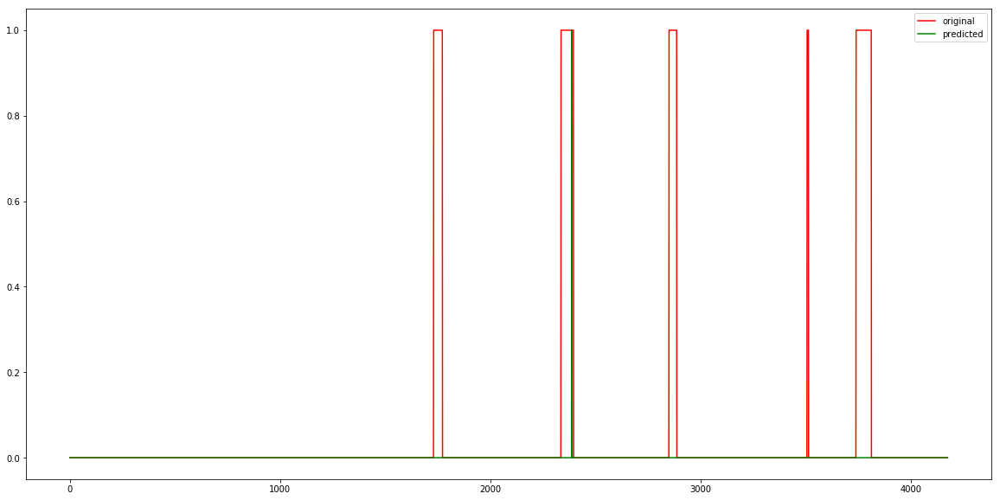

In [31]:
#use training data 2 to calculate a proper threshold
attacks=normalized_2['ATT_FLAG'].tolist()
# attackindex=attacks.index[attacks == 1].tolist()
pca = PCA(n_components=numberComponent)
pca.fit(pca_normlized_2)
scores = pca.transform(pca_normlized_2)
reconstruct = pca.inverse_transform(scores )
residual=np.sum(pow(pca_normlized_2-reconstruct,2),axis=1).tolist()
threshold=0
#range of threshold
maximum=max(residual)
minimum=min(residual)
predictedAttack=[]
for i in np.arange(minimum,maximum,0.01):
    predicted=[]
    tp=0
    fn=0
    fp=0
    for j in range(len(residual)):
        if residual[j]>i:
            predicted.append(1)
        else:
            predicted.append(0)
    best=0
    for k in range(len(residual)):
        if predicted[k]==1 and attacks[k]==1:
            tp+=1
        if predicted[k]==1 and attacks[k]==0:
            fn+=1
        if predicted[k]==0 and attacks[k]==1:
            fp+=1
    if tp>0:
        precision=tp/(tp+fp)
        recall=tp/(tp+fn)
        f1=2*(precision*recall)/(recall+precision)
    if f1>best:
        best=f1
        threshold=i
        predictedAttack=predicted     

print(best)
print(f'threshold is {threshold}')
plt.figure(figsize=(20,10))
plt.plot(attacks,label='original',color='red')
plt.plot(predictedAttack,label='predicted',color='green')
plt.legend()
plt.show()

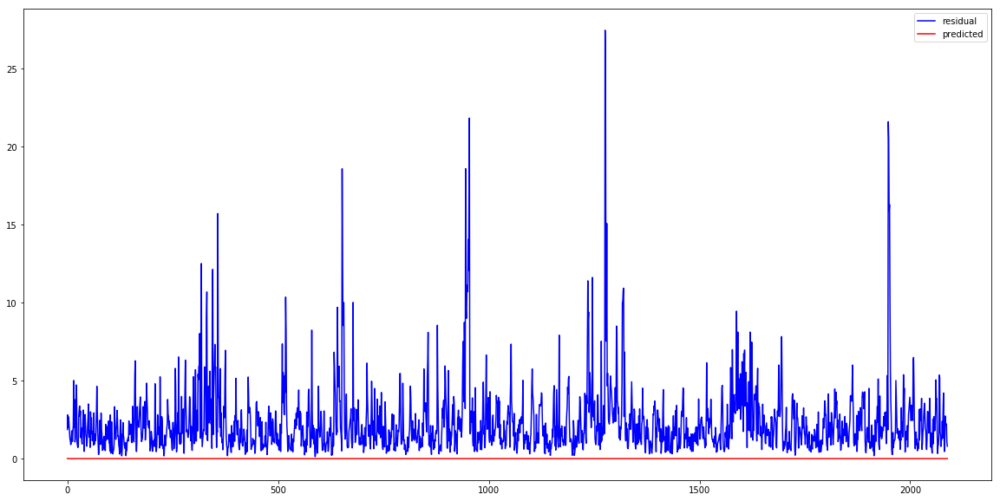

In [32]:
#predict on test data
# attackindex=attacks.index[attacks == 1].tolist()
pca = PCA(n_components=numberComponent)
pca.fit(pca_normlized_t)
scores = pca.transform(pca_normlized_t)
reconstruct = pca.inverse_transform(scores )
residual=np.sum(pow(pca_normlized_t-reconstruct,2),axis=1).tolist()
prediction=[]
for i in range(len(pca_normlized_t)):
    if residual[i]>threshold:
        prediction.append(1)
    else:
        prediction.append(0)
plt.figure(figsize=(20,10))
plt.plot(residual,label='residual',color='blue')
plt.plot(prediction,label='predicted',color='red')
plt.legend()
plt.show()